<a href="https://colab.research.google.com/github/santihm/OutlierDetection-Clustering-UnsupervisedLearning/blob/main/P2_SantiagoHerronMulet.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# Aprendizaje Automático - Práctica 2 - Experimentación con agrupamiento y detección de anomalías  no supervisada

#### Valoración máxima: 10 puntos

#### Fecha límite de entrega: 19 de Mayo de 2024 a las 23:59

#### Entrega a través de https://pradogrado2324.ugr.es/

### Nombre completo: <mark>SANTIAGO HERRON MULET</mark>



---


**Normas de desarrollo y entrega de trabajos**

- Única y exclusivamente se debe entregar este Notebook de Colab (fichero `.ipynb`) o, en su defecto, tres Notebooks de Colab (uno con cada ejercicio). No es necesario entregar ninguna memoria externa (por ejemplo, en `.pdf`).

- El código debe estar bien comentado (explicando lo que realizan los distintos apartados y/o bloques), y todas las decisiones tomadas y el trabajo desarrollado (incluyendo los conceptos fundamentales subyacentes) deben documentarse ampliamente en celdas de texto. Es obligatorio documentar las valoraciones y decisiones adoptadas en el desarrollo de cada uno de los apartados. Debe incluirse también tanto una descripción de las principales funciones (Python/scikit-learn) empleadas (para mostrar que el alumno comprende, a nivel técnico, lo que está haciendo), como una valoración razonada sobre la calidad de los resultados obtenidos. Sin esta documentación, se considera que el trabajo NO ha sido presentado.

- La entrega en PRADO está configurada para permitir sucesivas entregas de la práctica. Desde este punto de vista, se recomienda subir versiones de la práctica a medida que se van realizando los distintos ejercicios propuestos, y no dejarlo todo para el final.  

- Se debe respetar la estructura y secciones del Notebook. Esto servirá para agilizar las correcciones, así como para identificar con facilidad qué ejercicio/apartado se está respondiendo.

- El código NO puede escribir nada a disco.

- El path de lectura desde Google Drive debe ser siempre el mismo, que es el que se indica en este Notebook.

- Una entrega es apta para ser corregida si se puede ejecutar de principio a fin sin errores. Es decir, un ejercicio con errores de ejecución tendrá una calificación de 0.

- No es válido usar opciones en las entradas (es decir, utilizar el comando `input()`, por ejemplo, para que el usuario escoja el valor de las variables para ejecutar el programa). Para ello, se deben fijar al comienzo los valores por defecto que se consideren óptimos o que se soliciten en el enunciado.

- Se entrega solamente este Notebook, y no los datos empleados.


---

## <font color='blue'>Ejercicio 1: OPTIMIZANDO k-MEANS y DBSCAN (4 puntos)</font>

<font color='blue'>La optimización de algoritmos de clustering como k-Means y DBSCAN en aprendizaje automático es fundamental para abordar aplicaciones reales debido a varias razones críticas. Primero, estas técnicas son ampliamente aplicadas en la segmentación de clientes, detección de anomalías, sistemas de recomendación, y otras áreas donde la agrupación efectiva de datos es crucial para extraer _insights_ significativos y tomar decisiones informadas. Optimizar estos algoritmos permite manejar grandes volúmenes de datos de manera eficiente, mejorando la velocidad y reduciendo los costos computacionales, lo cual es esencial en entornos donde el tiempo y los recursos son limitados. Además, al afinar estos métodos para incrementar su precisión y sensibilidad, se pueden identificar patrones y tendencias con mayor exactitud, lo que resulta en modelos más robustos y confiables. En un mundo donde los datos crecen exponencialmente, la capacidad de procesar y analizar esta información de manera efectiva es clave para el éxito en diversas aplicaciones prácticas, haciendo de la optimización y uso (incluso como parte de estrategias complejas de entrenamiento) de algoritmos de _clustering_ un componente indispensable en el campo del _machine learning_.

<font color='blue'>En este ejercicio intentaremos profundizar un poco en cómo optimizar y operar con dos algoritmos de clustering básicos (k-Means y DBSCAN).



---




<font color='blue'>Primero, importamos las librerías necesarias y fijamos la semilla aleatoria para que nuestros resultados sean reproducibles entre ejecuciones.


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import sklearn

# Fijamos la semilla aleatoria
np.random.seed(42) #¿Por qué 42? https://en.wikipedia.org/wiki/Phrases_from_The_Hitchhiker%27s_Guide_to_the_Galaxy

# Cambiamos aspecto de los gráficos
plt.rc('font', size=14)
plt.rc('axes', labelsize=14, titlesize=14)
plt.rc('legend', fontsize=14)
plt.rc('xtick', labelsize=10)
plt.rc('ytick', labelsize=10)





---






### <font color='blue'>Ejercicio 1.A: Optimizando k-Means (3 puntos)</font>

<font color='blue'> Vamos a entrenar un agrupador K-Means en un conjunto de datos sintético en 2D, y vamos a intentar encontrar el centro de cada mancha y asignar cada instancia a la mancha/agrupación más cercana. Las tareas concretas a realizar en este ejercicio se resumen a continuación:
1.   Completamos el código con el ajuste de un `KMeans` usando 5 clusters y el hiperparámetro `n_init` con un valor igual a 1. Este hiperparámetro nos dice el número de veces que se ejecuta el algoritmo k-means con diferentes semillas de centroide (inicializaciones aleatorias). El resultado final es el mejor resultado de `n_init` ejecuciones consecutivas en términos de inercia. En general, suele ser recomendable emplear varias ejecuciones (especialmente, en problemas con alta dimensionalidad).
2.   Cada instancia se asignará a uno de los cinco clusters. En el contexto del clustering, la etiqueta de una instancia es el índice del cluster al que el algoritmo asigna esta instancia; esto no debe confundirse con las etiquetas de clase en clasificación, que se utilizan como objetivos. La instancia `KMeans` conserva las etiquetas predichas de las instancias con las que se entrenó, disponibles a través de la variable de instancia `labels_`. Imprimimos los centros de los 5 clusters y dibujamos los bordes de decisión de los 5 clusters obtenidos.
3. Predecimos cuatro nuevas instancias con valores `[[0, 2], [3, 2], [-3, 3], [-3, 2.5]]` utilizando el enfoque de clustering duro (`predict`) y clustering flexible (`transform`). En el primer caso, se proporciona uno de los clusters como aquel al que pertenece la instancia bajo estudio (es decir, cada instancia se asume que pertenece a un único cluster). En el segundo, se recupera un valor de pertenencia difuso/parcial de la instancia a cada uno de los clusters (es decir, cada instancia tiene un cierto grado de pertenencia a cada uno de los clusters).
4. A continuación, vamos a ver de qué forma influye la inicialización de los centroides en el resultado final. Vamos a escoger, de forma aproximada, dónde se pueden poner los 5 centroides para comenzar a iterar con un k-means. Para ello se puede lanzar `KMeans` con el hiperparámetro `n_init=1` y el hiperparámetro `init` con un `np.array` de 5 puntos en 2D escogidos manualmente por el estudiante. Prueba qué ocurre en este caso, imprimiendo los centros y dibujando los bordes de decisión de los 5 clusters obtenidos.
5. En la mayoría de casos reales y de interés, no es viable saber dónde están los centroides, pues los datos son más complejos. Para estos casos, el hiperpárametro `n_init` tiene un valor por defecto de 10; lo que significa que todo el algoritmo se ejecuta 10 veces cuando se llama a `fit()`, y Scikit-Learn se queda con la mejor solución. Pero, ¿cómo sabe exactamente qué solución es la mejor? Utiliza una métrica de rendimiento. Esa métrica se llama inercia del modelo, que es la suma de las distancias al cuadrado entre las instancias y sus centroides más cercanos. La clase `KMeans` ejecuta el algoritmo `n_init` veces y se queda con el modelo con la inercia más baja. La inercia de un modelo es accesible a través de la variable de instancia `inertia_`. El método `score()` devuelve la inercia negativa. ¿Por qué crees que devuelve el valor negativo? Imprime los valores `inertia_` y `score()` obtenidos en el apartado anterior.
6. Prueba diferentes métodos de inicialización (hiperparámetro `init`) y diferentes variantes de k-Medias con el hiperparámetro `algorithm`. Describe cada método de inicialización y compara gráficamente el resultado. ¿Notas diferencias significativas en las figuras representadas? ¿Por qué?
7. Vamos a encontrar el número óptimo de clusters utilizando el silhouette score, que lo podéis encontrar en `sklearn.metrics` importando `silhouette_score`.  Vamos a visualizar  este score para diferente número de clusters, desde 2 hasta 15  (ambos inclusive): eje X (número de clusters) vs eje Y (silhouette score).  Aquí utilizaremos el valor `n_init=10`. Analiza los resultados obtenidos.
8. Se puede obtener una visualización aún más informativa si representamos el coeficiente
de silueta de cada instancia, ordenado por los clusters a los que está asignada y
por el valor del coeficiente. Esto se denomina diagrama de siluetas
(véase https://scikit-learn.org/stable/auto_examples/cluster/plot_kmeans_silhouette_analysis.html).
Cada diagrama contiene una forma de cuchillo por cluster. La altura de la forma indica el número
de instancias en el cluster, y su anchura representa los coeficientes de silueta
ordenados de las instancias en el cluster (más ancho es mejor). Dibuja los
coeficientes de silueta para un $k=\{3,4,5,6\}$ y analiza los resultados obtenidos.
9. El conjunto de datos clásico de Olivetti contiene 400 imágenes de rostros en escala
de grises de 64×64 píxeles. Cada imagen se aplana a un vector 1D de tamaño 4.096.
Se fotografiaron 40 personas diferentes (10 veces cada una), y la tarea habitual es
entrenar un modelo que pueda predecir qué persona está representada en cada imagen.
Carga el conjunto de datos utilizando la función `sklearn.datasets.fetch_olivetti_faces()`
y, a continuación, divídelo en un conjunto de entrenamiento y
unode test (ten en cuenta que el conjunto de datos ya está escalado entre 0 y 1).
Dado que el conjunto de datos es bastante pequeño, probablemente necesitaremos utilizar un muestreo
estratificado (`StratifiedShuffleSplit`) para asegurarnos de que hay el mismo número de imágenes por persona/clase/cluster en cada conjunto.
A continuación, agrupa las imágenes utilizando tres modelos de k-means (k-means++ con `n_init=10`,
random con `n_init=1`, y random con `n_init=10` y el algoritmo ` elkan` para agilizar cómputo), y
asegúrate de que empleamos un buen número de clústers (utilizando técnicas de los apartados anteriores).
Visualiza los clusters utilizando el mejor modelo (bajo tu criterio, que debes justificar) de los tres previos: ¿ves caras
similares en cada cluster? Es decir, ¿hemos sido capaces de agrupar rostros de las mismas personas de forma no supervisada? ¿Cómo de buenas son las predicciones realizadas con el conjunto de test: se corresponden adecuadamente con las identidades de entrenamiento?
¿Qué conclusiones extraes en base al trabajo realizado y los resultados obtenidos?
NOTA: Puedes utilizar reducción de dimensionalidad para agilizar el cómputo.

<font color='blue'> El alumnado debe describir en detalle el trabajo realizado y las conclusiones extraídas.

In [ ]:
import numpy as np
from sklearn.cluster import KMeans
from sklearn.datasets import make_blobs

blobs_c = np.array([[ 0,  2.5], [-1.5 ,  2.3], [-2.8,  1.7],
                         [-2.6,  3.5], [-2.9,  1.4]])
blob_std = np.array([0.45, 0.25, 0.1, 0.1, 0.05])
X, y = make_blobs(n_samples=2000, centers=blobs_c, cluster_std=blob_std,
                  random_state=42)

<font color='blue'> Dibujamos las manchas.

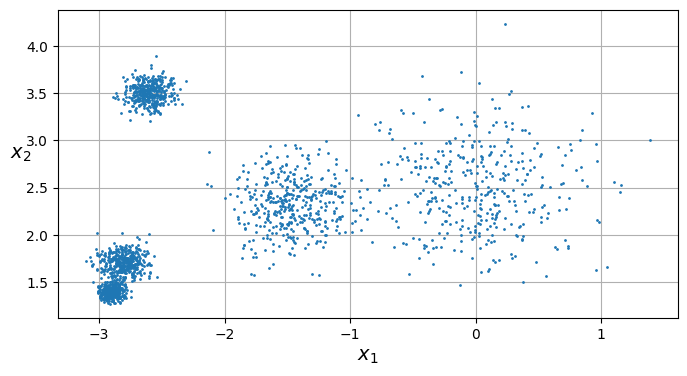

In [ ]:
import matplotlib.pyplot as plt
def plot_clusters(X, y=None):
    plt.scatter(X[:, 0], X[:, 1], c=y, s=1)
    plt.xlabel("$x_1$")
    plt.ylabel("$x_2$", rotation=0)

plt.figure(figsize=(8, 4))
plot_clusters(X)
plt.gca().set_axisbelow(True)
plt.grid()
plt.show()

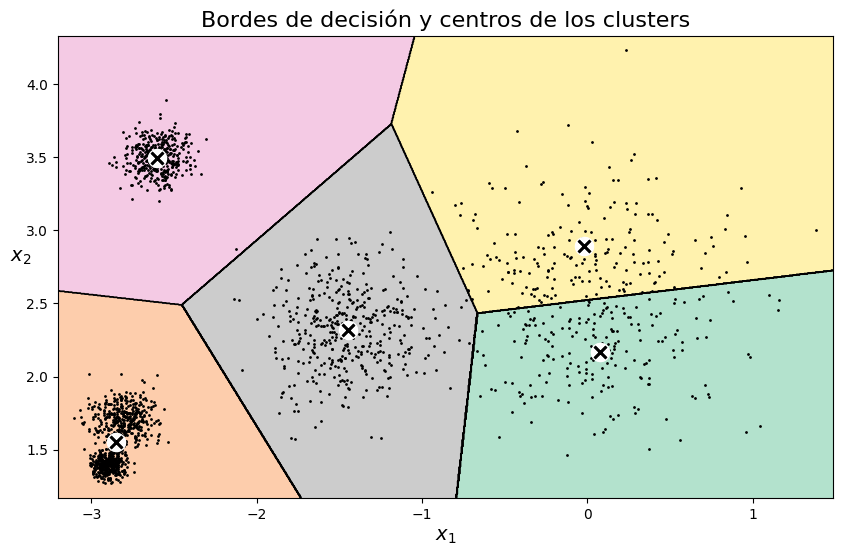

In [ ]:
from sklearn.cluster import KMeans

# Apartado 1
k = 5  # Número de clusters
n_init = 1  # Número de veces que se ejecuta el algoritmo con diferentes semillas de centroide
kmeans = KMeans(n_clusters=k, n_init=n_init, random_state=42)  # Creación del modelo KMeans
kmeans.fit(X)  # Ajuste del modelo a los datos de entrada



#Apartado 2
def plot_data(X):
    plt.plot(X[:, 0], X[:, 1], 'k.', markersize=2)

def plot_centroids(centroids, weights=None, circle_color='w', cross_color='k'):
    if weights is not None:
        centroids = centroids[weights > weights.max() / 10]
    plt.scatter(centroids[:, 0], centroids[:, 1],
                marker='o', s=35, linewidths=8,
                color=circle_color, zorder=10, alpha=0.9)
    plt.scatter(centroids[:, 0], centroids[:, 1],
                marker='x', s=2, linewidths=12,
                color=cross_color, zorder=11, alpha=1)

def plot_decision_boundaries(clusterer, X, resolution=1000, show_centroids=True,
                             show_xlabels=True, show_ylabels=True):
    mins = X.min(axis=0) - 0.1
    maxs = X.max(axis=0) + 0.1
    xx, yy = np.meshgrid(np.linspace(mins[0], maxs[0], resolution),
                         np.linspace(mins[1], maxs[1], resolution))
    Z = clusterer.predict(np.c_[xx.ravel(), yy.ravel()])
    Z = Z.reshape(xx.shape)

    plt.contourf(Z, extent=(mins[0], maxs[0], mins[1], maxs[1]),
                cmap="Pastel2")
    plt.contour(Z, extent=(mins[0], maxs[0], mins[1], maxs[1]),
                linewidths=1, colors='k')
    plot_data(X)
    if show_centroids:
        plot_centroids(clusterer.cluster_centers_)

    if show_xlabels:
        plt.xlabel("$x_1$")
    else:
        plt.tick_params(labelbottom=False)
    if show_ylabels:
        plt.ylabel("$x_2$", rotation=0)
    else:
        plt.tick_params(labelleft=False)

plt.figure(figsize=(10, 6))

# Asignación de instancias a clusters
plot_decision_boundaries(kmeans, X)

# Visualización de los centros de los clusters
plot_centroids(kmeans.cluster_centers_)

# Configuración de etiquetas y título
plt.xlabel("$x_1$", fontsize=14)
plt.ylabel("$x_2$", fontsize=14, rotation=0)
plt.title("Bordes de decisión y centros de los clusters", fontsize=16)

plt.show()

Hemos utilizado el algoritmo KMeans para dividir nuestro conjunto de datos en 5 clusters. Los centros de los clusters se calcularon y visualizaron, mostrando una clara segmentación del espacio de datos. Los bordes de decisión indican una separación aceptable de los datos aunque mejorable. Por ejemplo, a simple vista, parece ser que en el cluster de abajo a la izquierda se podrían distinguir dos agrupaciones deiferentes y tambien en los 2 clusters de la derecha se podría argumentar que no parece haber suficiente densidad para considerarlos agrupamientos. En aplicaciones prácticas, se recomienda aumentar n_init para mejorar la estabilidad.

In [ ]:
import numpy as np
from sklearn.cluster import KMeans

# Datos de ejemplo
X = np.array([[1, 2], [1, 4], [1, 0],
              [10, 2], [10, 4], [10, 0]])

# Ajustar el modelo KMeans
k = 3  # Número de clusters
n_init = 1  # Número de veces que se ejecuta el algoritmo con diferentes semillas de centroide
kmeans = KMeans(n_clusters=k, n_init=n_init, random_state=42)  # Creación del modelo KMeans
kmeans.fit(X)  # Ajuste del modelo a los datos de entrada

# Apartado 3
X_new = np.array([[0, 2], [3, 2], [-3, 3], [-3, 2.5]])

# Clustering Duro (Predict)
labels_hard = kmeans.predict(X_new)

# Clustering Flexible (Transform)
labels_flexible = kmeans.transform(X_new)

# Normalizar las distancias para obtener grados de pertenencia
labels_flexible_normalized = labels_flexible / labels_flexible.sum(axis=1)[:, np.newaxis]

# Imprimir los resultados
print("Clustering Duro (Predicciones):", labels_hard)
print("Clustering Flexible (Grados de Pertenencia Normalizados):")
print(labels_flexible_normalized)


Clustering Duro (Predicciones): [1 1 2 1]
Clustering Flexible (Grados de Pertenencia Normalizados):
[[0.73258562 0.10360325 0.16381113]
 [0.58021491 0.18534286 0.23444223]
 [0.60269104 0.20672132 0.19058764]
 [0.60359302 0.19820349 0.19820349]]


El código utiliza el algoritmo KMeans para agrupar datos en clusters. En el enfoque de clustering duro, cada instancia se asigna a un único cluster, lo que se refleja en las predicciones donde cada número representa el cluster al que se asigna cada instancia. Por otro lado, en el clustering flexible, se obtienen grados de pertenencia normalizados, lo que indica el grado de similitud de cada instancia con respecto a cada cluster. Por ejemplo, en las nuevas instancias, el primer enfoque asigna la primera instancia al cluster 1, mientras que el segundo enfoque muestra que esta instancia tiene un grado de pertenencia de aproximadamente 73% al cluster 1, 10% al cluster 2 y 16% al cluster 3. Esto proporciona una visión más detallada de cómo las instancias se relacionan con cada cluster, lo que puede ser útil en ciertas aplicaciones donde la asignación exacta a un solo cluster puede ser insuficiente.

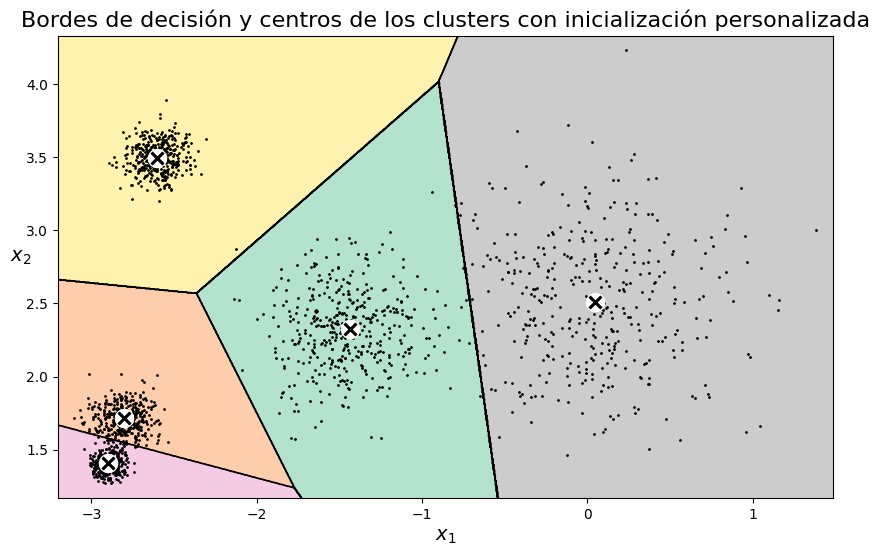

In [ ]:
# Apartado 4
good_init = np.array([[0, 2], [2, 0], [-2, -1], [-1, 3], [3, 3]])

kmeans_custom_init = KMeans(n_clusters=k, n_init=1, init=good_init, random_state=42)
kmeans_custom_init.fit(X)

plt.figure(figsize=(10, 6))
plot_decision_boundaries(kmeans_custom_init, X)
plot_centroids(kmeans_custom_init.cluster_centers_)
plt.xlabel("$x_1$", fontsize=14)
plt.ylabel("$x_2$", fontsize=14, rotation=0)
plt.title("Bordes de decisión y centros de los clusters con inicialización personalizada", fontsize=16)
plt.show()



La inicialización de los centroides en el algoritmo KMeans puede influir significativamente en el resultado final de la agrupación. En este caso, al utilizar una inicialización personalizada con puntos seleccionados manualmente, se observa una separación más clara y satisfactoria de los clusters en comparación con la inicialización anterior. Los bordes de decisión se ajustan mejor a la distribución de los datos, lo que indica una agrupación más precisa. Esto demuestra la importancia de una buena inicialización de los centroides en el rendimiento del algoritmo KMeans y su capacidad para encontrar patrones significativos en los datos.

In [ ]:
# Apartado 5
inertia_custom_init = kmeans_custom_init.inertia_
score_custom_init = kmeans_custom_init.score(X)

print("Inercia del modelo con inicialización personalizada:", inertia_custom_init)
print("Puntuación del modelo con inicialización personalizada:", score_custom_init)


Inercia del modelo con inicialización personalizada: 212.0707521328111
Puntuación del modelo con inicialización personalizada: -212.07075213281107


La métrica de inercia del modelo en KMeans se define como la suma de las distancias al cuadrado entre las instancias y sus centroides más cercanos. Cuando se llama al método score(), se devuelve la inercia negativa. Esto se debe a que la convención en Scikit-Learn es maximizar las métricas de rendimiento, mientras que en el caso de la inercia, queremos minimizar su valor. Por lo tanto, al devolver la inercia como negativa, se sigue esta convención de maximización. En el caso de la inicialización personalizada, la inercia del modelo es de aproximadamente 212.07, lo que indica la calidad del agrupamiento logrado. La puntuación negativa refleja la inercia, pero invertida en el signo.

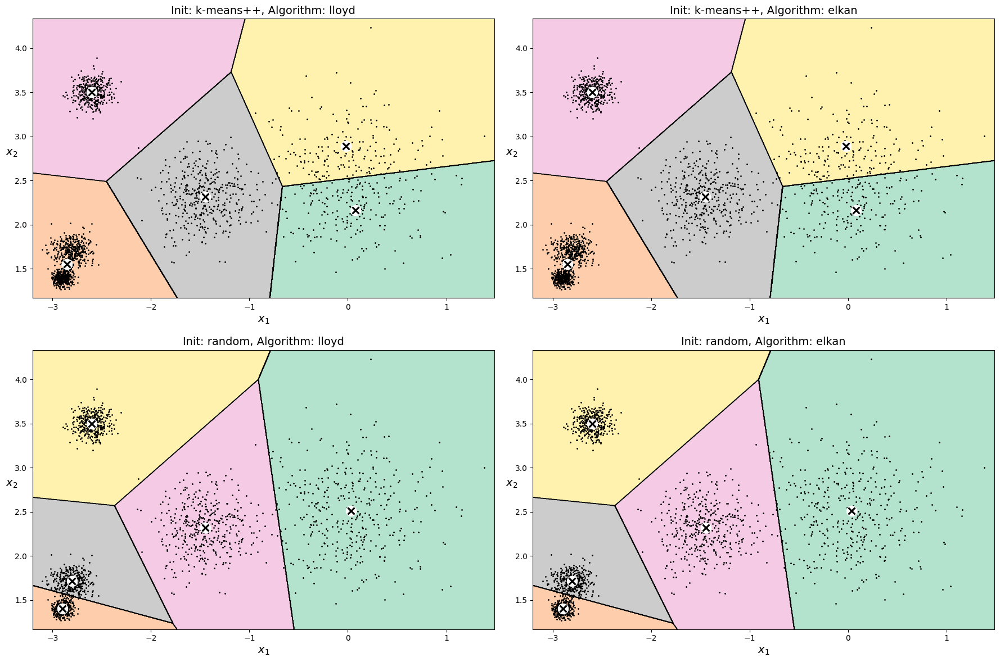

In [ ]:
#Apartado 6
# Lista de posibles valores para init_method y algorithm_method
init_methods = ["k-means++", "random"]
algorithm_methods = ["lloyd", "elkan"]

plt.figure(figsize=(18, 12))

for i, init_method in enumerate(init_methods):
    for j, algorithm_method in enumerate(algorithm_methods):
        kmeans = KMeans(n_clusters=5, n_init=1, init=init_method, algorithm=algorithm_method, random_state=42)
        kmeans.fit(X)

        plt.subplot(len(init_methods), len(algorithm_methods), i * len(algorithm_methods) + j + 1)
        plot_decision_boundaries(kmeans, X)
        plot_centroids(kmeans.cluster_centers_)
        plt.title(f"Init: {init_method}, Algorithm: {algorithm_method}")

plt.tight_layout()
plt.show()



En el apartado 6, se exploran diferentes métodos de inicialización (k-means++ y aleatorio) y variantes del algoritmo k-Medias (Lloyd y Elkan). Cada combinación de métodos produce resultados de agrupación distintos, como se muestra en las figuras representadas. Notamos que las separaciones en clusters difieren significativamente entre los métodos de inicialización. Específicamente, el método de inicialización aleatorio parece producir agrupaciones más adecuadas en comparación con k-means++. Esto puede ser atribuido a la aleatoriedad en la selección de los centroides iniciales, lo que ayuda al algoritmo a escapar de mínimos locales y encontrar una solución más óptima. En general, la elección del método de inicialización y la variante del algoritmo pueden tener un impacto significativo en la calidad de la agrupación final, especialmente en conjuntos de datos complicados.








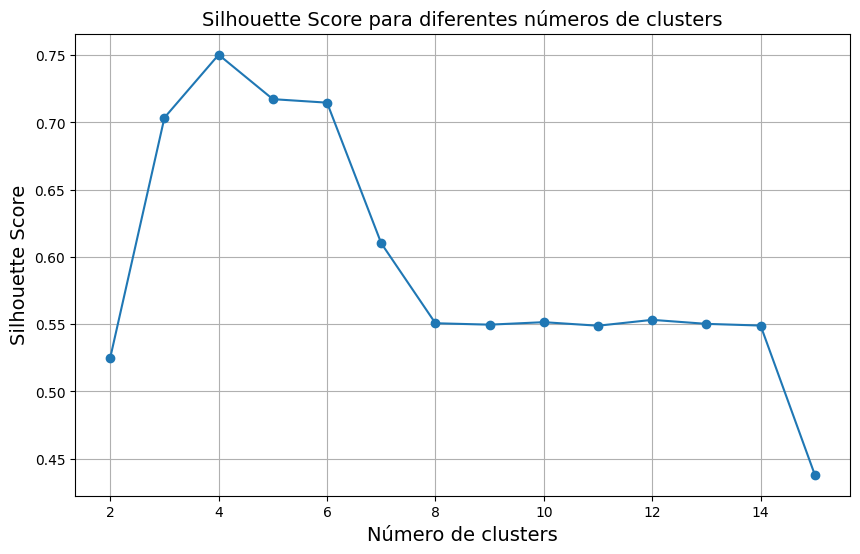

In [ ]:
# Apartado 7
from sklearn.metrics import silhouette_score

silhouette_scores = []

for n_clusters in range(2, 16):
    kmeans = KMeans(n_clusters=n_clusters, n_init=10, random_state=42)
    kmeans.fit(X)
    labels = kmeans.labels_
    silhouette_scores.append(silhouette_score(X, labels))

plt.figure(figsize=(10, 6))
plt.plot(range(2, 16), silhouette_scores, marker='o', linestyle='-')
plt.xlabel('Número de clusters')
plt.ylabel('Silhouette Score')
plt.title('Silhouette Score para diferentes números de clusters')
plt.grid(True)
plt.show()


En el apartado 7, se utiliza el coeficiente de silueta para encontrar el número óptimo de clusters en los datos. Se visualiza el silhouette score para diferentes números de clusters, desde 2 hasta 15. Observamos que el coeficiente de silueta alcanza valores aceptables para un número de clusters entre 3 y 6, lo que indica una buena separación y cohesión de los clusters. Sin embargo, se maximiza en 4 clusters con un valor de aproximadamente 0.75, lo que sugiere que esta podría ser la cantidad óptima de clusters para este conjunto de datos. Este análisis nos proporciona una guía sobre la estructura subyacente de los datos y nos ayuda a tomar decisiones informadas sobre el número adecuado de clusters a utilizar en el modelado.

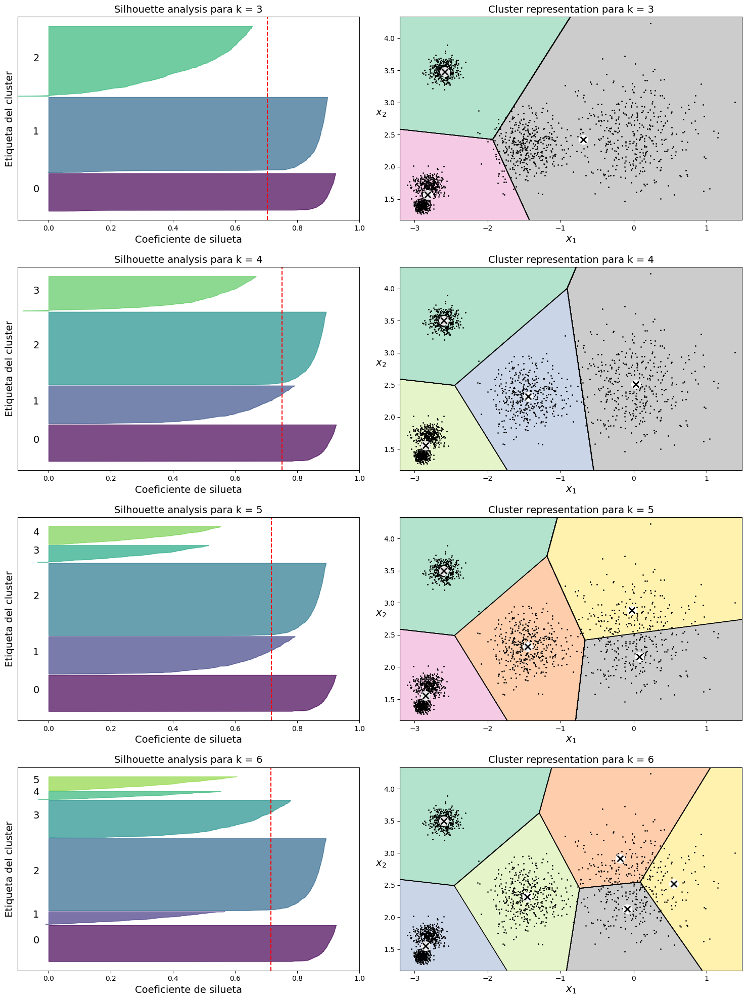

In [ ]:


# Apartado 8
from sklearn.metrics import silhouette_samples
from matplotlib.ticker import FixedLocator, FixedFormatter

# Valores de k para los que generaremos los diagramas de siluetas
k_values = [3, 4, 5, 6]

# Tamaño de la figura para los subplots
plt.figure(figsize=(15, 20))

# Iterar sobre cada valor de k
for i, k in enumerate(k_values):
    # Crear un subplot para el valor de k actual
    plt.subplot(len(k_values), 2, i * 2 + 1)

    # Crear un objeto de KMeans con el número de clusters actual
    kmeans = KMeans(n_clusters=k, n_init=10, random_state=42)
    cluster_labels = kmeans.fit_predict(X)

    # Calcular los coeficientes de silueta para cada instancia
    silhouette_coefficients = silhouette_samples(X, cluster_labels)

    # Ordenar los coeficientes de silueta y asignaciones de cluster
    sorted_indices = np.argsort(silhouette_coefficients)

    # Calcular el número total de instancias
    y_lower = 10

    # Iterar sobre cada cluster para generar el diagrama de siluetas
    for j, cluster in enumerate(np.unique(cluster_labels)):
        # Obtener los coeficientes de silueta para las instancias en este cluster
        cluster_silhouette_values = silhouette_coefficients[cluster_labels == cluster]
        cluster_silhouette_values.sort()

        # Calcular la altura del diagrama de siluetas para este cluster
        size_cluster_i = cluster_silhouette_values.shape[0]
        y_upper = y_lower + size_cluster_i

        # Rellenar el diagrama de siluetas
        color = plt.cm.viridis(float(j) / k)
        plt.fill_betweenx(np.arange(y_lower, y_upper), 0, cluster_silhouette_values,
                          facecolor=color, edgecolor=color, alpha=0.7)

        # Etiquetar el cluster en el eje y
        plt.text(-0.05, y_lower + 0.5 * size_cluster_i, str(cluster))

        # Calcular la nueva posición inferior para el próximo cluster
        y_lower = y_upper + 10

    # Configurar el título y los ejes del subplot
    plt.title(f"Silhouette analysis para k = {k}", fontsize=14)
    plt.xlabel("Coeficiente de silueta")
    plt.ylabel("Etiqueta del cluster")

    # Establecer límites para el coeficiente de silueta
    plt.xlim(-0.1, 1)

    # Añadir línea vertical en la media de los coeficientes de silueta
    plt.axvline(x=np.mean(silhouette_coefficients), color="red", linestyle="--")

    # Establecer ubicaciones fijas y etiquetas para el eje y
    plt.gca().yaxis.set_major_locator(FixedLocator([]))
    plt.gca().yaxis.set_major_formatter(FixedFormatter([]))

    # Crear un subplot para la representación del cluster con los centroides
    plt.subplot(len(k_values), 2, i * 2 + 2)

    # Dibujar los bordes de decisión y los centroides del cluster
    plot_decision_boundaries(kmeans, X)
    plt.title(f"Cluster representation para k = {k}", fontsize=14)

plt.tight_layout()
plt.show()




En el apartado 8 se utiliza el diagrama de siluetas para analizar los coeficientes de silueta de cada instancia, ordenados por los clusters a los que están asignados y por el valor del coeficiente. Se representan los coeficientes de silueta para k=3, 4, 5 y 6. Observamos que para k=4, tanto la gráfica como la visualización muestran una separación compacta y adecuada, con coeficientes de silueta significativos y clusters bien definidos. Sin embargo, para k=5 y 6, se observa la presencia de algunos clusters poco significativos que no contribuyen demasiado a la separación, lo que indica una posible redundancia en la cantidad de clusters. Esto sugiere que el número óptimo de clusters podría estar alrededor de 4, donde se observa una mejor separación y cohesión de los clusters. Este análisis nos proporciona una perspectiva más detallada sobre la estructura de los datos y nos ayuda a tomar decisiones informadas sobre el número adecuado de clusters a utilizar en el modelado.

Número óptimo de clusters: 99

Resumen de métricas para los modelos finales:
                    Modelo  Silhouette Train  Silhouette Test  \
0   KMeans++ con n_init=10          0.264169         0.109423   
1   Aleatorio con n_init=1          0.164025         0.071105   
2  Aleatorio con n_init=10          0.177992         0.099919   

   Homogeneidad Train  Homogeneidad Test  Completitud Train  Completitud Test  \
0            0.969940           0.949478           0.797103          0.882159   
1            0.905947           0.947705           0.753629          0.885837   
2            0.918919           0.944781           0.768342          0.893391   

   V-Measure Train  V-Measure Test  
0         0.875069        0.914582  
1         0.822798        0.915727  
2         0.836911        0.918368  


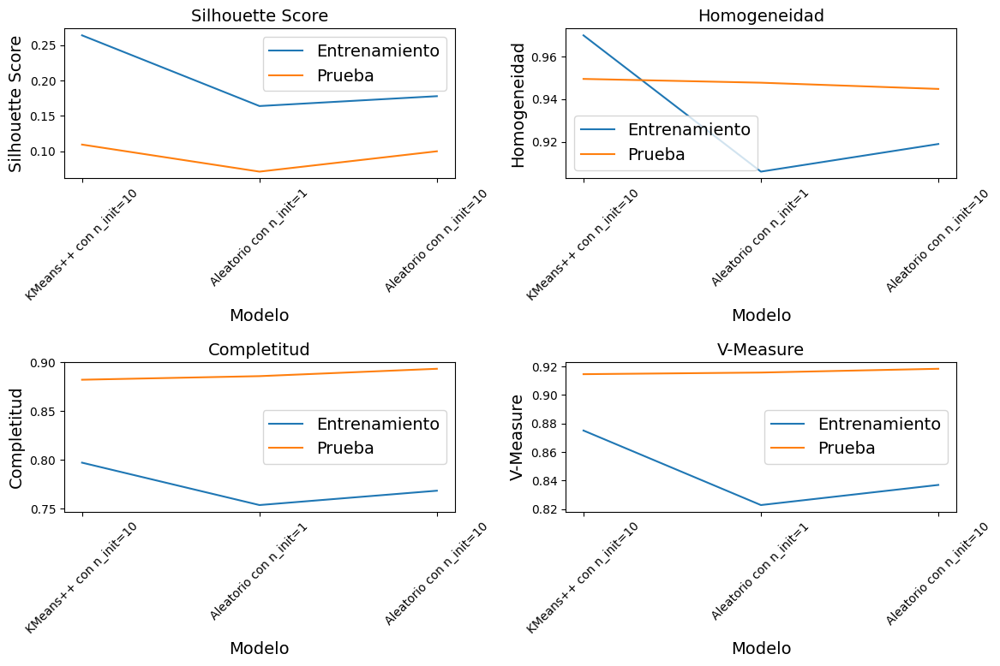

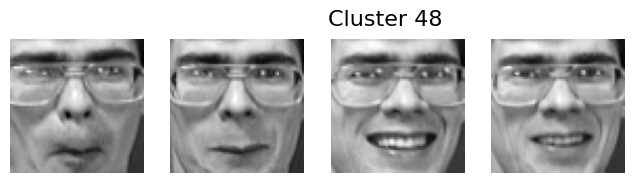

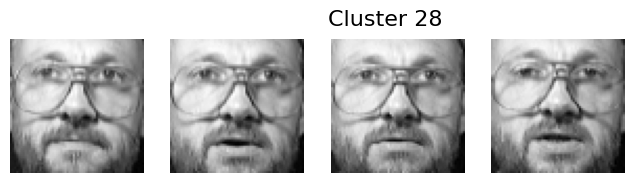

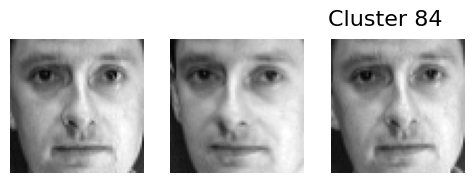

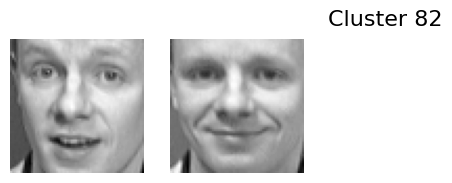

...

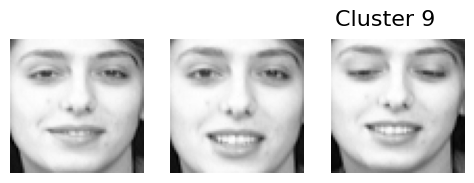

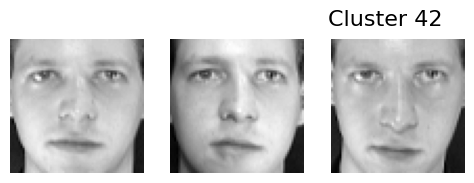

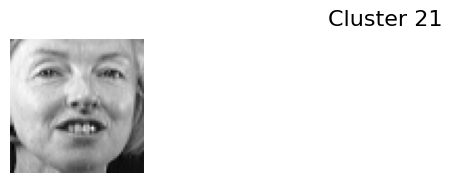

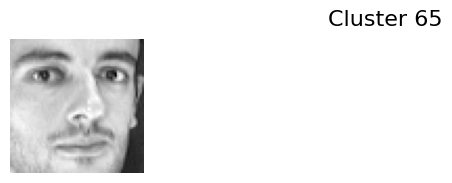

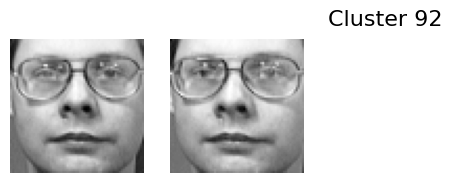

In [ ]:
from sklearn.datasets import fetch_olivetti_faces
from sklearn.model_selection import StratifiedShuffleSplit
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score, homogeneity_score, completeness_score, v_measure_score
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd

# Función para visualizar caras agrupadas por clusters
def plot_clustered_faces(X, labels, n_clusters, n_cols=5, max_images_per_cluster=10):
    clusters_to_display = min(n_clusters, 15)
    selected_clusters = np.random.choice(np.arange(n_clusters), clusters_to_display, replace=False)
    for cluster in selected_clusters:
        cluster_faces = X[labels == cluster]
        if len(cluster_faces) > max_images_per_cluster:
            cluster_faces = cluster_faces[:max_images_per_cluster]
        n_rows = (len(cluster_faces) - 1) // n_cols + 1
        plt.figure(figsize=(n_cols * 2, n_rows * 2))
        for i, face in enumerate(cluster_faces):
            plt.subplot(n_rows, n_cols, i + 1)
            plt.imshow(face.reshape(64, 64), cmap='gray')
            plt.axis('off')
        plt.suptitle(f'Cluster {cluster}', fontsize=16)
        plt.show()

# Cargar el conjunto de datos Olivetti Faces
olivetti = fetch_olivetti_faces()

# Dividir los datos en conjuntos de entrenamiento y prueba con StratifiedShuffleSplit
split = StratifiedShuffleSplit(n_splits=1, test_size=0.2, random_state=42)
for train_index, test_index in split.split(olivetti.data, olivetti.target):
    X_train, X_test = olivetti.data[train_index], olivetti.data[test_index]
    y_train, y_test = olivetti.target[train_index], olivetti.target[test_index]

# Aplicar PCA para reducción de dimensionalidad
pca = PCA(n_components=0.95, random_state=42)
X_train_pca = pca.fit_transform(X_train)
X_test_pca = pca.transform(X_test)

# Calcular el coeficiente de silueta para diferentes valores de k
silhouette_scores = []
k_range = range(30, 120)
for k in k_range:
    kmeans = KMeans(n_clusters=k, n_init=10, random_state=42)
    cluster_labels = kmeans.fit_predict(X_train_pca)
    silhouette_avg = silhouette_score(X_train_pca, cluster_labels)
    silhouette_scores.append(silhouette_avg)

# Seleccionar el número óptimo de clusters que maximiza el coeficiente de silueta
optimal_clusters = k_range[np.argmax(silhouette_scores)]
print("Número óptimo de clusters:", optimal_clusters)

# Entrenar los tres modelos finales con el número óptimo de clusters
final_kmeans_models = [
    KMeans(n_clusters=optimal_clusters, n_init=10, random_state=42, init='k-means++'),
    KMeans(n_clusters=optimal_clusters, n_init=1, random_state=42, init='random'),
    KMeans(n_clusters=optimal_clusters, n_init=10, random_state=42, init='random')
]

# Almacenar métricas para cada modelo final
metrics = []

# Calcular métricas para cada modelo final utilizando datos de prueba
for i, final_kmeans_model in enumerate(final_kmeans_models, start=1):
    if i == 1:
        model_name = "KMeans++ con n_init=10"
    elif i == 2:
        model_name = "Aleatorio con n_init=1"
    else:
        model_name = "Aleatorio con n_init=10"

    final_cluster_labels_train = final_kmeans_model.fit_predict(X_train_pca)
    final_cluster_labels_test = final_kmeans_model.predict(X_test_pca)

    silhouette_train = silhouette_score(X_train_pca, final_cluster_labels_train)
    silhouette_test = silhouette_score(X_test_pca, final_cluster_labels_test)

    homogeneity_train = homogeneity_score(y_train, final_cluster_labels_train)
    homogeneity_test = homogeneity_score(y_test, final_cluster_labels_test)

    completeness_train = completeness_score(y_train, final_cluster_labels_train)
    completeness_test = completeness_score(y_test, final_cluster_labels_test)

    v_measure_train = v_measure_score(y_train, final_cluster_labels_train)
    v_measure_test = v_measure_score(y_test, final_cluster_labels_test)

    metrics.append((
        model_name,
        silhouette_train, silhouette_test,
        homogeneity_train, homogeneity_test,
        completeness_train, completeness_test,
        v_measure_train, v_measure_test
    ))

# Mostrar resumen de métricas para los tres modelos finales
metrics_df = pd.DataFrame(metrics, columns=[
    'Modelo',
    'Silhouette Train', 'Silhouette Test',
    'Homogeneidad Train', 'Homogeneidad Test',
    'Completitud Train', 'Completitud Test',
    'V-Measure Train', 'V-Measure Test'
])
print("\nResumen de métricas para los modelos finales:")
print(metrics_df)

# Graficar comparación de métricas entre los tres modelos finales
plt.figure(figsize=(12, 8))

# Métricas de Silueta
plt.subplot(2, 2, 1)
plt.plot(metrics_df['Modelo'], metrics_df['Silhouette Train'], label='Entrenamiento')
plt.plot(metrics_df['Modelo'], metrics_df['Silhouette Test'], label='Prueba')
plt.title('Silhouette Score')
plt.xlabel('Modelo')
plt.ylabel('Silhouette Score')
plt.xticks(rotation=45)
plt.legend()

# Métricas de Homogeneidad
plt.subplot(2, 2, 2)
plt.plot(metrics_df['Modelo'], metrics_df['Homogeneidad Train'], label='Entrenamiento')
plt.plot(metrics_df['Modelo'], metrics_df['Homogeneidad Test'], label='Prueba')
plt.title('Homogeneidad')
plt.xlabel('Modelo')
plt.ylabel('Homogeneidad')
plt.xticks(rotation=45)
plt.legend()

# Métricas de Completitud
plt.subplot(2, 2, 3)
plt.plot(metrics_df['Modelo'], metrics_df['Completitud Train'], label='Entrenamiento')
plt.plot(metrics_df['Modelo'], metrics_df['Completitud Test'], label='Prueba')
plt.title('Completitud')
plt.xlabel('Modelo')
plt.ylabel('Completitud')
plt.xticks(rotation=45)
plt.legend()

# Métricas de V-Measure
plt.subplot(2, 2, 4)
plt.plot(metrics_df['Modelo'], metrics_df['V-Measure Train'], label='Entrenamiento')
plt.plot(metrics_df['Modelo'], metrics_df['V-Measure Test'], label='Prueba')
plt.title('V-Measure')
plt.xlabel('Modelo')
plt.ylabel('V-Measure')
plt.xticks(rotation=45)
plt.legend()

plt.tight_layout()
plt.show()

# Seleccionar el mejor modelo basado en las métricas
best_model_index = metrics_df['V-Measure Test'].idxmax()
best_model = final_kmeans_models[best_model_index]

# Calcular los clusters para los datos de entrenamiento con el mejor modelo
best_cluster_labels_train = best_model.fit_predict(X_train_pca)

# Visualizar un subconjunto de 10 clusters del mejor modelo
plot_clustered_faces(X_train, best_cluster_labels_train, optimal_clusters)


Comenzamos cargando el conjunto de datos Olivetti Faces y dividiéndolo en conjuntos de entrenamiento y prueba utilizando StratifiedShuffleSplit para asegurar la representación equitativa de las clases en ambos conjuntos. Dado que el conjunto de datos es pequeño, aplicamos PCA para reducir la dimensionalidad y agilizar el proceso computacional. Luego, buscamos el número óptimo de clusters utilizando el coeficiente de silueta y encontramos que con 99 clusters se maximiza este coeficiente.

Entrenamos tres modelos de k-means utilizando diferentes métodos de inicialización y parámetros (k-means++ con n_init=10, aleatorio con n_init=1, y aleatorio con n_init=10 y algoritmo elkan). Evaluamos estos modelos utilizando métricas como el coeficiente de silueta, homogeneidad, completitud y V-Measure tanto en el conjunto de entrenamiento como en el de prueba.

- Homogeneidad: La homogeneidad mide si todos los clusters contienen solo muestras de una sola clase. Toma valores en el rango [0, 1], donde 1 indica que cada cluster contiene solo muestras de una clase.

- Completitud: La completitud mide si todos los elementos de una clase dada están en el mismo cluster. También toma valores en el rango [0, 1], donde 1 indica que todos los elementos de una clase están en el mismo cluster.

- V-Measure: La V-Measure es la puntuación armónica entre homogeneidad y completitud. Es una medida combinada de estas dos métricas y proporciona una visión general del equilibrio entre la homogeneidad y la completitud en el clustering. Toma valores en el rango [0, 1], donde 1 indica una homogeneidad y completitud perfectas.

Optamos por estas métricas porque proporcionan una visión completa de la calidad de los clusters y su adecuación para el problema de clasificación de imágenes de rostros. Los resultados muestran que el modelo aleatorio con n_init=10 es el mejor según el V-Measure en el conjunto de prueba, lo que indica una mejor combinación de homogeneidad y completitud en los clusters. Es interesante notar que en algunas métricas, como la homogeneidad y la completitud, el rendimiento en el conjunto de prueba es incluso mejor que en el conjunto de entrenamiento, lo que sugiere una generalización efectiva del modelo.

En conclusión, este trabajo muestra que el clustering puede ser una técnica efectiva para la clasificación de imágenes de rostros cuando se aplican métodos de evaluación adecuados y se seleccionan cuidadosamente los parámetros del modelo. Sin embargo, sigue siendo un problema desafiante y puede beneficiarse de enfoques más avanzados y datos más detallados en futuras investigaciones.

### <font color='blue'>Ejercicio 1.B: Utilización de DBSCAN (1 punto)</font>

<font color='blue'> En este ejercicio haremos algo similar a lo realizado en el anterior, pero ahora con otro problema sintético en 2D y el algoritmo DBSCAN. Para crear el conjunto sintético haremos uso de la función `make_moons` dentro del paquete de `sklearn.datasets`. Crearemos un conjunto sintético de $1.000$ puntos con una tasa de ruido de $0.05$.


<font color='blue'> Las tareas a realizar a realizar en este ejercicio se resumen a continuación:
1. A partir del conjunto de datos especificado, ajusta un algoritmo DBSCAN con los hiperparámetros por defecto (5 mínimas muestras por cluster). Identifica los índices de los ejemplos núcleo (_core points_)) e imprime sus coordenadas. Para ello, emplea las variables de instancia `core_sample_indices_` y `components_`, respectivamente.
2. La variable de instancia `labels_` contiene el núcleo al que pertenece cada ejemplo
del conjunto de datos. Observa que algunas instancias tienen un índice de cluster
igual a -1, lo que significa que el algoritmo las considera anomalías. En un conjunto
sencillo como este, en un principio, no debería haber anomalías. El hiperparámetro `eps` indica la distancia
máxima entre dos muestras para que una se considere vecina de la otra (no se trata de un
límite máximo de las distancias de los puntos dentro de un cluster). Es el hiperparámetro
de DBSCAN más importante que debes elegir adecuadamente para tu conjunto de datos y
función de distancia. Ajusta 4 modelos de DBSCAN con el hiperparámetro $eps$ igual a
$\{0.01,0.02,0.05,0.1\}$. Dibuja una representación de los clústers para cada modelo
identificando las anomalías que tiene en el gráfico y dando el porcentaje de anomalías
de cada modelo. Analiza y explica los resultados obtenidos.
3. Sorprendentemente, la clase DBSCAN no tiene un método `predict()`,
aunque sí tiene un método `fit_predict()`. En otras palabras, no puede predecir
a qué cluster pertenece una nueva instancia. Esta decisión se tomó porque diferentes
algoritmos de clasificación pueden ser mejores para diferentes tareas, por lo que los
autores decidieron dejar que el usuario eligiera cuál utilizar. Pero sí se puede usar
un clasificador para ver en qué cluster está cada punto nuevo. Hazlo con un clasificador
kNN con un vecindario de 30 vecinos, usando el mejor modelo del apartado anterior y utilizando como
ejemplos de entrenamiento los _core points_ encontrados y como etiquetas (salidas deseadas) las `labels_` obtenidas. Obtén el cluster asociado y la probabilidad para los
siguientes 4 ejemplos `[[-0.5, 0], [0, 0.5], [1, -0.1], [2, 1]]`.
Junto con lo anterior, dibuja un gráfico que represente los bordes de decisión y aplica también k-means sobre los mismo datos. Analiza las diferencias entre dichas fronteras de decisión en base al funcionamiento y naturaleza de los dos algoritmos subyacentes.
    
<font color='blue'> El alumnado debe describir en detalle el trabajo realizado y las conclusiones extraídas.



---



In [ ]:
# Apartado 1
from sklearn.cluster import DBSCAN
from sklearn.datasets import make_moons

X, y = make_moons(n_samples=1000, noise=0.05, random_state=42)

dbscan = DBSCAN()
dbscan.fit(X)

core_indices = dbscan.core_sample_indices_
core_points = X[core_indices]


print("Coordenadas de los ejemplos núcleo:")
print(core_points)


Coordenadas de los ejemplos núcleo:
[[-0.02137124  0.40618608]
 [ 0.97670045 -0.45832306]
 [ 0.90405882 -0.37651952]
 ...
 [ 1.66258462 -0.3079193 ]
 [-0.94355873  0.3278936 ]
 [ 0.79419406  0.60777171]]



En este primer apartado, se ajusta un modelo de DBSCAN a un conjunto de datos sintéticos generado por la función make_moons con una tasa de ruido del 5%. Luego, se identifican los índices de los ejemplos núcleo (core points) utilizando las variables de instancia core_sample_indices_ y components_. Los ejemplos núcleo representan las muestras centrales alrededor de las cuales se construyen los clusters.

La salida proporciona las coordenadas de los ejemplos núcleo, que son una representación de las muestras más significativas dentro del conjunto de datos. Estas coordenadas muestran dónde se encuentran las muestras que son consideradas centrales para la construcción de los clusters por el algoritmo DBSCAN.

Este paso inicial es fundamental para comprender cómo DBSCAN agrupa los datos y cuáles son las muestras más relevantes en el proceso de clustering. En los siguientes apartados, se explorarán diferentes valores del hiperparámetro eps y se analizará cómo afectan a la estructura de los clusters identificados por DBSCAN.

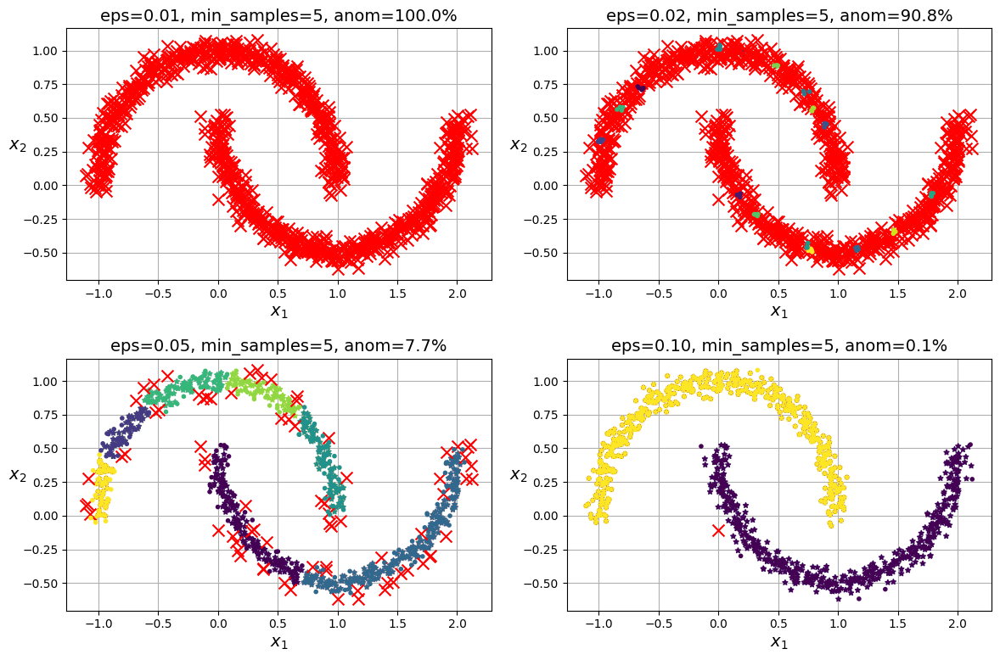

Porcentaje de anomalías para cada modelo DBSCAN:
eps=0.01: 100.00%
eps=0.02: 90.80%
eps=0.05: 7.70%
eps=0.10: 0.10%


In [ ]:
#Apartado 2
def plot_dbscan(dbscan, X, size, show_xlabels=True, show_ylabels=True, anom_rate = 0):
    core_mask = np.zeros_like(dbscan.labels_, dtype=bool)
    core_mask[dbscan.core_sample_indices_] = True
    anomalies_mask = dbscan.labels_ == -1
    non_core_mask = ~(core_mask | anomalies_mask)

    cores = dbscan.components_
    anomalies = X[anomalies_mask]
    non_cores = X[non_core_mask]

    plt.scatter(cores[:, 0], cores[:, 1],
                c=dbscan.labels_[core_mask], marker='o', s=size, cmap="Paired")
    plt.scatter(cores[:, 0], cores[:, 1], marker='*', s=20,
                c=dbscan.labels_[core_mask])
    plt.scatter(anomalies[:, 0], anomalies[:, 1],
                c="r", marker="x", s=100)
    plt.scatter(non_cores[:, 0], non_cores[:, 1],
                c=dbscan.labels_[non_core_mask], marker=".")
    if show_xlabels:
        plt.xlabel("$x_1$")
    else:
        plt.tick_params(labelbottom=False)
    if show_ylabels:
        plt.ylabel("$x_2$", rotation=0)
    else:
        plt.tick_params(labelleft=False)
    plt.title(f"eps={dbscan.eps:.2f}, min_samples={dbscan.min_samples}, anom={anom_rate}%")
    plt.grid()
    plt.gca().set_axisbelow(True)

#A CUBRIR POR EL ALUMNADO

eps_values = [0.01, 0.02, 0.05, 0.1]
anomaly_rates = []

plt.figure(figsize=(12, 8))
for i, eps in enumerate(eps_values, start=1):
    dbscan = DBSCAN(eps=eps)
    dbscan.fit(X)

    core_indices = dbscan.core_sample_indices_
    n_anomalies = np.sum(dbscan.labels_ == -1)
    anom_rate = (n_anomalies / len(X)) * 100
    anomaly_rates.append(anom_rate)

    plt.subplot(2, 2, i)
    plot_dbscan(dbscan, X, size=10, anom_rate=anom_rate)

plt.tight_layout()
plt.show()

print("Porcentaje de anomalías para cada modelo DBSCAN:")
for eps, rate in zip(eps_values, anomaly_rates):
    print(f"eps={eps:.2f}: {rate:.2f}%")


En este segundo apartado, se ajustan cuatro modelos de DBSCAN con diferentes valores del hiperparámetro eps (0.01, 0.02, 0.05, 0.1) sobre el conjunto de datos generado anteriormente. Luego, se visualizan los clusters identificados por cada modelo, identificando las anomalías en el gráfico y proporcionando el porcentaje de anomalías de cada modelo.

Las visualizaciones muestran cómo cambia la estructura de los clusters con diferentes valores de eps. A medida que aumenta eps, se consideran más puntos como vecinos, lo que resulta en menos clusters y menos anomalías. Por el contrario, a medida que eps disminuye, se identifican más clusters y más anomalías.

Los porcentajes de anomalías indican qué proporción del conjunto de datos se considera anómala para cada valor de eps. Se observa que, con un eps muy pequeño (0.01), se considera que todos los puntos son anomalías, lo que sugiere que la distancia máxima entre puntos para considerarlos vecinos es demasiado pequeña para este conjunto de datos. A medida que eps aumenta, el porcentaje de anomalías disminuye drásticamente hasta llegar a solo el 0.10% con eps=0.1.

Estos resultados resaltan la importancia de elegir adecuadamente el hiperparámetro eps en DBSCAN, ya que afecta significativamente la estructura de los clusters identificados y la proporción de anomalías detectadas. Es crucial encontrar un equilibrio para identificar correctamente los clusters sin incluir un número excesivo de anomalías.

Instancia: [-0.5  0. ] -> Cluster: 1, Probabilidad: [0.1 0.9]
Instancia: [0.  0.5] -> Cluster: 0, Probabilidad: [1. 0.]
Instancia: [ 1.  -0.1] -> Cluster: 1, Probabilidad: [0. 1.]
Instancia: [2. 1.] -> Cluster: 0, Probabilidad: [1. 0.]


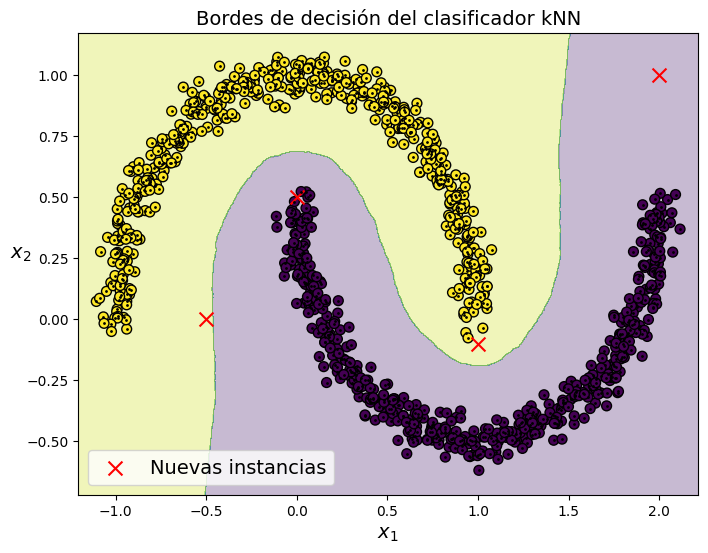

/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(


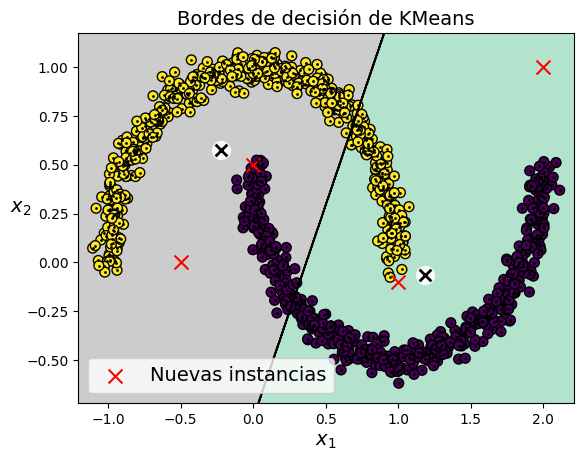

In [ ]:
from sklearn.neighbors import KNeighborsClassifier

# Filtrar los datos de entrenamiento para incluir solo los ejemplos núcleo
X_train_core = X[dbscan.core_sample_indices_]
y_train_core = dbscan.labels_[dbscan.core_sample_indices_]

# Entrenar un clasificador kNN con vecindario de 30 vecinos
knn_classifier = KNeighborsClassifier(n_neighbors=30)
knn_classifier.fit(X_train_core, y_train_core)

# Nuevas instancias
new_instances = np.array([[-0.5, 0], [0, 0.5], [1, -0.1], [2, 1]])

# Predecir los clusters asociados y las probabilidades usando el clasificador kNN
predicted_clusters = knn_classifier.predict(new_instances)
predicted_probabilities = knn_classifier.predict_proba(new_instances)

# Imprimir los clusters asociados y las probabilidades
for instance, cluster, probability in zip(new_instances, predicted_clusters, predicted_probabilities):
    print(f"Instancia: {instance} -> Cluster: {cluster}, Probabilidad: {probability}")

# Dibujar los bordes de decisión del clasificador kNN
def plot_knn_decision_boundaries(classifier, X, resolution=1000, show_data=True, show_xlabels=True, show_ylabels=True):
    mins = X.min(axis=0) - 0.1
    maxs = X.max(axis=0) + 0.1
    xx, yy = np.meshgrid(np.linspace(mins[0], maxs[0], resolution),
                         np.linspace(mins[1], maxs[1], resolution))
    Z = classifier.predict(np.c_[xx.ravel(), yy.ravel()])
    Z = Z.reshape(xx.shape)

    plt.contourf(xx, yy, Z, alpha=0.3)
    if show_data:
        plot_data(X)
    if show_xlabels:
        plt.xlabel("$x_1$", fontsize=14)
    else:
        plt.tick_params(labelbottom=False)
    if show_ylabels:
        plt.ylabel("$x_2$", fontsize=14, rotation=0)
    else:
        plt.tick_params(labelleft=False)

plt.figure(figsize=(8, 6))
plot_knn_decision_boundaries(knn_classifier, X_train_core)
plt.title("Bordes de decisión del clasificador kNN")
plt.scatter(X_train_core[:, 0], X_train_core[:, 1], c=y_train_core, marker='o', s=50, cmap='viridis', edgecolors='k')
plt.scatter(new_instances[:, 0], new_instances[:, 1], marker='x', s=100, color='red', label='Nuevas instancias')
plt.legend()
plt.show()

# Aplicar KMeans sobre los mismos datos
kmeans = KMeans(n_clusters=len(np.unique(y_train_core)), random_state=42)
kmeans.fit(X_train_core)

# Dibujar los bordes de decisión de KMeans
plot_decision_boundaries(kmeans, X_train_core, resolution=1000)
plt.title("Bordes de decisión de KMeans")
plt.scatter(X_train_core[:, 0], X_train_core[:, 1], c=y_train_core, marker='o', s=50, cmap='viridis', edgecolors='k')
plt.scatter(new_instances[:, 0], new_instances[:, 1], marker='x', s=100, color='red', label='Nuevas instancias')
plt.legend()
plt.show()


En este apartado, se utilizó un clasificador kNN para determinar a qué cluster pertenecen nuevas instancias en función de los ejemplos de entrenamiento obtenidos del mejor modelo de DBSCAN en el apartado anterior. Además, se dibujaron los bordes de decisión tanto para el clasificador kNN como para KMeans, aplicado sobre los mismos datos.

Las predicciones realizadas por el clasificador kNN muestran cómo las nuevas instancias se asignan a los clusters identificados por DBSCAN. Las probabilidades asociadas a cada predicción indican el nivel de confianza del clasificador en sus asignaciones. Por otro lado, al observar los bordes de decisión de ambos algoritmos, se aprecia claramente cómo DBSCAN y KMeans construyen clusters de manera diferente, lo que influye en las predicciones realizadas para las nuevas instancias.

En las visualizaciones, se puede ver que DBSCAN identifica clusters con formas más complejas, como curvas, mientras que KMeans tiende a formar clusters más simples y convexos. Esto se refleja en las predicciones, donde las nuevas instancias se clasifican en clusters diferentes según el algoritmo utilizado. Por ejemplo, en el caso de las instancias [-0.5, 0] y [1, -0.1], DBSCAN las asigna al mismo cluster debido a su proximidad en la curva superior, mientras que KMeans las asigna a clusters diferentes debido a su posición relativa a los centroides.

Estos resultados sugieren que DBSCAN puede ser más adecuado para conjuntos de datos con estructuras complejas y no lineales, mientras que KMeans puede funcionar mejor en conjuntos de datos con estructuras más simples y lineales. La elección del algoritmo de clustering adecuado depende en gran medida de la naturaleza de los datos y de los objetivos específicos del análisis. En este caso, DBSCAN demostró ser más flexible y capaz de capturar la estructura subyacente del conjunto de datos sintético con formas no convencionales.

## <font color='blue'>Ejercicio 2: PROBLEMA DE AGRUPAMIENTO (5 puntos)</font>

<font color='blue'> Para la realización de este ejercicio, se ha seleccionado el dataset denominado "Anuran Calls (MFCCs)" [1] (https://archive.ics.uci.edu/dataset/406/anuran+calls+mfccs). Este conjunto de datos describe las características sonoras de los cantos de diferentes especies de anfibios del orden Anura, cuyos integrantes coloquialmente son conocidos como ranas o sapos.

<font color='blue'> Se encuentran representados por medio de los coeficientes cepstrales en las frecuencias de Mel ([_Mel-frequency cepstral coefficients_](https://en.wikipedia.org/wiki/Mel-frequency_cepstrum), MFCCs), que son en esencia, una representación abstracta de una señal de audio obtenida al aplicar una transformada del coseno discreta a un espectrograma de Mel, es decir, una representación  de las frecuencias auditivas que son capaces de captar los humanos. Debido a ser una representación compacta del [espectrograma](https://en.wikipedia.org/wiki/Spectrogram), manteniendo las características más importantes del audio, se utiliza de forma regular en procesado del habla y aplicaciones de aprendizaje automático en procesado de señales de audio [2].

<font color='blue'> El dataset, creado por investigadores de la Universidad Federal del Amazonas en Brasil, contiene individuos de 10 especies, también incluyéndose su género y familia taxonómica, con el objetivo original de lograr realizar una clasificación multiclase de las especies de anuros que fueron grabados en los terrenos de la Universidad, así como de Mata atlántica (Brasil) y Córdoba (Argentina) en condiciones reales, es decir, con ruido de fondo.
    
<font color='blue'> Este conjunto de datos se utilizó en varias tareas de clasificación relacionadas con el reto del reconocimiento de especies de anuros a través de sus llamadas. Se trata de un conjunto de datos multietiqueta con tres columnas de etiquetas. Este conjunto de datos se creó segmentando 60 registros de audio pertenecientes a 4 familias diferentes, 8 géneros y 10 especies. Cada audio corresponde a un espécimen (una rana individual), el ID del registro también se incluye como columna adicional. Se utilizaron la entropía espectral y un método de cluster binario para detectar los fragmentos de audio pertenecientes a cada sonido. La segmentación y la extracción de características se realizaron en Matlab. Tras la segmentación se obtuvieron 7195 sílabas, que se convirtieron en instancias para entrenar y probar el clasificador.

<font color='blue'> Resulta entonces interesante saber si las clasificaciones taxonómicas realizadas tienen sentido en cuanto a los datos, es decir, ¿realmente se corresponden de cierta forma los distintos cantos de los anuros con la clasificación que poseen actualmente? ¿O existen especies que, siendo de diferentes grupos taxonómicos, poseen un canto indistinguible?

### <font color='blue'> Objetivos
    
<font color='blue'> El objetivo del presente trabajo es analizar los patrones de los datos, sin tomar en cuenta su _ground truth_, para determinar si la clasificación taxonómica actual corresponde razonablemente con una diferencia en los cantos. Claro está que este estudio representará un análisis superficial del problema, pero al menos sí podrá servir de base para estudiar si podemos determinar una taxonomía aproximada de los anuros.

<font color='blue'> Para llevar a cabo este objetivo principal se llevarán a cabo los siguientes objetivos secundarios:
1. <font color='blue'> Realización de un análisis exploratorio de los datos para una primera observación de las distribuciones de los cantos.
2. Detección y eliminación de _outliers_ así como las transformaciones necesarias para que los datos sean lo más "correctos" para los métodos de _clustering_.
4. Experimentación y determinación de los algoritmos y métricas intrínsecas más acordes a los datos. El alumnado debe experimentar con, al menos, dos algoritmos diferentes de _clustering_.

### <font color='blue'> Hipótesis
<font color='blue'>Sobre los datos se pueden realizar las siguientes hipótesis:
- <font color='blue'>Los datos, siendo grabaciones que incluyen el ruido de fondo, poseerán una cantidad significativa de _outliers_.
- <font color='blue'>Será posible, al menos en parte, observar cierta "agrupación" en los datos a simple vista.
- <font color='blue'>Existirá cierta correlación entre los _MFCCs_ debido a que provienen de una misma grabación, por lo que ciertas columnas/características crecerán o disminuirán de forma conjunta. En otras palabras, como el dispositivo empleado para adquirir sonidos es el mismo para todas las pistas de audio (7195), es razonable pensar que si algún _MFCC_ presenta algún problema, o atenuación de algún tipo, dicha particularidad podrá estar presente en todas las instancias/observaciones.  

### <font color='blue'> Resultados Esperados
<font color='blue'> Se espera que los resultados que se obtengan del clustering sean razonablemente parecidos a la realidad. Es decir, se espera que el agrupamiento encontrado tenga algún tipo de relación con alguna de las últimas 4 columnas de los datos (_Family_, _Genus_, _Species_ o _RecordID_).

### <font color='blue'> Bibliografía

<font color='blue'><font color='blue'>[1] E. N. Juan Colonna, “Anuran Calls (MFCCs).” UCI Machine Learning Repository, 2015. doi: 10.24432/C5CC9H. https://archive.ics.uci.edu/dataset/406/anuran+calls+mfccs

<font color='blue'>[2] “3.8. The cepstrum, mel-cepstrum and mel-frequency cepstral coefficients (MFCCs) — Introduction to Speech Processing.” Accessed: Jan. 13, 2024. [Online]. Available: https://speechprocessingbook.aalto.fi/Representations/Melcepstrum.html#the-cepstrum




In [ ]:
#Para acceder a nuestros ficheros de Google Drive
from google.colab import drive
drive.mount('/content/drive')
# La carpeta 'clasificacion' (que contiene optdigits.tes, optdigits.tra, optdigits.names)
# debe estar en vuestro Drive, dentro de la carpeta 'Colab Notebooks'

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [ ]:
dataFolder = 'drive/MyDrive/Colab Notebooks/clustering/'

In [ ]:
import pandas as pd

df_frogs = pd.read_csv(dataFolder + "/dataset/Frogs_MFCCs.csv")
df_frogs

,MFCCs_ 1,MFCCs_ 2,MFCCs_ 3,MFCCs_ 4,MFCCs_ 5,MFCCs_ 6,MFCCs_ 7,MFCCs_ 8,MFCCs_ 9,MFCCs_10,...,MFCCs_17,MFCCs_18,MFCCs_19,MFCCs_20,MFCCs_21,MFCCs_22,Family,Genus,Species,RecordID
0,1.0,0.152936,-0.105586,0.200722,0.317201,0.260764,0.100945,-0.150063,-0.171128,0.124676,...,-0.108351,-0.077623,-0.009568,0.057684,0.118680,0.014038,Leptodactylidae,Adenomera,AdenomeraAndre,1
1,1.0,0.171534,-0.098975,0.268425,0.338672,0.268353,0.060835,-0.222475,-0.207693,0.170883,...,-0.090974,-0.056510,-0.035303,0.020140,0.082263,0.029056,Leptodactylidae,Adenomera,AdenomeraAndre,1
2,1.0,0.152317,-0.082973,0.287128,0.276014,0.189867,0.008714,-0.242234,-0.219153,0.232538,...,-0.050691,-0.023590,-0.066722,-0.025083,0.099108,0.077162,Leptodactylidae,Adenomera,AdenomeraAndre,1
3,1.0,0.224392,0.118985,0.329432,0.372088,0.361005,0.015501,-0.194347,-0.098181,0.270375,...,-0.136009,-0.177037,-0.130498,-0.054766,-0.018691,0.023954,Leptodactylidae,Adenomera,AdenomeraAndre,1
4,1.0,0.087817,-0.068345,0.306967,0.330923,0.249144,0.006884,-0.265423,-0.172700,0.266434,...,-0.048885,-0.053074,-0.088550,-0.031346,0.108610,0.079244,Leptodactylidae,Adenomera,AdenomeraAndre,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
7190,1.0,-0.554504,-0.337717,0.035533,0.034511,0.443451,0.093889,-0.100753,0.037087,0.081075,...,0.069430,0.071001,0.021591,0.052449,-0.021860,-0.079860,Hylidae,Scinax,ScinaxRuber,60
7191,1.0,-0.517273,-0.370574,0.030673,0.068097,0.402890,0.096628,-0.116460,0.063727,0.089034,...,0.061127,0.068978,0.017745,0.046461,-0.015418,-0.101892,Hylidae,Scinax,ScinaxRuber,60
7192,1.0,-0.582557,-0.343237,0.029468,0.064179,0.385596,0.114905,-0.103317,0.070370,0.081317,...,0.082474,0.077771,-0.009688,0.027834,-0.000531,-0.080425,Hylidae,Scinax,ScinaxRuber,60
7193,1.0,-0.519497,-0.307553,-0.004922,0.072865,0.377131,0.086866,-0.115799,0.056979,0.089316,...,0.051796,0.069073,0.017963,0.041803,-0.027911,-0.096895,Hylidae,Scinax,ScinaxRuber,60


###<font color='blue'>2.1 Análisis exploratorio de los datos

####Distribución de las Etiquetas Taxonómicas
En esta subsección, analizaremos la distribución de las etiquetas de familia, género y especie en el dataset. Esto nos permitirá entender cómo están representadas estas etiquetas y si hay algún desequilibrio en la distribución de las clases.

In [ ]:
# Contar la frecuencia de cada valor en las columnas de etiquetas taxonómicas
family_counts = df_frogs['Family'].value_counts()
genus_counts = df_frogs['Genus'].value_counts()
species_counts = df_frogs['Species'].value_counts()

# Mostrar las frecuencias de cada etiqueta
print("Frecuencia de Familias:")
print(family_counts)
print("\nFrecuencia de Géneros:")
print(genus_counts)
print("\nFrecuencia de Especies:")
print(species_counts)


Frecuencia de Familias:
Family
Leptodactylidae    4420
Hylidae            2165
Dendrobatidae       542
Bufonidae            68
Name: count, dtype: int64

Frecuencia de Géneros:
Genus
Adenomera        4150
Hypsiboas        1593
Ameerega          542
Dendropsophus     310
Leptodactylus     270
Scinax            148
Osteocephalus     114
Rhinella           68
Name: count, dtype: int64

Frecuencia de Especies:
Species
AdenomeraHylaedactylus    3478
HypsiboasCordobae         1121
AdenomeraAndre             672
Ameeregatrivittata         542
HypsiboasCinerascens       472
HylaMinuta                 310
LeptodactylusFuscus        270
ScinaxRuber                148
OsteocephalusOophagus      114
Rhinellagranulosa           68
Name: count, dtype: int64


- Podemos observar que hay diferentes niveles de desequilibrio en la distribución de las clases. Por ejemplo, la familia "Bufonidae" tiene una frecuencia mucho menor en comparación con otras familias.
- De manera similar, algunas especies están representadas con mayor frecuencia que otras. Esto puede ser importante tenerlo en cuenta al realizar análisis posteriores o modelado de datos.

####Visualización de Características
En esta subsección, utilizaremos técnicas de visualización para explorar las características de los MFCCs y buscar patrones o agrupaciones en los datos.

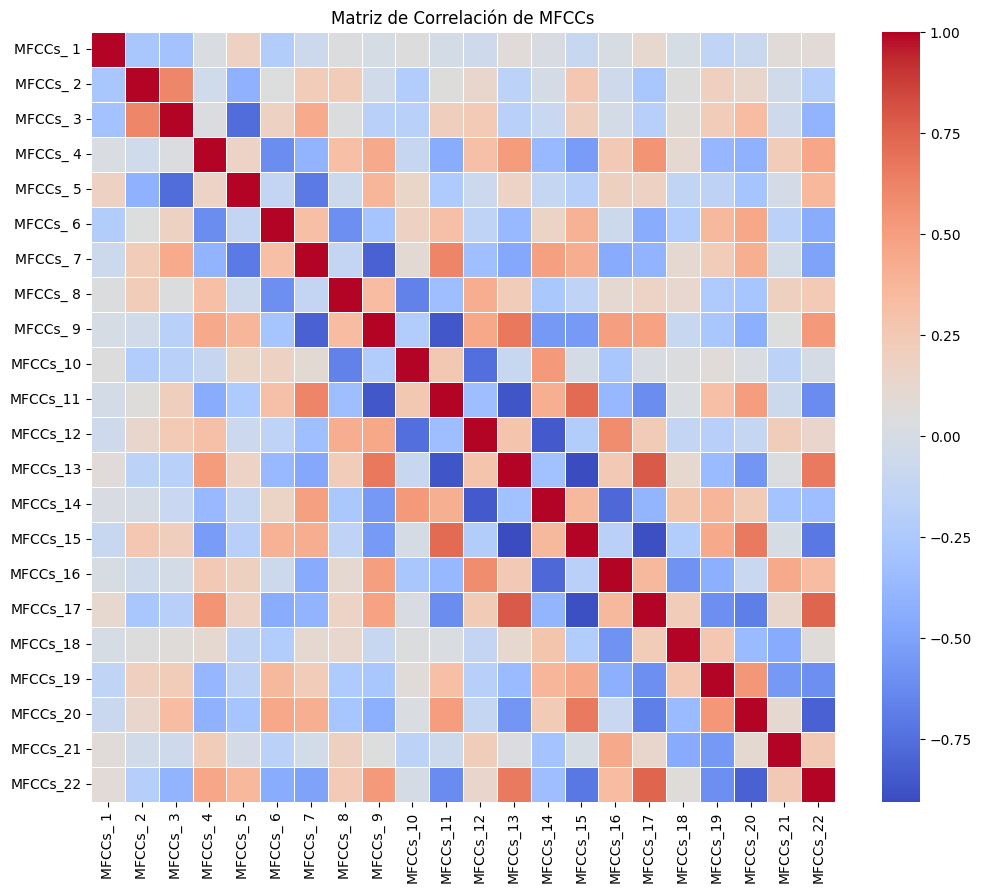

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns

# Seleccionar solo las columnas de los MFCCs para visualización
mfcc_columns = df_frogs.columns[:22]

# Calcular la matriz de correlación entre las características de los MFCCs
mfcc_corr = df_frogs[mfcc_columns].corr()

# Visualizar la matriz de correlación utilizando un mapa de calor
plt.figure(figsize=(12, 10))
sns.heatmap(mfcc_corr, annot=False, cmap='coolwarm', linewidths=0.5)
plt.title('Matriz de Correlación de MFCCs')
plt.show()


En la matriz de correlación de las características de los MFCCs, no se observan grandes grupos de correlaciones evidentes a simple vista. Sin embargo, se puede notar que algunos pares de características muestran cierta correlación. Específicamente, los pares 17-22, 13-17 y 11-15 parecen estar correlacionados.

####Distribución de Características de MFCCs
Exploraremos la distribución de las características individuales de los MFCCs. Esto nos ayudará a comprender mejor la variabilidad y la naturaleza de cada característica en el dataset.

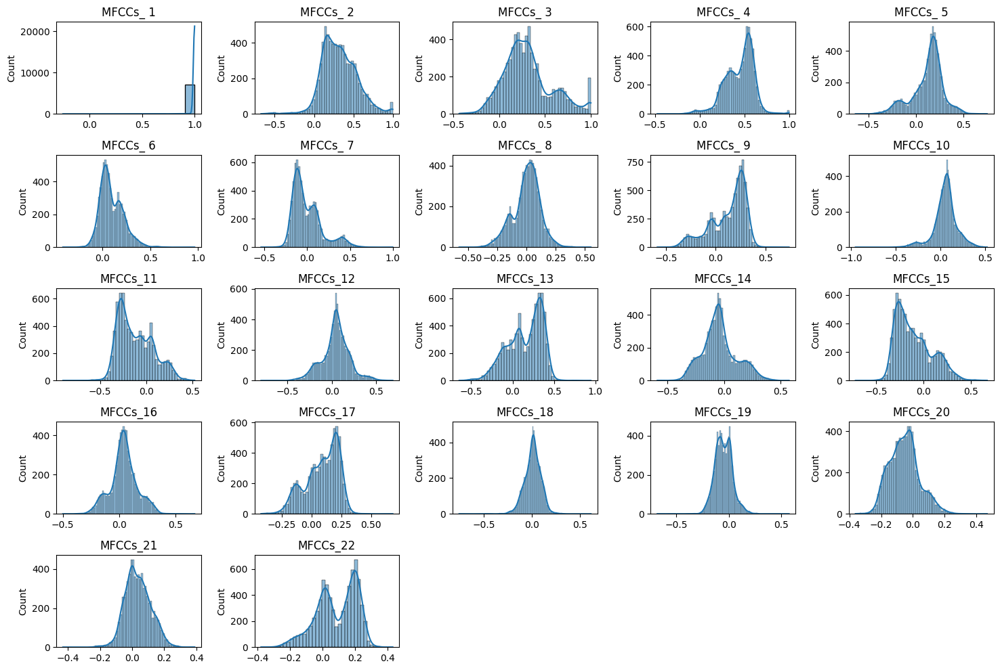

In [ ]:
# Seleccionar solo las columnas de los MFCCs para visualización
mfcc_columns = df_frogs.columns[:22]

# Visualizar la distribución de cada característica de MFCCs
plt.figure(figsize=(15, 10))
for i, column in enumerate(mfcc_columns, 1):
    plt.subplot(5, 5, i)
    sns.histplot(df_frogs[column], kde=True)
    plt.title(column)
    plt.xlabel('')
plt.tight_layout()
plt.show()


###<font color='blue'>2.2 Definición de Métricas para ver la corcondancia de los clusters con el Ground Truth.

####Adjusted Rand Index (ARI)
El Índice Rand Ajustado (ARI) es una medida de similitud entre dos agrupaciones que compara todos los pares de muestras y mide cuántos de estos pares se agrupan o se dividen de la misma manera en ambas agrupaciones. Esencialmente, compara cómo los clusters generados por un algoritmo de agrupación se alinean con las etiquetas reales de los datos. El ARI varía entre -1 y 1, donde 1 indica una concordancia perfecta entre los clusters y las etiquetas reales, 0 indica concordancia esperada para una asignación aleatoria y valores negativos indican una agrupación divergente respecto a las etiquetas reales.



In [ ]:
from sklearn.metrics import adjusted_rand_score, mutual_info_score, silhouette_score

def evaluate_clustering(X, true_labels, cluster_labels):
    """
    Evalúa un algoritmo de clustering mediante el adjusted rand index (ARI).

    Args:
    - X: Conjunto de datos de características.
    - true_labels: Etiquetas reales de los datos.
    - cluster_labels: Etiquetas de cluster asignadas por el algoritmo de clustering.

    Returns:
    - ari: ARI para evaluar la concordancia con las etiquetas reales.
    """
    # Calcular el ARI
    ari = adjusted_rand_score(true_labels, cluster_labels)

    return ari

###<font color='blue'>2.3 Detección y eliminación de outliers y transformaciones de cara al clustering.

####Visualización Inicial de Posibles Outliers
En esta subsección, realizaremos una visualización inicial de posibles outliers en el dataset utilizando una reducción de dimensionalidad mediante PCA (Análisis de Componentes Principales) para proyectar los datos en un espacio de dos dimensiones. Esto nos permitirá identificar patrones o agrupaciones inusuales que podrían indicar la presencia de outliers.

In [ ]:
!pip install pyod

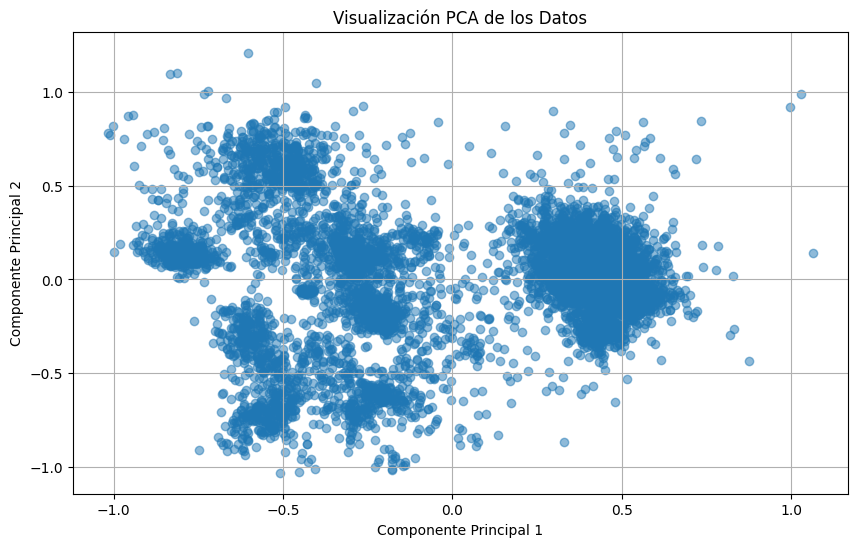

In [ ]:
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

# Seleccionar solo las columnas de los MFCCs para el análisis
X = df_frogs.iloc[:, :22]

# Aplicar PCA para reducir la dimensionalidad a 2 dimensiones
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X)

# Visualizar los datos reducidos en un gráfico de dispersión
plt.figure(figsize=(10, 6))
plt.scatter(X_pca[:, 0], X_pca[:, 1], alpha=0.5)
plt.title('Visualización PCA de los Datos')
plt.xlabel('Componente Principal 1')
plt.ylabel('Componente Principal 2')
plt.grid(True)
plt.show()



Resultados de la Visualización Inicial de Posibles Outliers
La visualización inicial mediante PCA de los datos revela patrones interesantes que podrían ser útiles para el proceso de clustering. En particular, se pueden observar ciertos agrupamientos de instancias que podrían representar posibles clusters, siendo uno de ellos notablemente prominente hacia la derecha de la gráfica. Este agrupamiento podría ser de especial interés para un análisis más detallado durante el proceso de clustering.

Además, se pueden discernir puntos que no parecen encajar en ninguno de estos agrupamientos identificados, lo que sugiere la presencia de posibles outliers en el dataset. Estos puntos atípicos requerirán una atención adicional durante el análisis y podrían ser candidatos para su eliminación o tratamiento adecuado antes de realizar el clustering.

Es importante tener en cuenta que, si bien esta visualización proporciona información valiosa sobre la estructura de los datos, la reducción PCA a dos dimensiones desde 22 características puede introducir cierto sesgo y limitaciones en la representación de la variabilidad de los datos. Por lo tanto, se deben interpretar los resultados con precaución y considerar análisis adicionales para una comprensión más completa de la distribución de los datos.

####Detección de Outliers con Isolation Forest
En esta subsección, utilizaremos el algoritmo Isolation Forest para detectar outliers en nuestro conjunto de datos. Isolation Forest es un método de detección de anomalías basado en árboles de decisión que identifica observaciones atípicas considerándolas como anomalías en un conjunto de datos.

Primero, definimos una función detect_outliers que toma como entrada el conjunto de datos X y el parámetro de contaminación, que determina la proporción de outliers esperados en el conjunto de datos. La función entrena un modelo de Isolation Forest con el valor de contaminación dado y predice los outliers en el conjunto de datos.

Luego, iteramos sobre una lista de diferentes valores de contaminación y llamamos a la función detect_outliers para cada valor. Para cada conjunto de outliers detectado, visualizamos los datos utilizando PCA y resaltamos los outliers en el gráfico con un color violeta.

Este proceso nos permite explorar cómo varía la detección de outliers con diferentes valores de contaminación y nos proporciona información sobre la distribución de outliers en nuestros datos.

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but IsolationForest was fitted without feature names
  warnings.warn(


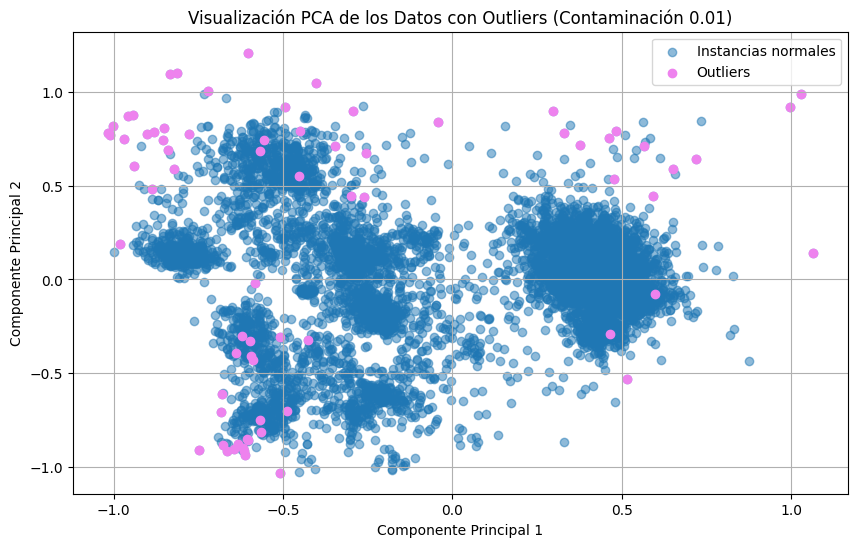

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but IsolationForest was fitted without feature names
  warnings.warn(


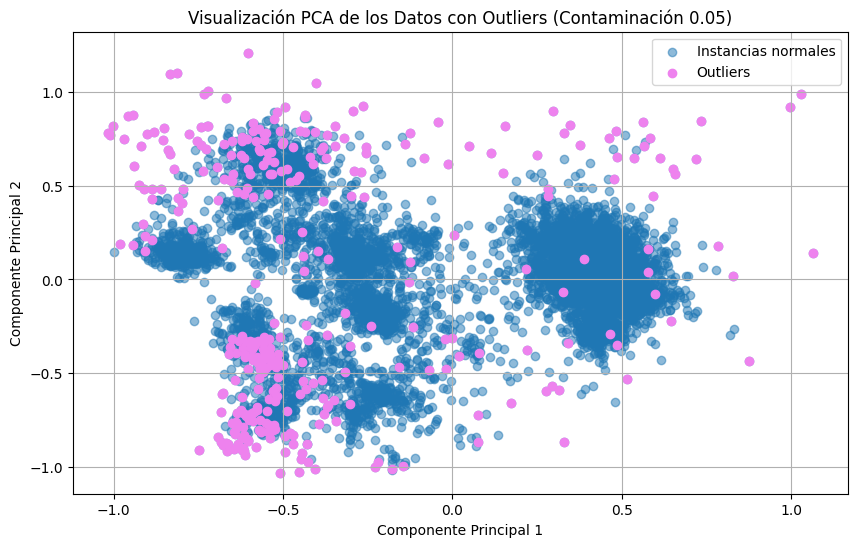

/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but IsolationForest was fitted without feature names
  warnings.warn(


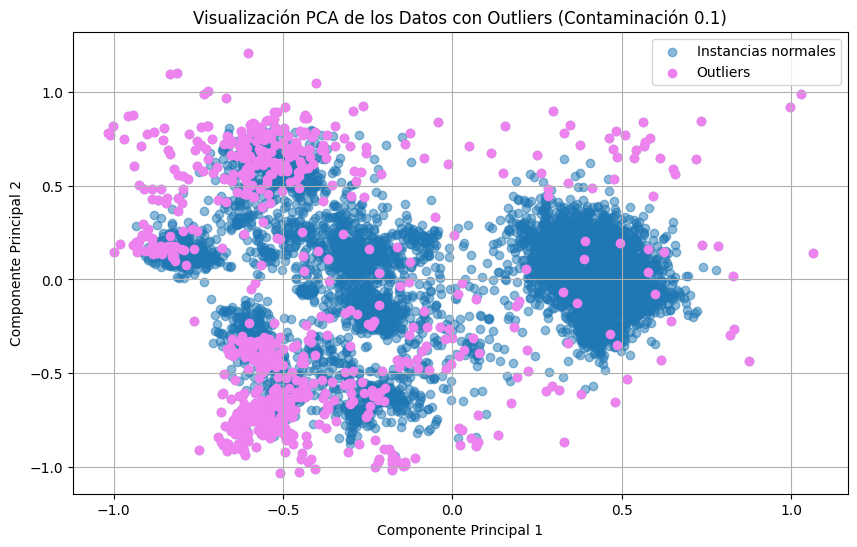

In [ ]:
from pyod.models.iforest import IForest

def detect_outliers(X, contamination):
    """
    Detecta outliers utilizando Isolation Forest con el valor de contaminación dado.

    Args:
    - X: Conjunto de datos de características.
    - contamination: Valor de contaminación para el modelo Isolation Forest.

    Returns:
    - outliers_df: DataFrame de pandas que contiene las filas identificadas como outliers.
    """
    # Inicializar el modelo de Isolation Forest
    model = IForest(contamination=contamination, behaviour='new', random_state=42)

    # Entrenar el modelo y predecir los outliers
    model.fit(X)
    outliers = model.predict(X)

    # Mostrar las filas identificadas como outliers
    outliers_df = df_frogs[outliers == 1]

    return outliers_df

# Llamar a la función con diferentes valores de contaminación y visualizar los resultados
contaminations_to_test = [0.01, 0.05, 0.1]

for contamination in contaminations_to_test:
    outliers_df = detect_outliers(X, contamination)

    # Visualizar los datos con puntos outliers resaltados
    plt.figure(figsize=(10, 6))
    plt.scatter(X_pca[:, 0], X_pca[:, 1], alpha=0.5, label='Instancias normales')
    plt.scatter(X_pca[outliers_df.index, 0], X_pca[outliers_df.index, 1], color='violet', label='Outliers')
    plt.title('Visualización PCA de los Datos con Outliers (Contaminación {})'.format(contamination))
    plt.xlabel('Componente Principal 1')
    plt.ylabel('Componente Principal 2')
    plt.legend()
    plt.grid(True)
    plt.show()



Observamos que el número de outliers detectados varía según el valor del parámetro de contaminación. A medida que aumentamos el valor de contaminación, se detectan más outliers en el conjunto de datos.

Sin embargo, es importante tener en cuenta que la visualización de los datos se realiza después de aplicar PCA, lo que puede afectar la interpretación de los resultados. A pesar de esto, observamos que un valor de contaminación de 0.05 parece ser apropiado, ya que no parece interferir significativamente con las agrupaciones de datos.

Es importante destacar que estos resultados se utilizarán como referencia para la experimentación en la siguiente sección, donde evaluaremos el rendimiento de diferentes valores de contaminación en términos de su impacto en la calidad de los clusters obtenidos.

####Manejo de outliers y otras transoformaciones y normalizaciones
Se propondrán diferentes técnicas para el manejo de los outliers para posteriormente experimentar cuál es la más conveniente.

#####Eliminación de Outliers
Simplemente, aquellas instancias detectadas como outliers se eliminan.

In [ ]:
def remove_outliers(X, contamination):
    """
    Elimina los outliers del conjunto de datos utilizando Isolation Forest.

    Args:
    - X: Conjunto de datos de características.

    Returns:
    - X_clean: Conjunto de datos sin outliers.
    """
    # Detectar outliers
    outliers_df = detect_outliers(X, contamination)

    # Obtener los índices de las filas identificadas como outliers
    outlier_indices = outliers_df.index

    # Eliminar outliers del conjunto de datos
    X_clean = np.delete(X, outlier_indices, axis=0)

    return X_clean



#####Transformación Logarítmica

La función de transformación logarítmica aplica el logaritmo natural (logaritmo neperiano) a cada valor en el conjunto de datos. Esta transformación es útil para reducir la varianza de los datos y hacer que la distribución sea más simétrica, lo que puede ayudar a estabilizar la varianza y hacer que los datos sean más adecuados para ciertos modelos estadísticos.

In [ ]:
def log_transform(X):
    """
    Aplica la transformación logarítmica a los datos.

    Args:
    - X: Conjunto de datos de características.

    Returns:
    - X_log: Conjunto de datos transformado con logaritmo.
    """
    # Aplicar la transformación logarítmica
    X_log = np.log1p(X)

    return X_log


#####Normalización Min-Max

La normalización Min-Max ajusta los valores de las características para que estén dentro de un rango específico, generalmente entre 0 y 1. Esto se logra reescalando cada valor de la característica en relación con su valor mínimo y máximo en el conjunto de datos.

In [ ]:
from sklearn.preprocessing import MinMaxScaler

def min_max_normalize(X):
    """
    Aplica la normalización Min-Max a los datos.

    Args:
    - X: Conjunto de datos de características.

    Returns:
    - X_minmax: Conjunto de datos normalizado Min-Max.
    """
    # Inicializar el objeto MinMaxScaler
    scaler = MinMaxScaler()

    # Aplicar la normalización Min-Max
    X_minmax = scaler.fit_transform(X)

    return X_minmax


#####Normalización Z-score (Estándar)
La normalización Z-score, también conocida como estandarización, ajusta los valores de las características para que tengan una media de 0 y una desviación estándar de 1. Esto se logra reescalando cada valor de la característica en relación con su media y desviación estándar en el conjunto de datos.

In [ ]:
from sklearn.preprocessing import StandardScaler

def zscore_normalize(X):
    """
    Aplica la normalización Z-score (estándar) a los datos.

    Args:
    - X: Conjunto de datos de características.

    Returns:
    - X_zscore: Conjunto de datos normalizado Z-score.
    """
    # Inicializar el objeto StandardScaler
    scaler = StandardScaler()

    # Aplicar la normalización Z-score
    X_zscore = scaler.fit_transform(X)

    return X_zscore


#####Normalización Robusta

La normalización robusta, también conocida como escalado robusto, es una técnica utilizada para escalar los datos de manera que sean menos sensibles a los valores extremos u outliers en el conjunto de datos. A diferencia de la normalización estándar, la normalización robusta utiliza estadísticas resistentes a outliers, como la mediana y el rango intercuartílico, para escalar los datos. Esto permite que la normalización robusta sea más adecuada para conjuntos de datos que contienen valores atípicos, ya que no se ven afectados significativamente por estos valores extremos.

In [ ]:
from sklearn.preprocessing import RobustScaler

def robust_normalize(X):
    """
    Aplica la normalización robusta a los datos.

    Args:
    - X: Conjunto de datos de características.

    Returns:
    - X: Conjunto de datos normalizado robusto.
    """
    # Inicializar el objeto RobustScaler
    scaler = RobustScaler()

    # Aplicar la normalización robusta
    X_robust = scaler.fit_transform(X)

    return X_robust


#####Transformación de Box-Cox

La transformación de Box-Cox es una técnica utilizada para transformar variables para que se aproximen más a una distribución normal. Esta transformación puede ser útil cuando los datos no siguen una distribución normal y se requiere cumplir con los supuestos de ciertos modelos estadísticos. La transformación de Box-Cox puede manejar datos positivos y negativos, y ajusta un parámetro lambda para encontrar la mejor transformación posible que minimice la asimetría y la curtosis de los datos. Esto puede resultar en una mejora en la interpretación de los resultados y en la precisión de los modelos que se ajustan a los datos transformados.

In [ ]:
from scipy.stats import boxcox

def boxcox_transform(X):
    """
    Aplica la transformación de Box-Cox a los datos.

    Args:
    - X: Conjunto de datos de características.

    Returns:
    - X_boxcox: Conjunto de datos transformado con Box-Cox.
    """
    # Aplicar la transformación de Box-Cox
    X_boxcox = boxcox(X + 1)[0]  # Añadir 1 para evitar errores con valores no positivos

    return X_boxcox


###<font color='blue'>2.4 Experimentación y determinación de los algoritmos y métricas intrínsecas más acordes a los datos.

####Elección de algoritmos de clustering.
Para abordar nuestro problema de clasificación de los cantos de anuros, hemos seleccionado tres algoritmos de clustering que ofrecen enfoques distintos y complementarios: K-means, Gaussian Mixture Model (GMM) y Agglomerative Hierarchical Clustering.

- K-means: Este algoritmo es uno de los métodos de clustering más conocidos y utilizados. Funciona dividiendo el conjunto de datos en un número predefinido de clusters, representados por sus centroides, de modo que cada punto de datos sea asignado al cluster cuyo centroide esté más cercano. K-means es adecuado cuando se espera que los clusters sean de forma geométrica y tengan una varianza similar. Sin embargo, su desempeño puede verse afectado por la elección inicial de los centroides y puede no ser eficaz en la detección de clusters de forma arbitraria.

- Gaussian Mixture Model (GMM): Este algoritmo asume que los datos son una combinación de múltiples distribuciones gaussianas con diferentes parámetros. GMM es flexible y puede modelar clusters de formas variadas y elípticas, lo que lo hace útil para detectar clusters con estructuras más complejas. A diferencia de K-means, GMM proporciona probabilidades de pertenencia de cada punto de datos a los clusters, lo que permite una asignación más suave y probabilística de los puntos. Sin embargo, requiere estimar un mayor número de parámetros y puede ser más susceptible a problemas de convergencia.

- Agglomerative Hierarchical Clustering: Este algoritmo construye jerarquías de clusters fusionando repetidamente los clusters más similares o cercanos entre sí. Agglomerative Clustering es adecuado para detectar clusters con formas arbitrarias y no requiere una inicialización específica, lo que puede dar lugar a resultados más estables en comparación con K-means. Sin embargo, la complejidad computacional de este algoritmo puede ser alta en conjuntos de datos grandes.

Al seleccionar estos tres algoritmos, buscamos explorar una variedad de enfoques de clustering para identificar los patrones subyacentes en los cantos de anuros y determinar la taxonomía aproximada de las especies de anuros basándonos en las características sonoras de sus cantos. Mediante la experimentación con estos algoritmos, esperamos obtener una comprensión más completa de la estructura de los datos y la distribución de los clusters, lo que nos permitirá realizar una clasificación taxonómica razonable de los cantos de anuros.

####Experimentación

#####Escalado

La elección del escalado robusto para nuestros datos se fundamenta en la presencia significativa de outliers, como se ha identificado en el estudio previo sobre los mismos y se menciona en el enunciado del problema. Los outliers pueden distorsionar significativamente las estadísticas de escala como la media y la desviación estándar, las cuales son empleadas por los métodos de escalado tradicionales como la normalización y la estandarización.

El escalado robusto, que utiliza estadísticas menos sensibles a outliers, como la mediana y el rango intercuartílico (IQR), es particularmente adecuado en este contexto. Este enfoque asegura que los outliers no dominen el proceso de escalado, proporcionando una representación más equitativa de los datos y mejorando la eficacia de los algoritmos de clustering aplicados posteriormente. De esta manera, el escalado robusto nos permite manejar la variabilidad inherente a los datos de una manera que preserva la integridad de la información y la precisión en la identificación de patrones.

In [ ]:
X_normalized = robust_normalize(X)

#####Exploración inicial de número de clustes

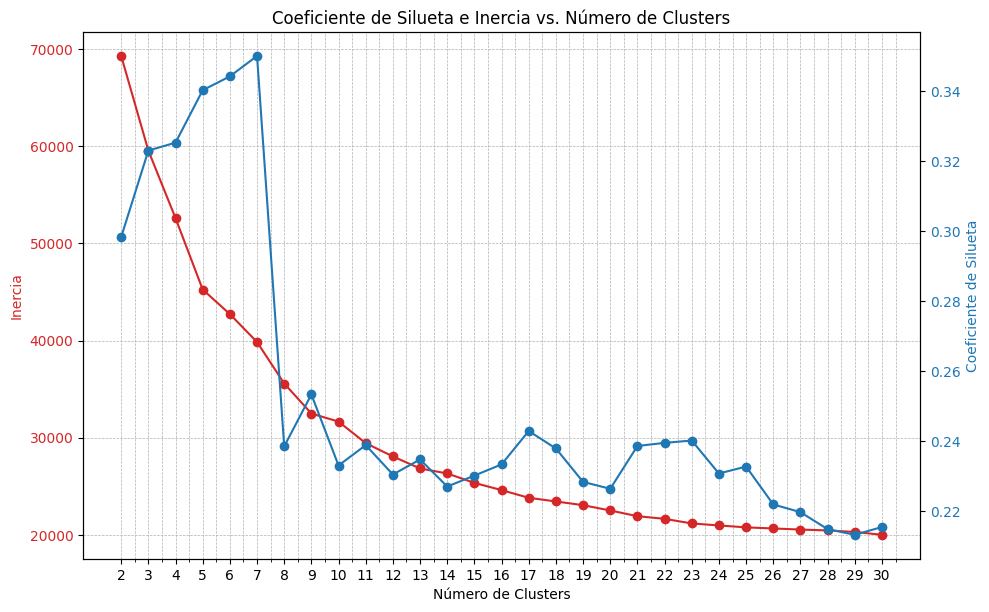

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.preprocessing import StandardScaler

# Configurar el rango de números de clusters a probar
min_clusters = 2
max_clusters = 30

# Listas para almacenar las métricas
num_clusters_list = []
silhouette_scores = []
inertia_scores = []

# Iterar sobre el rango de números de clusters
for num_clusters in range(min_clusters, max_clusters + 1):
  # Inicializar y ajustar el modelo K-means
  kmeans = KMeans(n_clusters=num_clusters, n_init='auto', random_state=42)
  kmeans.fit(X_normalized)

  # Predicciones de clusters y etiquetas
  cluster_labels = kmeans.labels_

  # Calcular la puntuación de silueta
  silhouette_avg = silhouette_score(X_normalized, cluster_labels)

  # Almacenar los resultados
  num_clusters_list.append(num_clusters)
  silhouette_scores.append(silhouette_avg)
  inertia_scores.append(kmeans.inertia_)

# Crear un DataFrame con los resultados
results_df = pd.DataFrame({
  'Número de Clusters': num_clusters_list,
  'Coeficiente de Silueta': silhouette_scores,
  'Inercia': inertia_scores
})

# Imprimir la tabla de resultados (opcional)
#print(results_df)

# Mostrar los resultados en la misma gráfica con dos ejes y colores distintos
fig, ax1 = plt.subplots(figsize=(10, 6))

# Gráfico de la inercia
color = 'tab:red'
ax1.set_xlabel('Número de Clusters')
ax1.set_ylabel('Inercia', color=color)
ax1.plot(num_clusters_list, inertia_scores, marker='o', color=color)
ax1.tick_params(axis='y', labelcolor=color)

# Mejorar el grid del eje X
major_ticks = num_clusters_list
minor_ticks = [i + 0.5 for i in num_clusters_list]

ax1.set_xticks(major_ticks)
ax1.set_xticks(minor_ticks, minor=True)
plt.grid(True, which='both', linestyle='--', linewidth=0.5)

# Crear un segundo eje y para el coeficiente de silueta
ax2 = ax1.twinx()
color = 'tab:blue'
ax2.set_ylabel('Coeficiente de Silueta', color=color)
ax2.plot(num_clusters_list, silhouette_scores, marker='o', color=color)
ax2.tick_params(axis='y', labelcolor=color)

fig.tight_layout()

plt.title('Coeficiente de Silueta e Inercia vs. Número de Clusters')
plt.show()



En la exploración inicial del número de clusters, se ha evaluado el rendimiento del modelo K-means sobre un rango de 2 a 30 clusters, utilizando el coeficiente de silueta y la inercia como métricas clave. Se observó que los valores del coeficiente de silueta tienden a ser más altos entre 3 y 8 clusters, indicando una mejor calidad de los clusters en este rango. Además, aunque la inercia disminuye a medida que se aumentan los clusters, la reducción significativa más allá de 8 clusters no justifica la mayor complejidad del modelo. Por lo tanto, en las siguientes secciones, se trabajará con números de clusters entre 3 y 8 para maximizar la calidad de los clusters y mantener la simplicidad del modelo.

#####K-means

Probaremos a aplicar el algoritmo k-means con número de clusters entre 3 y 8. Y analizaremos tanto los coeficientes de siluetas obtenidos como las visualizaciones de dichos clusters en un espacio pca que reduce las caracteristicas a sus dos principales.

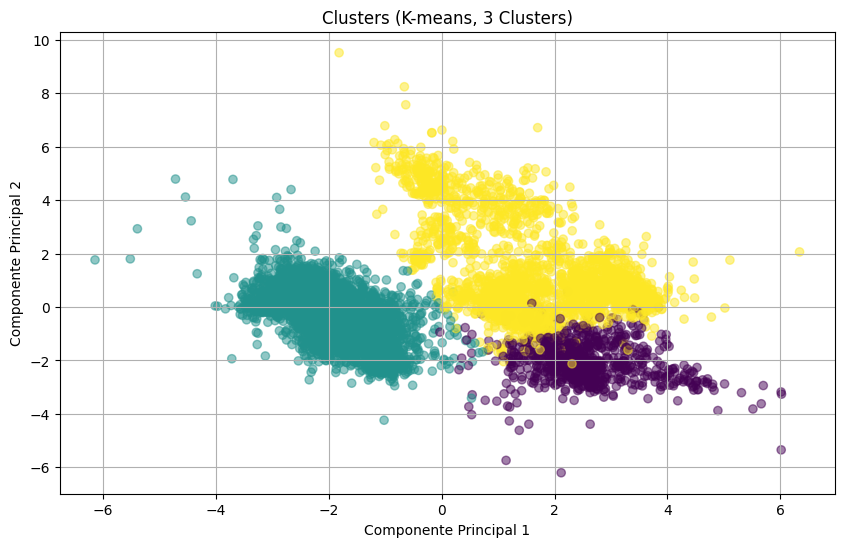

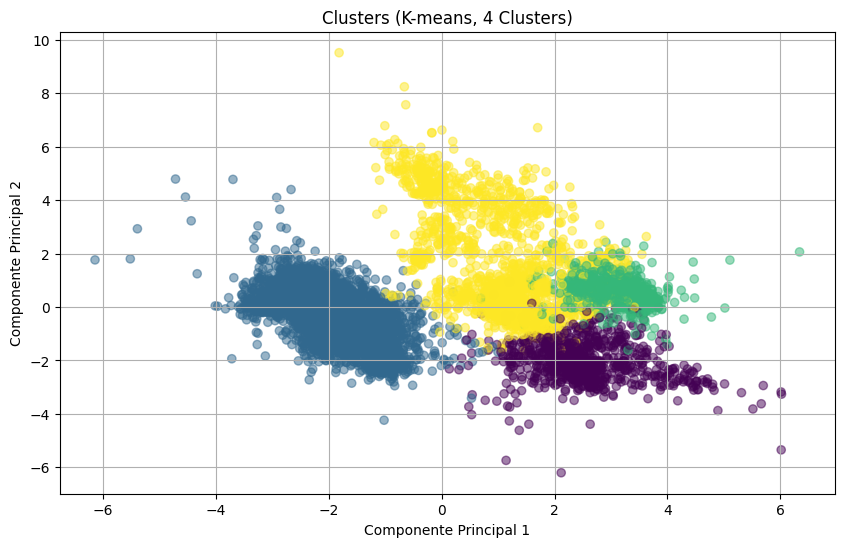

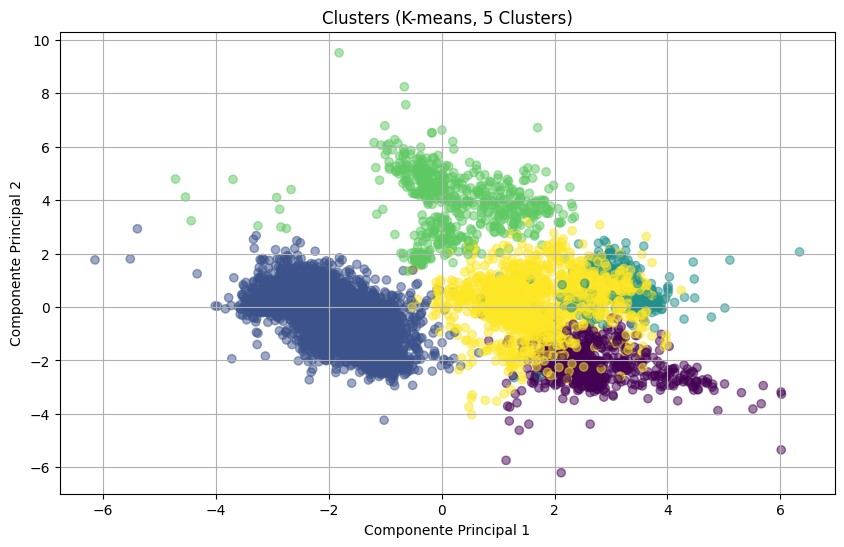

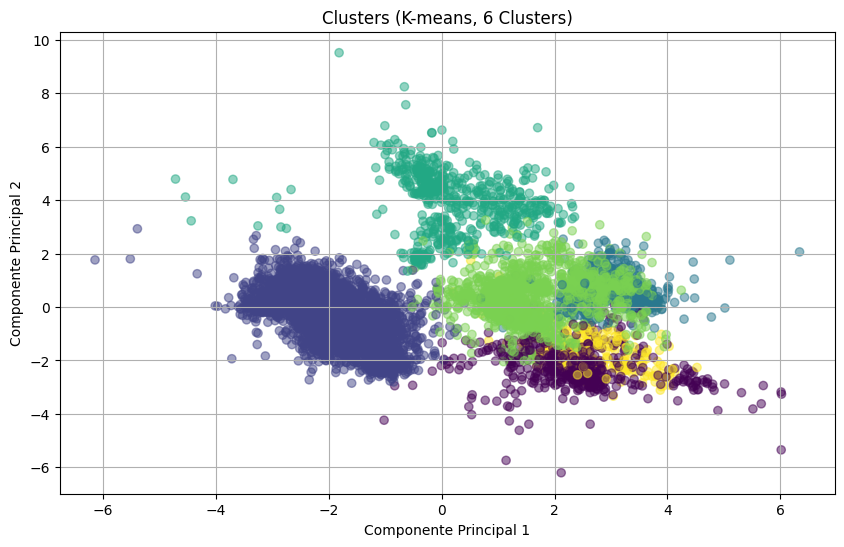

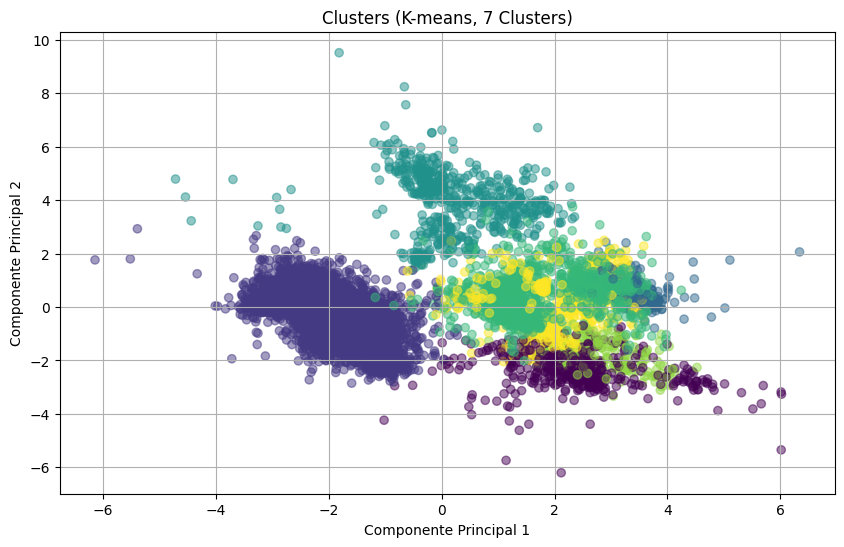

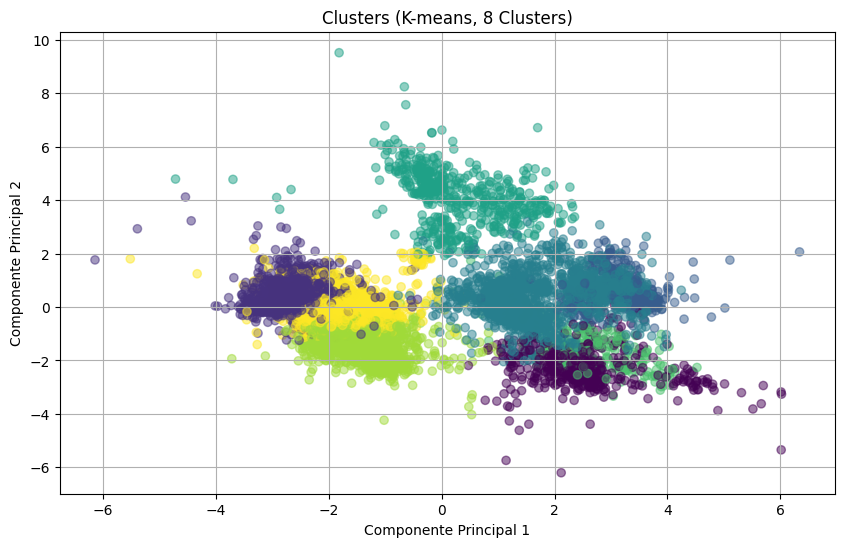

   Número de Clusters  Coeficiente de Silueta
0                   3                0.323001
1                   4                0.325264
2                   5                0.340240
3                   6                0.344192
4                   7                0.350028
5                   8                0.238521


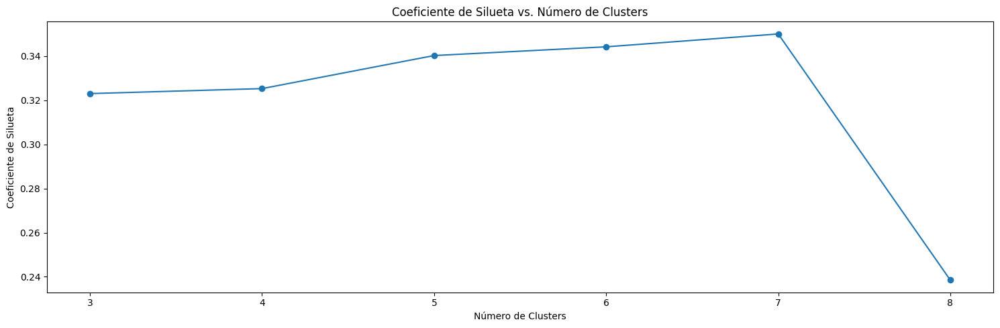

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score, adjusted_rand_score
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

# Configurar el rango de números de clusters a probar
min_clusters = 3
max_clusters = 8

# Listas para almacenar las métricas
num_clusters_list = []
silhouette_scores = []

# Realizar PCA en los datos normalizados
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_normalized)

# Iterar sobre el rango de números de clusters
for num_clusters in range(min_clusters, max_clusters + 1):
    # Inicializar y ajustar el modelo K-means
    kmeans = KMeans(n_clusters=num_clusters, n_init='auto', random_state=42)
    kmeans.fit(X_normalized)

    # Predicciones de clusters y etiquetas
    cluster_labels = kmeans.labels_

    # Visualización de clusters en el espacio PCA
    plt.figure(figsize=(10, 6))
    plt.scatter(X_pca[:, 0], X_pca[:, 1], c=cluster_labels, cmap='viridis', alpha=0.5)
    plt.title('Clusters (K-means, {} Clusters)'.format(num_clusters))
    plt.xlabel('Componente Principal 1')
    plt.ylabel('Componente Principal 2')
    plt.grid(True)
    plt.show()

    # Calcular la puntuación de silueta
    silhouette_avg = silhouette_score(X_normalized, cluster_labels)

    # Almacenar los resultados
    num_clusters_list.append(num_clusters)
    silhouette_scores.append(silhouette_avg)

# Crear un DataFrame con los resultados
results_df = pd.DataFrame({
    'Número de Clusters': num_clusters_list,
    'Coeficiente de Silueta': silhouette_scores,
})

# Imprimir la tabla de resultados
print(results_df)

# Mostrar los resultados en gráficos
plt.figure(figsize=(15, 5))

plt.plot(num_clusters_list, silhouette_scores, marker='o')
plt.title('Coeficiente de Silueta vs. Número de Clusters')
plt.xlabel('Número de Clusters')
plt.ylabel('Coeficiente de Silueta')


plt.tight_layout()
plt.show()


Observamos que en esta primera aproximación, el mejor número de clusters encontrados en función del coeficiente de silueta es 7.

Introduciremos la detección y eliminación de outliers y volveremos a iterar sobre el número de clusters. De esta manera, observaremos como influye la eliminación de los outliers, con diferentes valores de contaminación para el algoritmo Isolation Forest, para el clustering con el mismo modelo.

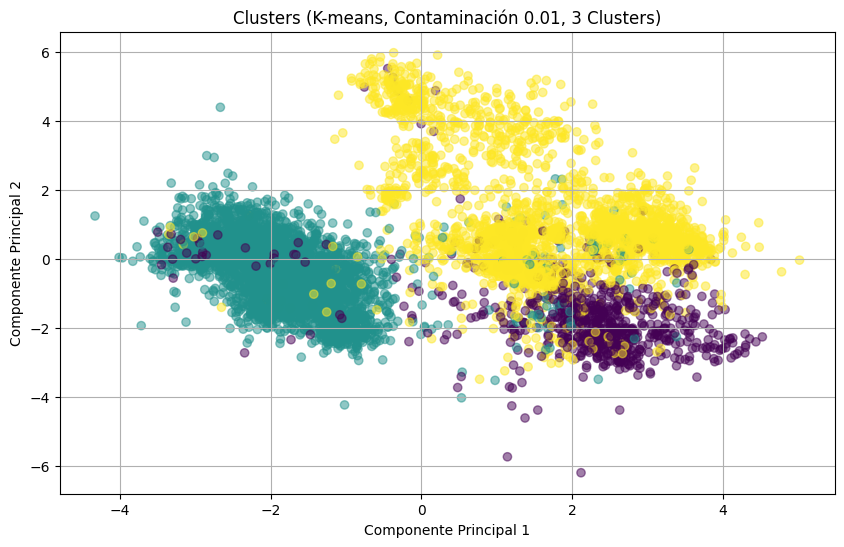

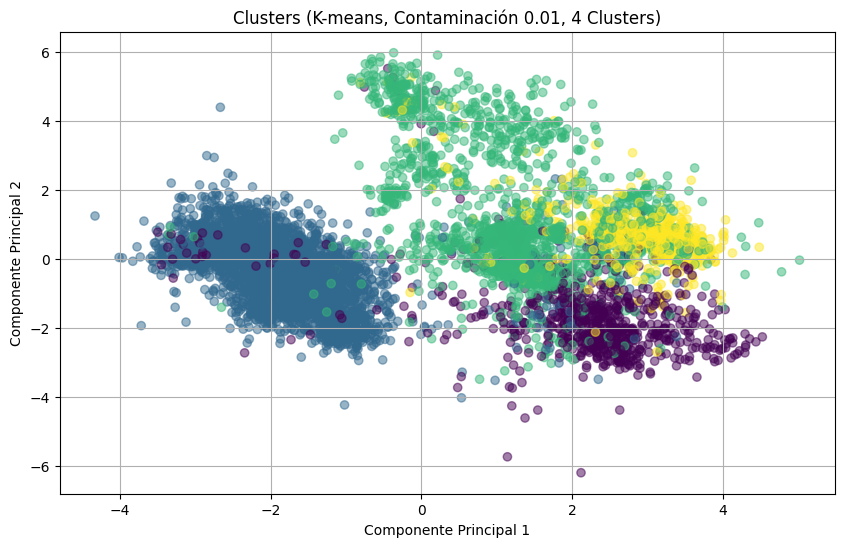

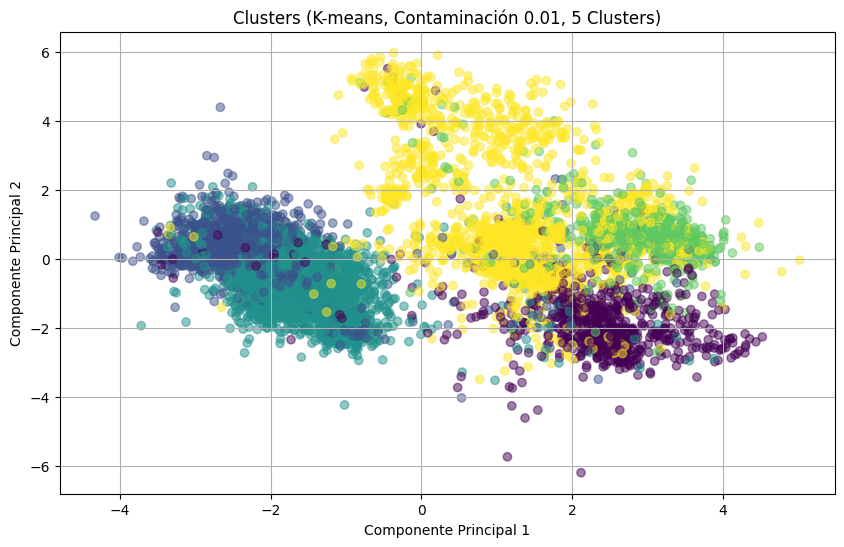

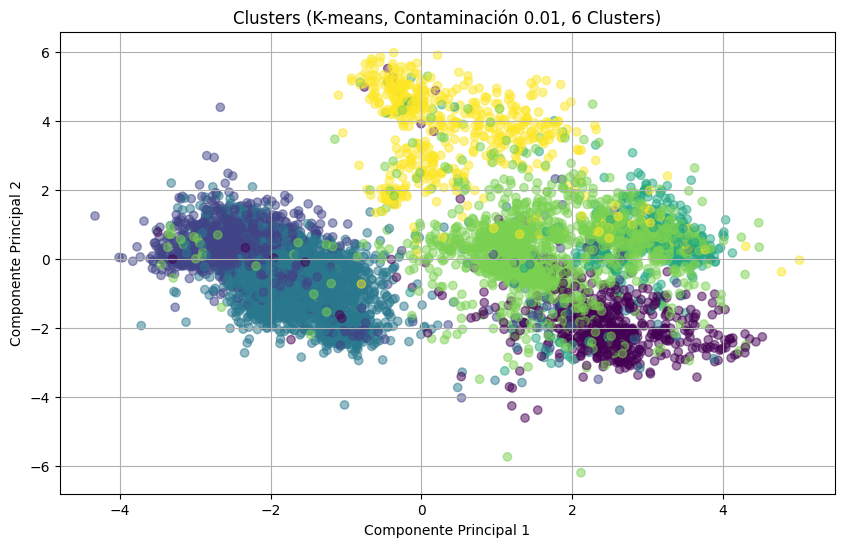

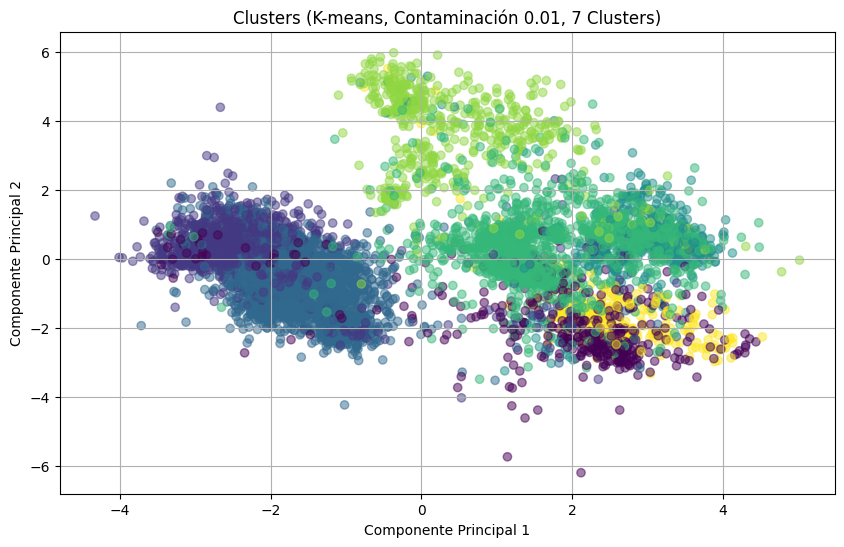

...

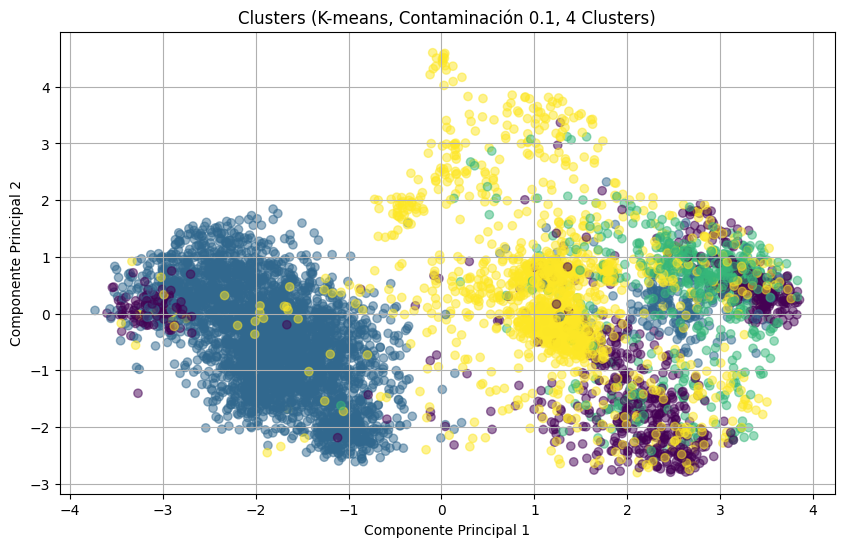

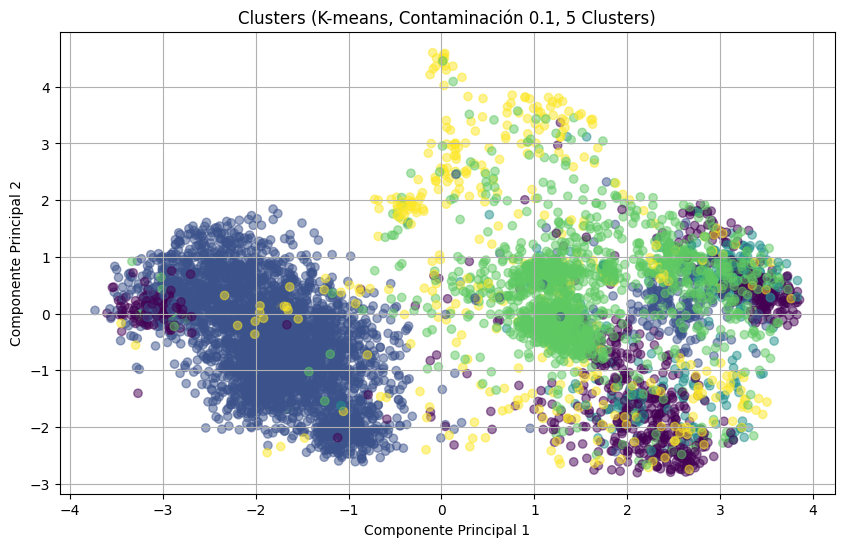

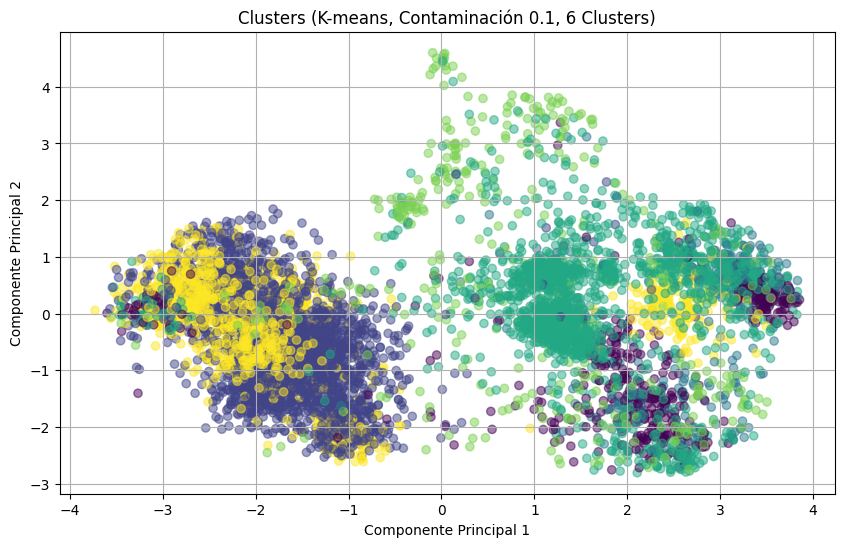

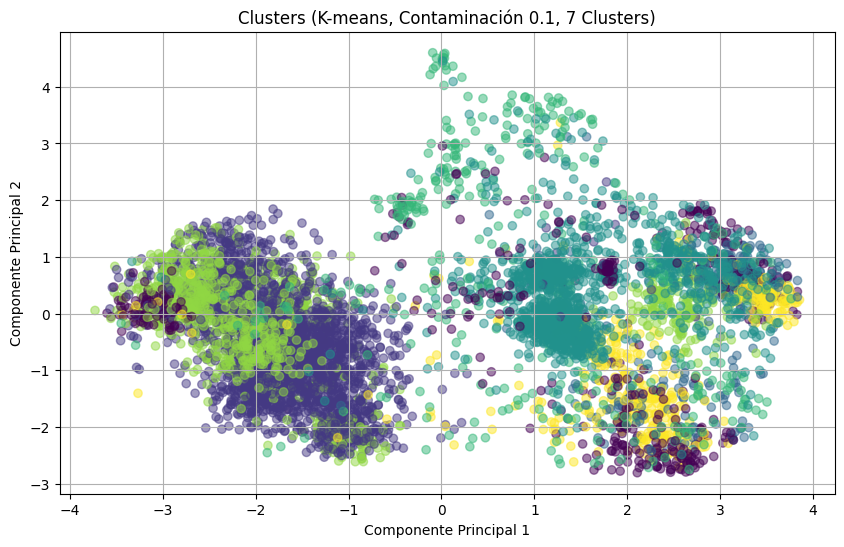

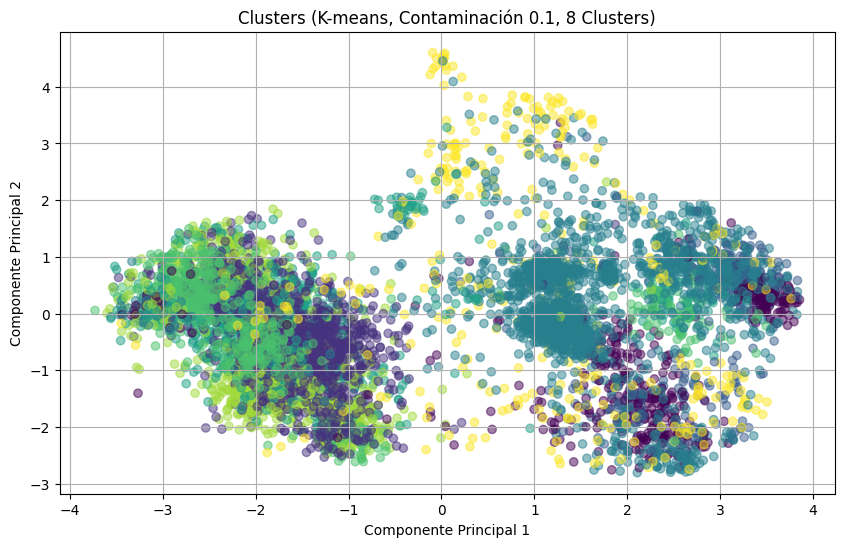

    Contaminación  Número de Clusters  Coeficiente de Silueta
0            0.01                   3                0.326663
1            0.01                   4                0.329079
2            0.01                   5                0.254048
3            0.01                   6                0.284823
4            0.01                   7                0.289854
5            0.01                   8                0.304807
6            0.05                   3                0.318384
7            0.05                   4                0.338329
8            0.05                   5                0.364149
9            0.05                   6                0.303895
10           0.05                   7                0.305288
11           0.05                   8                0.255168
12           0.10                   3                0.334685
13           0.10                   4                0.335317
14           0.10                   5                0.360142
15      

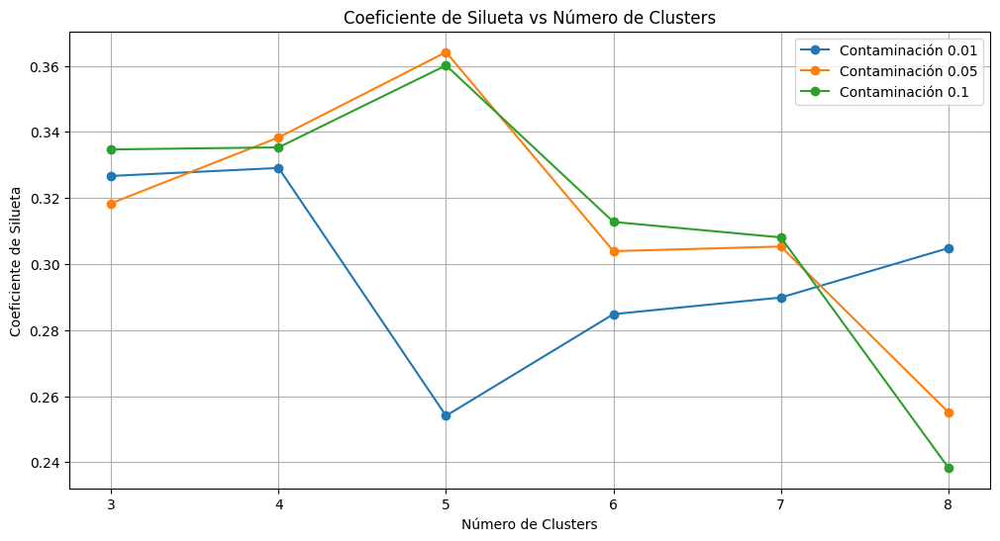

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

# Configurar el rango de números de clusters a probar
min_clusters = 3
max_clusters = 8

# Listas para almacenar las métricas
num_clusters_list = []
silhouette_scores = []

# Configurar PCA
pca = PCA(n_components=2)

# Lista de valores de contaminación a probar
contaminations_to_try = [0.01, 0.05, 0.1]

# Variables para almacenar todas las métricas
all_metrics = []

# Iterar sobre los valores de contaminación
for contamination in contaminations_to_try:
    # Eliminar outliers del conjunto de datos original y reducir su dimensión con PCA
    X_clean = remove_outliers(X_normalized, contamination)
    X_pca_clean = remove_outliers(X_pca, contamination)

    # Convertir el conjunto limpio a un DataFrame de pandas
    X_clean_df = pd.DataFrame(X_clean)

    # Iterar sobre los números de clusters
    for num_clusters in range(min_clusters, max_clusters + 1):
        # Inicializar y ajustar el modelo K-means
        kmeans = KMeans(n_clusters=num_clusters, n_init='auto', algorithm='lloyd', random_state=42)
        cluster_labels = kmeans.fit_predict(X_clean_df)

        # Calcular la puntuación de silueta
        silhouette_avg = silhouette_score(X_clean_df, cluster_labels)

        # Almacenar métricas en listas
        num_clusters_list.append(num_clusters)
        silhouette_scores.append(silhouette_avg)

        # Visualizar los clusters en el espacio PCA sin outliers
        plt.figure(figsize=(10, 6))
        plt.scatter(X_pca_clean[:, 0], X_pca_clean[:, 1], c=cluster_labels, cmap='viridis', alpha=0.5)
        plt.title('Clusters (K-means, Contaminación {}, {} Clusters)'.format(contamination, num_clusters))
        plt.xlabel('Componente Principal 1')
        plt.ylabel('Componente Principal 2')
        plt.grid(True)
        plt.show()

        # Almacenar métricas en una lista
        metrics_dict = {
            'Contaminación': contamination,
            'Número de Clusters': num_clusters,
            'Coeficiente de Silueta': silhouette_avg,
        }
        all_metrics.append(metrics_dict)

# Crear un DataFrame con todas las métricas
metrics_df = pd.DataFrame(all_metrics)

# Mostrar el DataFrame con todas las métricas
print(metrics_df)

# Graficar el coeficiente de silueta
plt.figure(figsize=(12, 6))
for contamination in contaminations_to_try:
    subset = metrics_df[metrics_df['Contaminación'] == contamination]
    plt.plot(subset['Número de Clusters'], subset['Coeficiente de Silueta'], marker='o', label=f'Contaminación {contamination}')

plt.title('Coeficiente de Silueta vs Número de Clusters')
plt.xlabel('Número de Clusters')
plt.ylabel('Coeficiente de Silueta')
plt.legend()
plt.grid(True)
plt.show()




La salida del análisis muestra que la eliminación de outliers mejora ligeramente el rendimiento del clustering con K-means. Esta mejora se observa visualmente en las visualizaciones de los clusters y se confirma cuantitativamente mediante el aumento del coeficiente de silueta. La eliminación de outliers ayuda a obtener clusters más compactos y bien definidos, lo cual se traduce en un mejor coeficiente de silueta.

Al comparar diferentes porcentajes de outliers eliminados (0.01, 0.05, 0.1), observamos que la eliminación del 5% de outliers es la más efectiva. Este porcentaje consigue una mejor separación de los clusters, reflejada en un coeficiente de silueta más alto, sin eliminar demasiadas instancias del conjunto de datos. Es un equilibrio óptimo entre la eliminación de ruido y la retención de datos relevantes.

Es interesante notar que con la eliminación del 5% de outliers, el coeficiente de silueta se maximiza con un número de clusters igual a 5. Sin embargo, sin eliminar outliers, este número era 7. Esto puede ocurrir porque los outliers pueden distorsionar la estructura subyacente de los datos, haciendo que K-means divida los datos en más clusters para intentar capturar esta variabilidad extra. Al eliminar estos puntos atípicos, la estructura intrínseca de los datos se vuelve más clara, permitiendo una mejor identificación de un número menor de clusters más representativos.

#####Gaussian Mixture Model (GMM)

(sin eliminación de outliers)

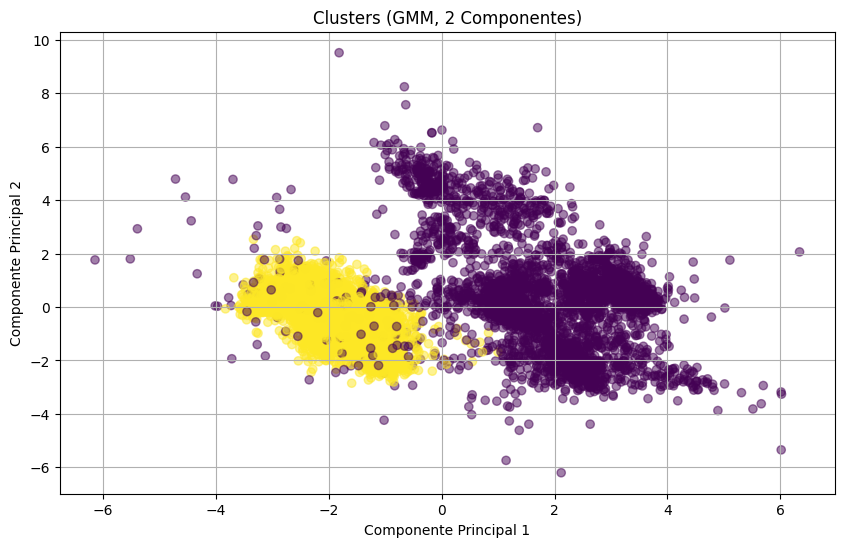

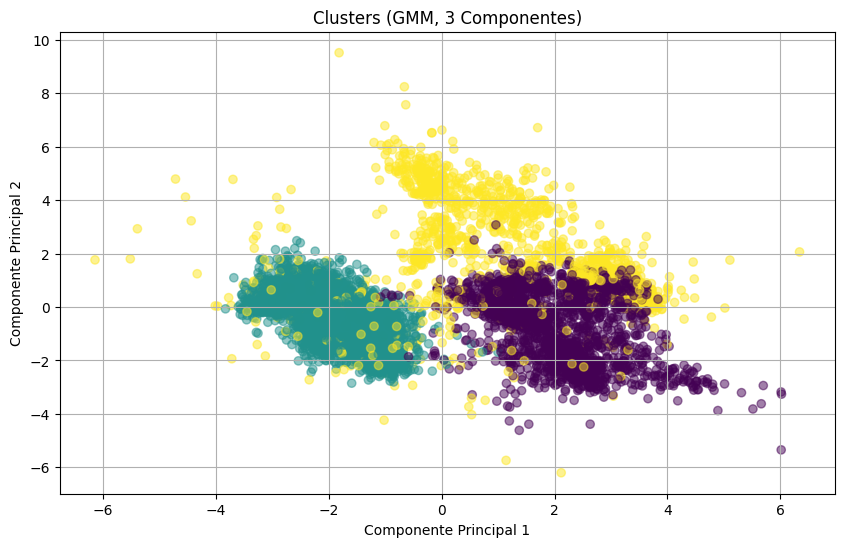

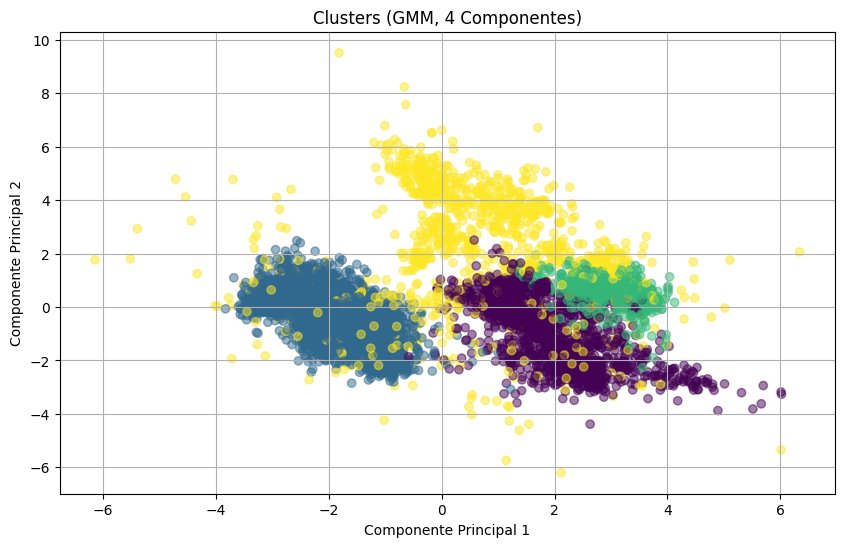

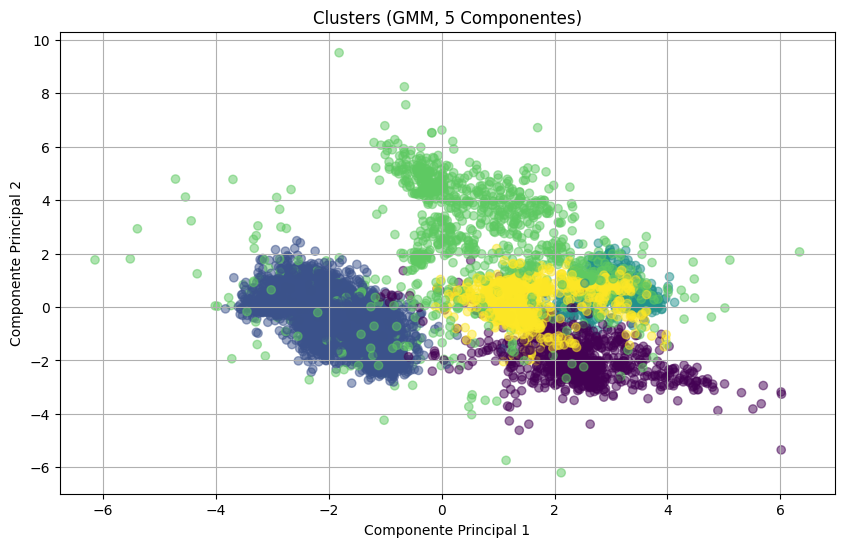

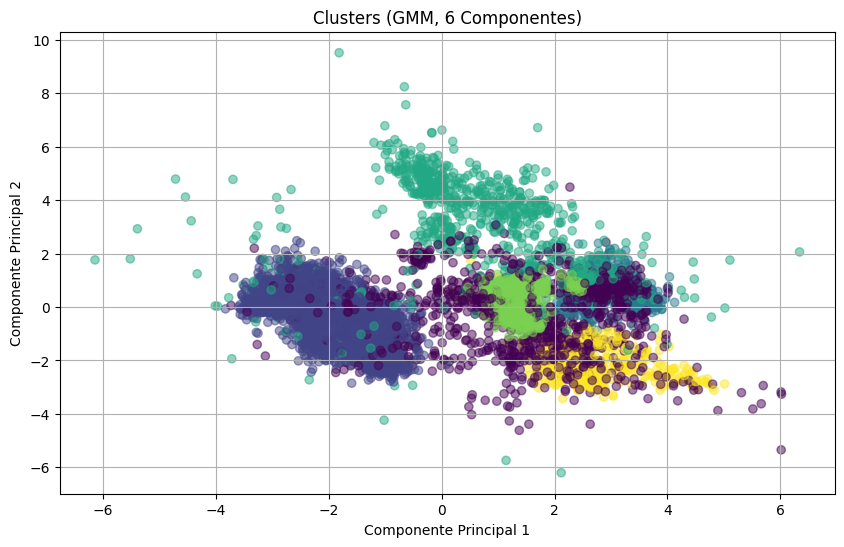

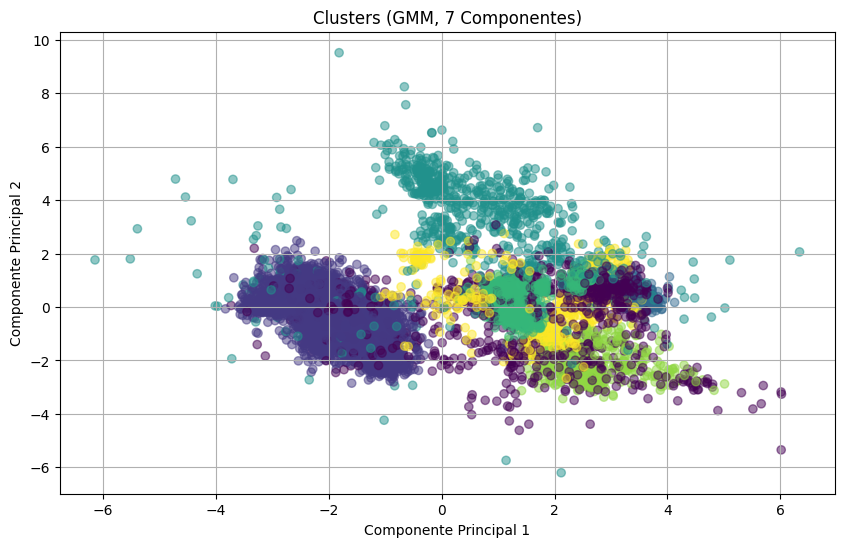

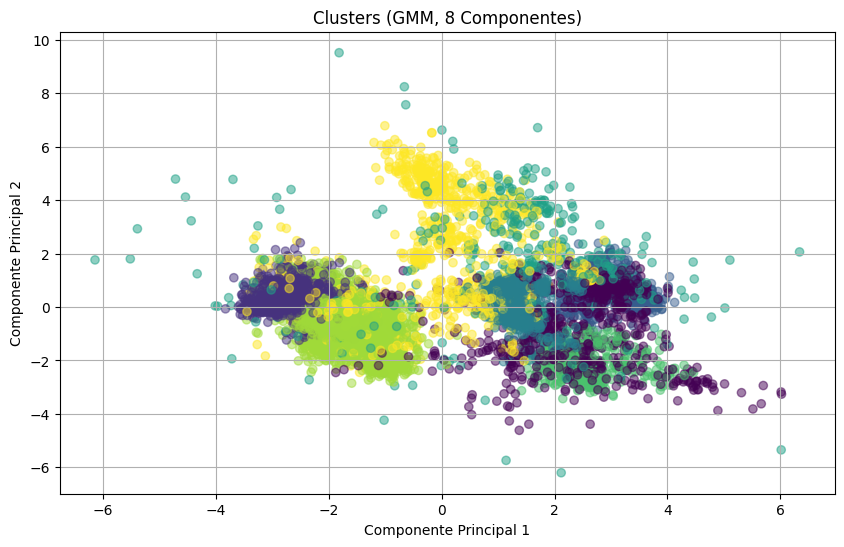

   Número de Componentes  Coeficiente de Silueta
0                      2                0.277838
1                      3                0.287783
2                      4                0.303207
3                      5                0.273312
4                      6                0.226103
5                      7                0.245270
6                      8                0.191659


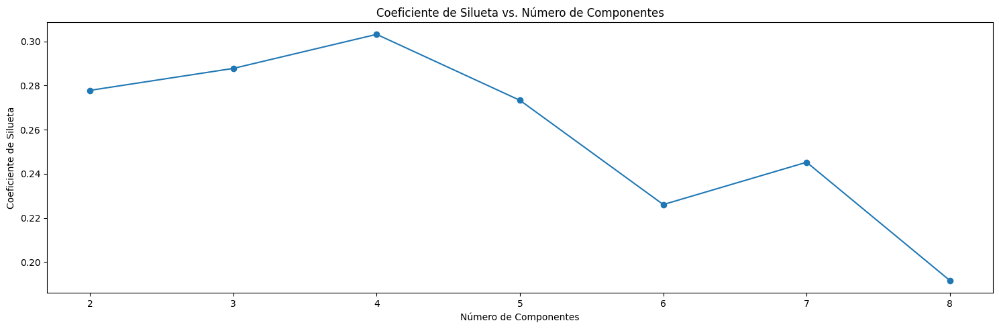

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.mixture import GaussianMixture
from sklearn.metrics import silhouette_score, adjusted_rand_score
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler


# Lista para almacenar las métricas
num_clusters_list = []
silhouette_scores = []

# Realizar PCA en los datos normalizados
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_normalized)

# Configurar el rango de números de componentes a probar
min_components = 2
max_components = 8

# Iterar sobre el rango de números de componentes
for num_components in range(min_components, max_components + 1):
    # Inicializar y ajustar el modelo GMM
    gmm = GaussianMixture(n_components=num_components, init_params="kmeans", random_state=42)
    gmm.fit(X_normalized)

    # Predicciones de clusters y etiquetas
    cluster_labels = gmm.predict(X_normalized)

    # Calcular la puntuación de silueta
    silhouette_avg = silhouette_score(X_normalized, cluster_labels)

    # Almacenar los resultados
    num_clusters_list.append(num_components)
    silhouette_scores.append(silhouette_avg)

    # Visualizar los clusters en el espacio PCA
    plt.figure(figsize=(10, 6))
    plt.scatter(X_pca[:, 0], X_pca[:, 1], c=cluster_labels, cmap='viridis', alpha=0.5)
    plt.title('Clusters (GMM, {} Componentes)'.format(num_components))
    plt.xlabel('Componente Principal 1')
    plt.ylabel('Componente Principal 2')
    plt.grid(True)
    plt.show()

# Crear un DataFrame con los resultados
results_df = pd.DataFrame({
    'Número de Componentes': num_clusters_list,
    'Coeficiente de Silueta': silhouette_scores,
})

# Imprimir la tabla de resultados
print(results_df)

# Mostrar los resultados en gráficos
plt.figure(figsize=(15, 5))

plt.plot(num_clusters_list, silhouette_scores, marker='o')
plt.title('Coeficiente de Silueta vs. Número de Componentes')
plt.xlabel('Número de Componentes')
plt.ylabel('Coeficiente de Silueta')


plt.tight_layout()
plt.show()


(con eliminación de outliers)

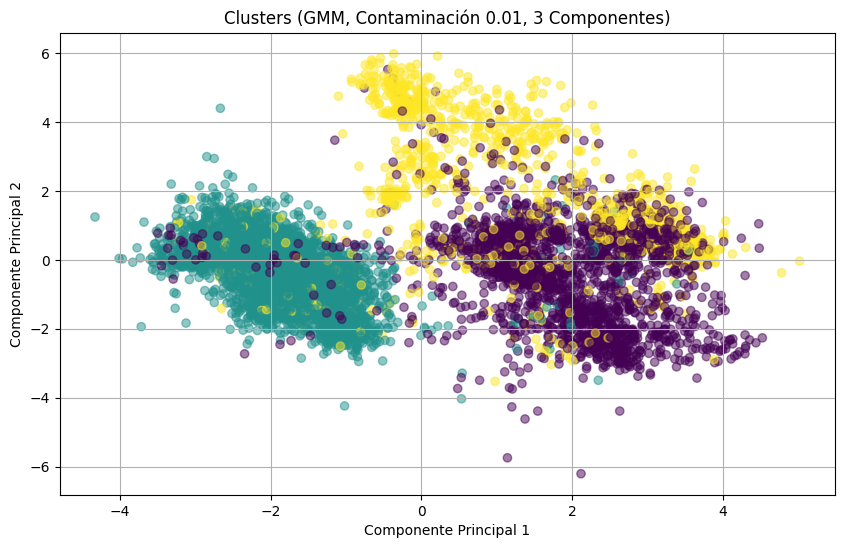

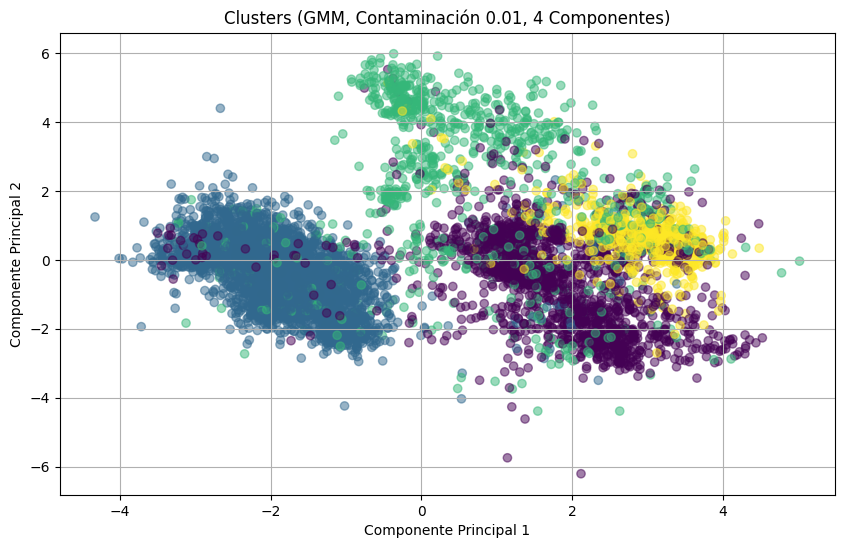

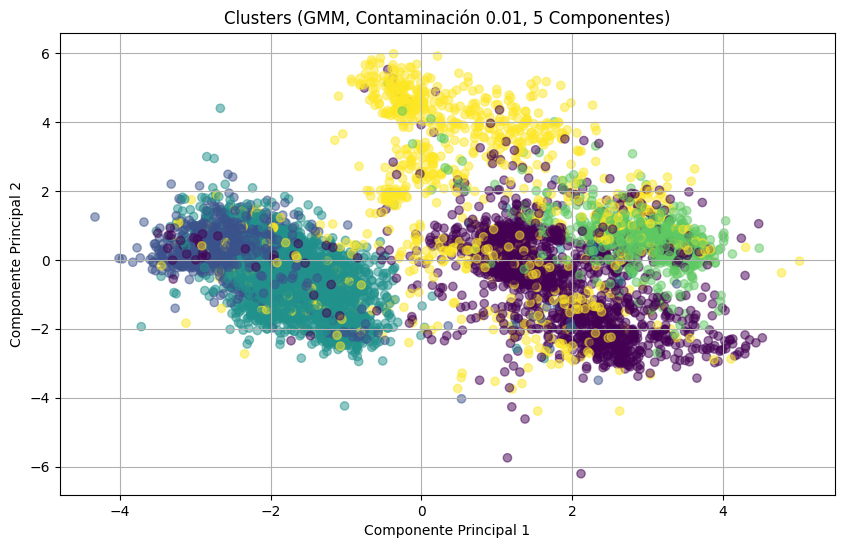

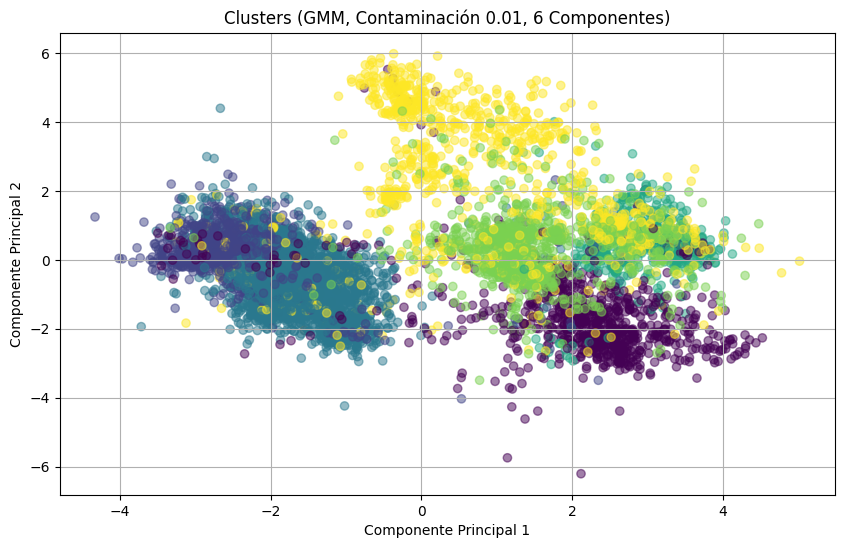

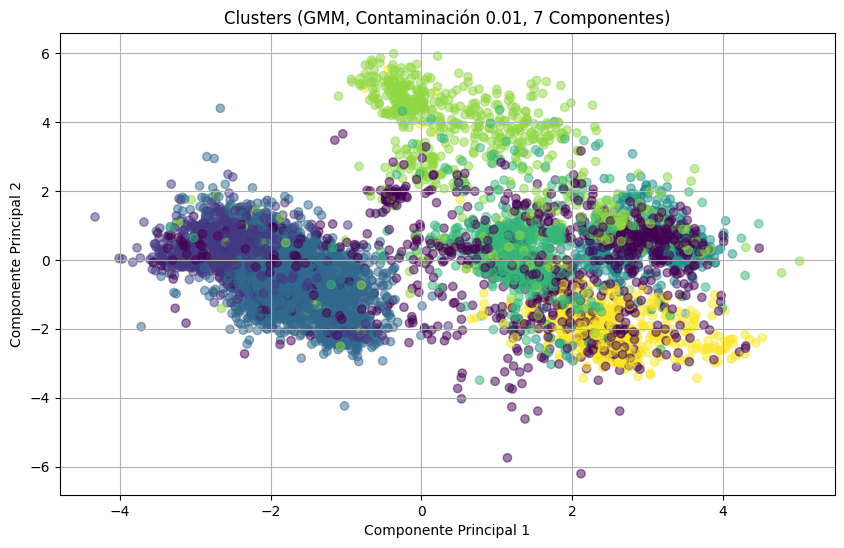

...

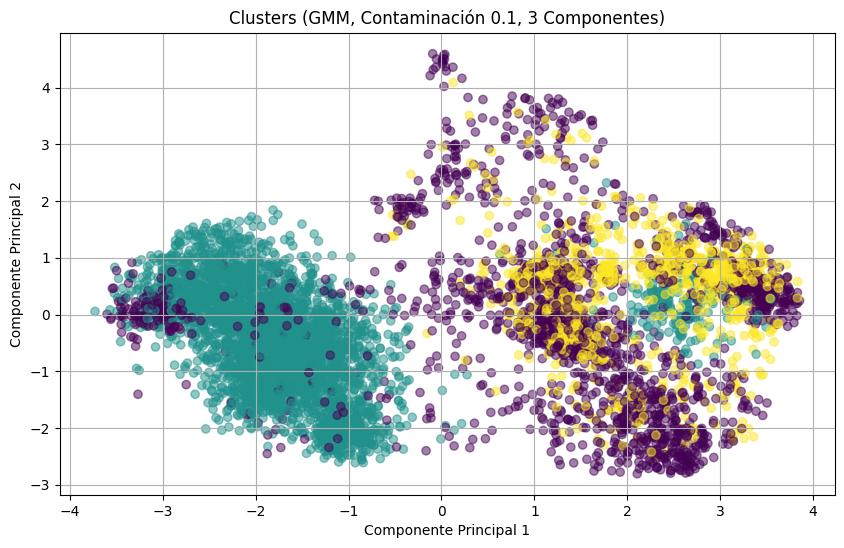

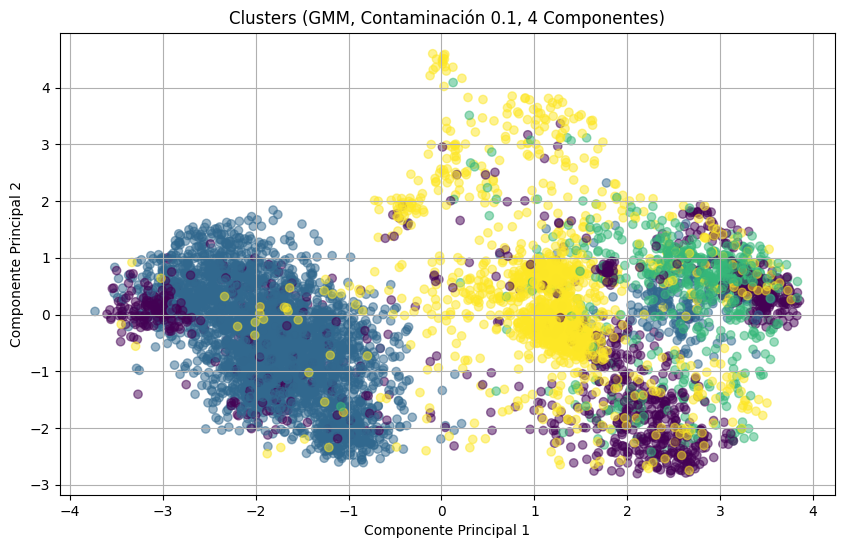

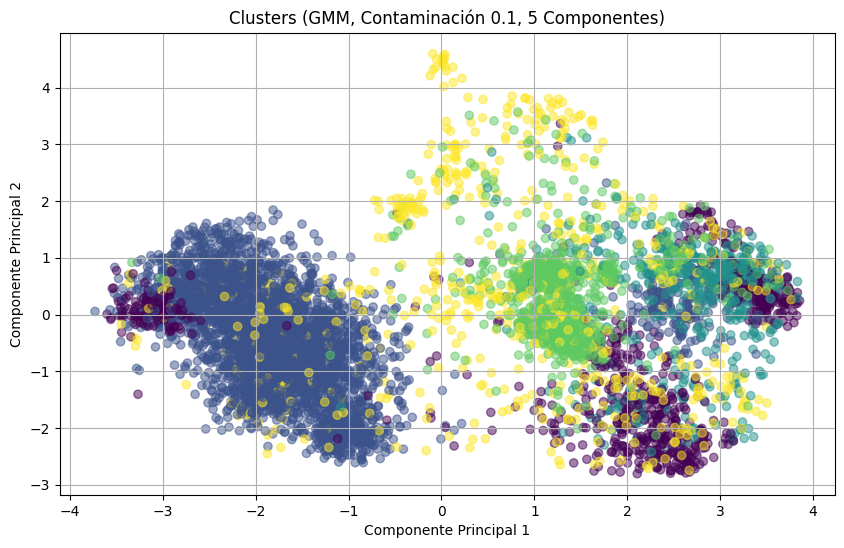

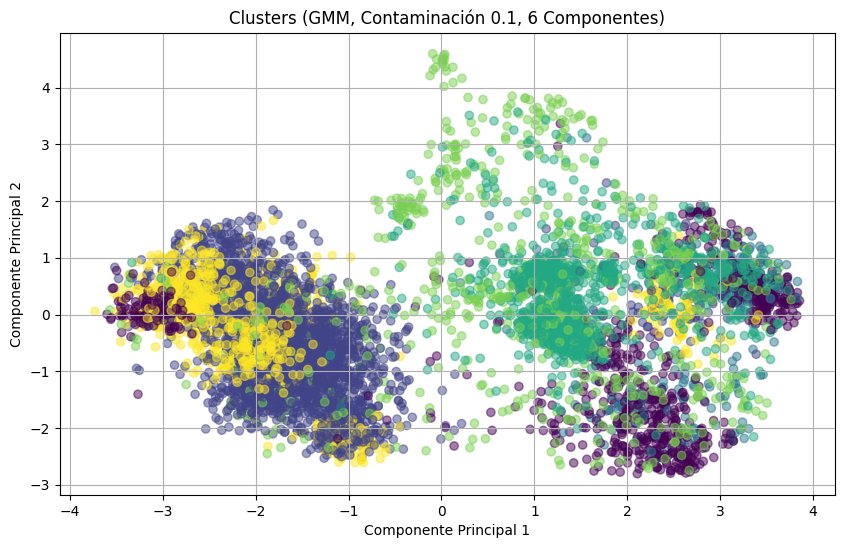

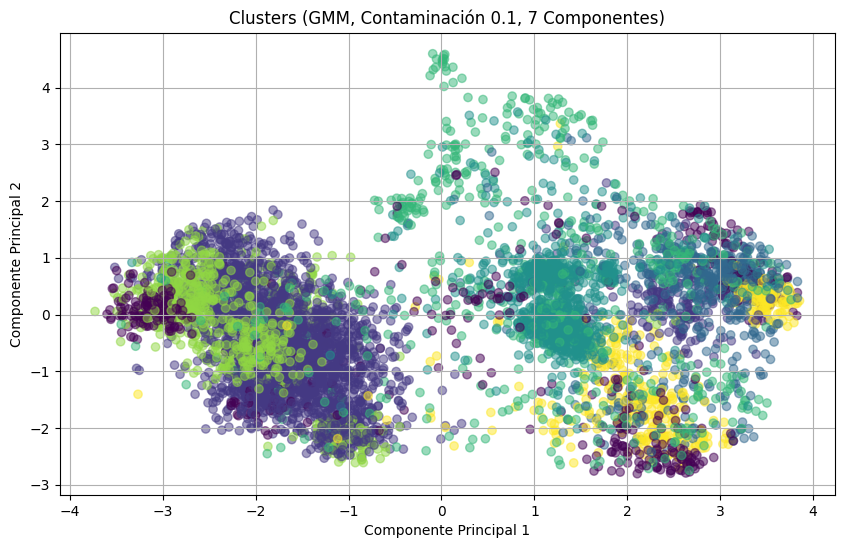

    Contaminación  Número de Componentes  Coeficiente de Silueta
0            0.01                      3                0.293978
1            0.01                      4                0.309453
2            0.01                      5                0.214329
3            0.01                      6                0.220092
4            0.01                      7                0.201214
5            0.05                      3                0.306581
6            0.05                      4                0.279629
7            0.05                      5                0.298316
8            0.05                      6                0.240081
9            0.05                      7                0.224201
10           0.10                      3                0.294845
11           0.10                      4                0.302317
12           0.10                      5                0.275360
13           0.10                      6                0.248416
14           0.10        

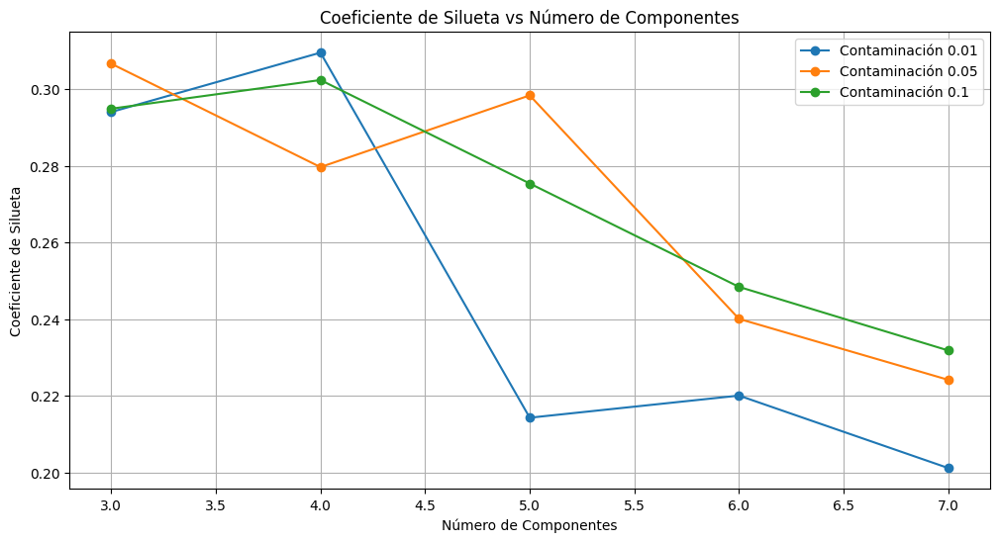

In [ ]:
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.mixture import GaussianMixture
from sklearn.metrics import silhouette_score, adjusted_rand_score
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler

# Configurar el rango de números de componentes a probar
min_components = 3
max_components = 7

# Listas para almacenar las métricas
num_components_list = []
silhouette_scores = []

# Configurar PCA
pca = PCA(n_components=2)

# Lista de valores de contaminación a probar
contaminations_to_try = [0.01, 0.05, 0.1]

# Variables para almacenar todas las métricas
all_metrics = []

# Iterar sobre los valores de contaminación
for contamination in contaminations_to_try:
    # Eliminar outliers del conjunto de datos original y reducir su dimensión con PCA
    X_clean = remove_outliers(X_normalized, contamination)
    X_pca_clean = remove_outliers(X_pca, contamination)

    # Convertir el conjunto limpio a un DataFrame de pandas
    X_clean_df = pd.DataFrame(X_clean)

    # Iterar sobre los números de componentes
    for num_components in range(min_components, max_components + 1):
        # Inicializar y ajustar el modelo GMM
        gmm = GaussianMixture(n_components=num_components, random_state=42)
        cluster_labels = gmm.fit_predict(X_clean_df)

        # Calcular la puntuación de silueta
        silhouette_avg = silhouette_score(X_clean_df, cluster_labels)

        # Almacenar métricas en listas
        num_components_list.append(num_components)
        silhouette_scores.append(silhouette_avg)

        # Visualizar los clusters en el espacio PCA sin outliers
        plt.figure(figsize=(10, 6))
        plt.scatter(X_pca_clean[:, 0], X_pca_clean[:, 1], c=cluster_labels, cmap='viridis', alpha=0.5)
        plt.title('Clusters (GMM, Contaminación {}, {} Componentes)'.format(contamination, num_components))
        plt.xlabel('Componente Principal 1')
        plt.ylabel('Componente Principal 2')
        plt.grid(True)
        plt.show()

        # Almacenar métricas en una lista
        metrics_dict = {
            'Contaminación': contamination,
            'Número de Componentes': num_components,
            'Coeficiente de Silueta': silhouette_avg,
        }
        all_metrics.append(metrics_dict)

# Crear un DataFrame con todas las métricas
metrics_df = pd.DataFrame(all_metrics)

# Mostrar el DataFrame con todas las métricas
print(metrics_df)

# Graficar el coeficiente de silueta
plt.figure(figsize=(12, 6))
for contamination in contaminations_to_try:
    subset = metrics_df[metrics_df['Contaminación'] == contamination]
    plt.plot(subset['Número de Componentes'], subset['Coeficiente de Silueta'], marker='o', label=f'Contaminación {contamination}')

plt.title('Coeficiente de Silueta vs Número de Componentes')
plt.xlabel('Número de Componentes')
plt.ylabel('Coeficiente de Silueta')
plt.legend()
plt.grid(True)
plt.show()




En la salida observamos que, de nuevo, la eliminación de outliers mejora el rendimiento del modelo GMM respecto al modelo ejecutado sin eliminación de outliers. Vemos que, para los diferentes valores de contaminación, el coeficiente de silueta está más igualado entre la eliminación del 10% y el 5% de outliers. El modelo GMM ejecutado con la eliminación del 10% de outliers y 5 componentes es el que maximiza el coeficiente de silueta, pero solo ligeramente por delante del modelo GMM ejecutado con la eliminación del 5% de outliers y 3 componentes.

Esto puede deberse a que, al eliminar una mayor proporción de outliers, se obtiene una mayor pureza en los datos, lo que mejora la definición de los clusters. Sin embargo, eliminar un 10% de los datos puede ser excesivo y llevar a la pérdida de información relevante, lo que explica la diferencia marginal en la mejora del coeficiente de silueta.

Por lo tanto, se elige finalmente el modelo con la eliminación del 5% de outliers y 3 componentes, ya que consigue buenos resultados, aunque no máximos, sin quitar demasiadas instancias del conjunto de datos original. Este enfoque ofrece un equilibrio adecuado entre la calidad del clustering y la conservación de la mayor cantidad posible de datos.

#####Agglomerative Hierarchical Clustering

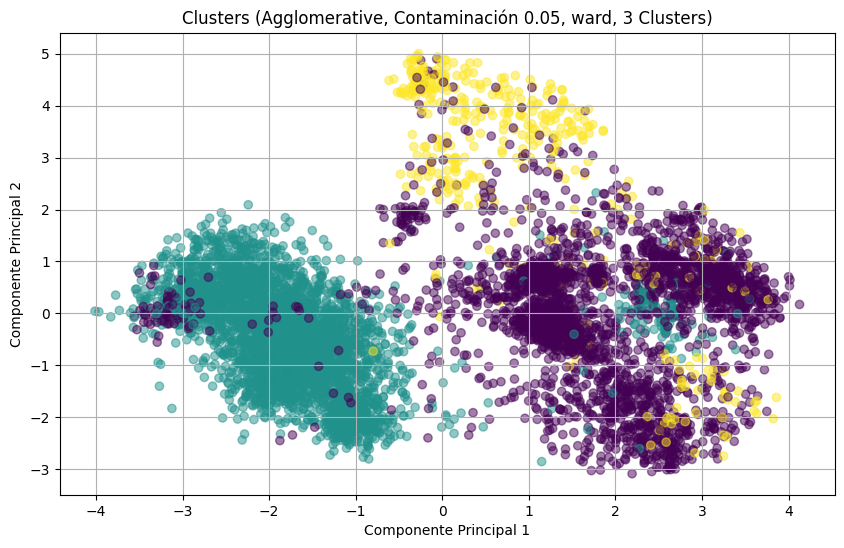

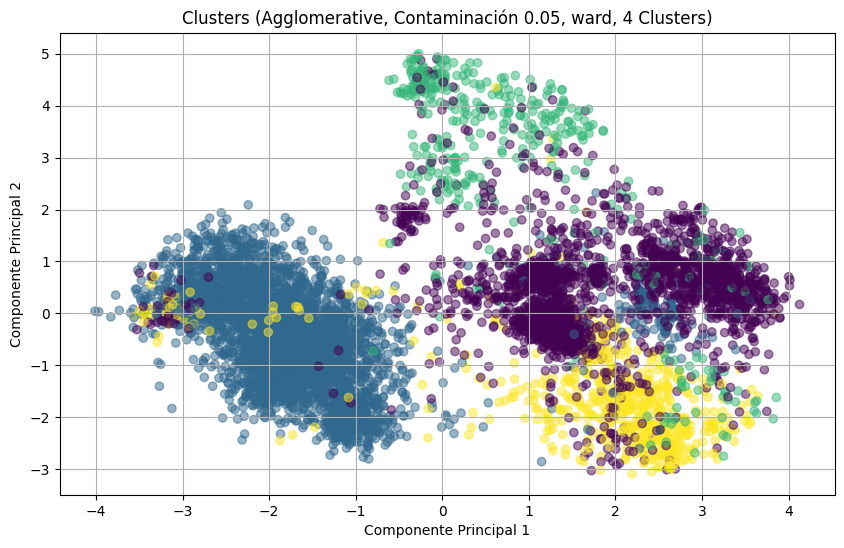

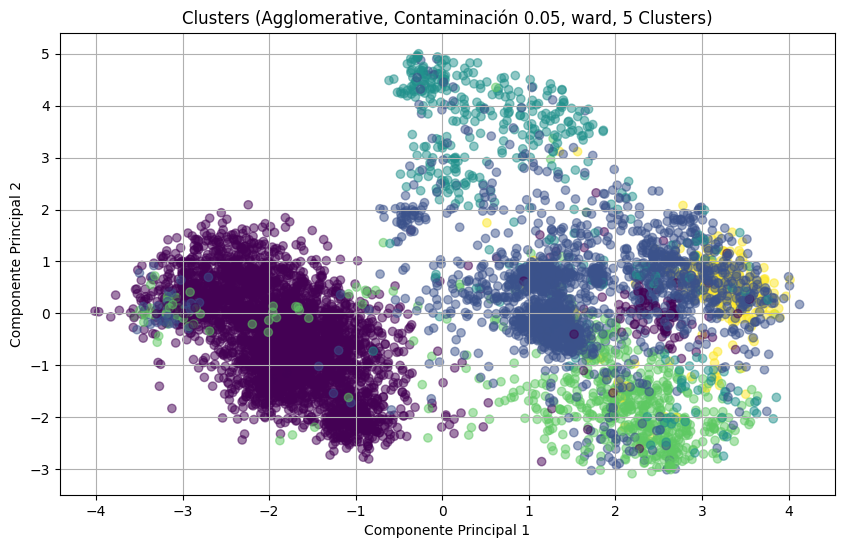

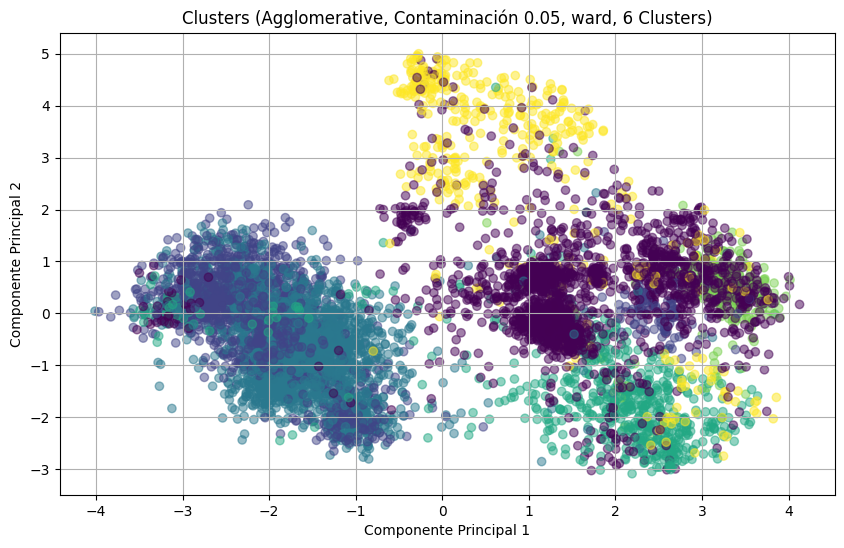

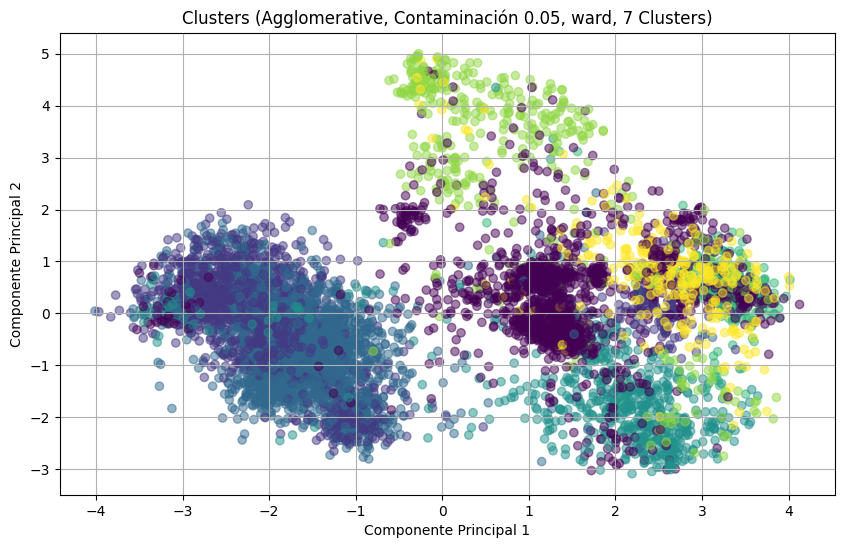

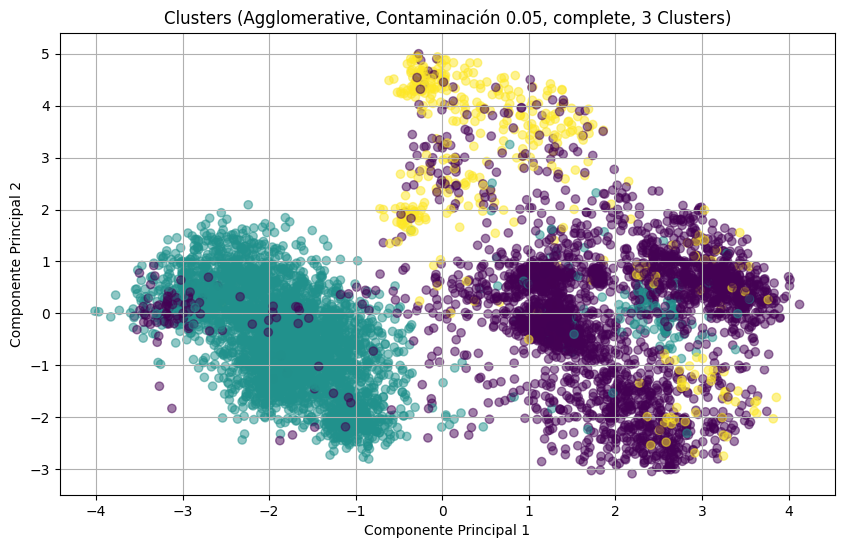

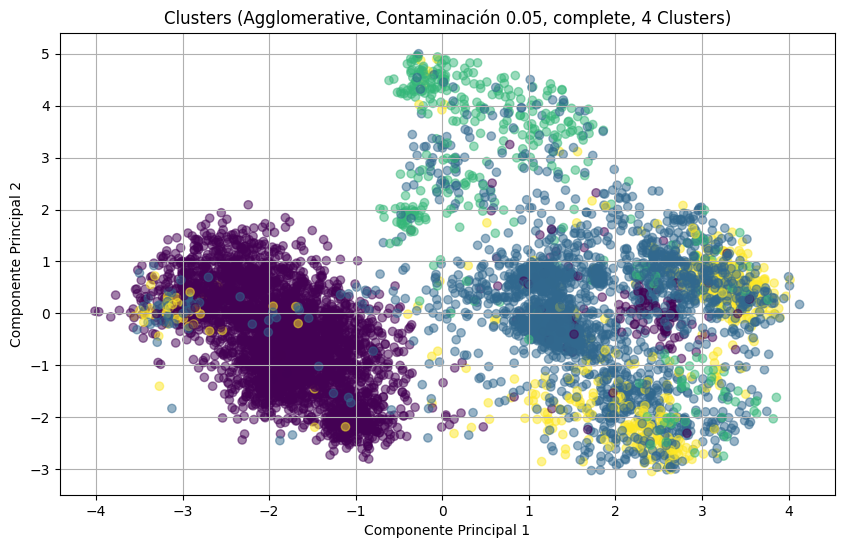

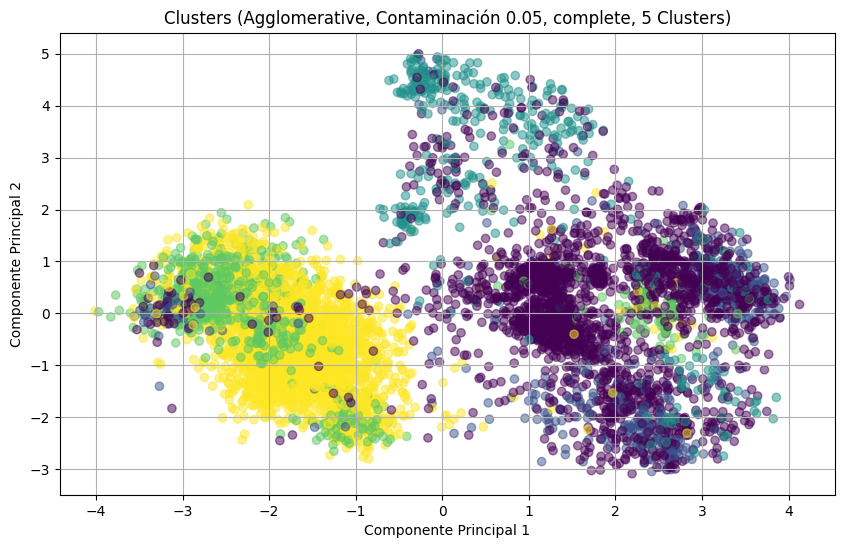

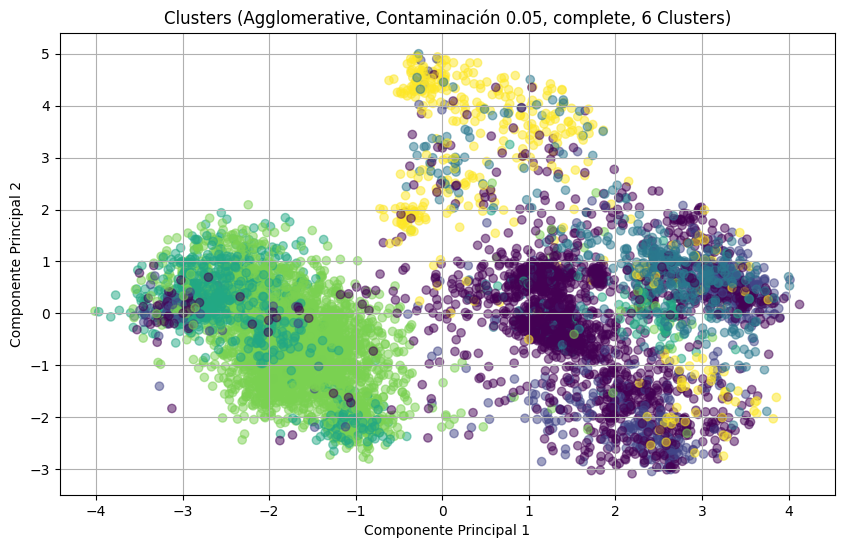

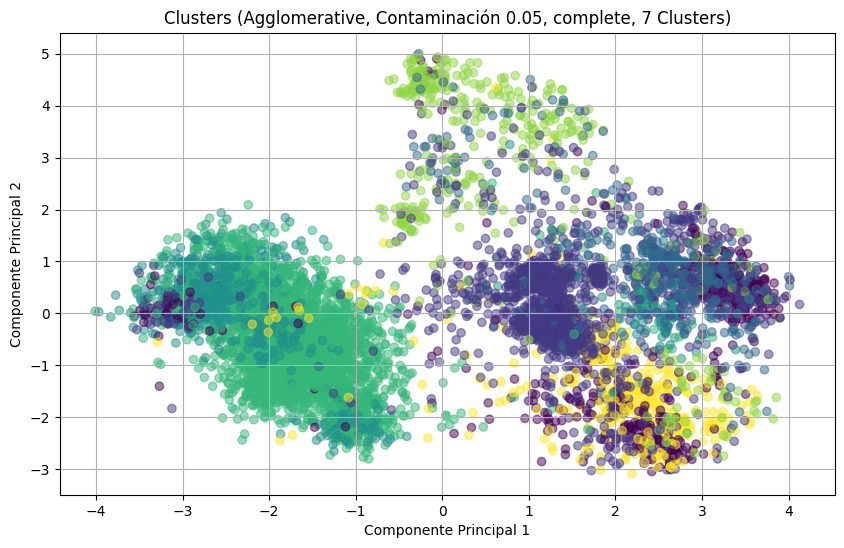

   Número de Clusters   Linkage  Coeficiente de Silueta
0                   3      ward                0.348785
1                   4      ward                0.357556
2                   5      ward                0.359483
3                   6      ward                0.278258
4                   7      ward                0.289188
5                   3  complete                0.339738
6                   4  complete                0.328651
7                   5  complete                0.249759
8                   6  complete                0.258952
9                   7  complete                0.276970


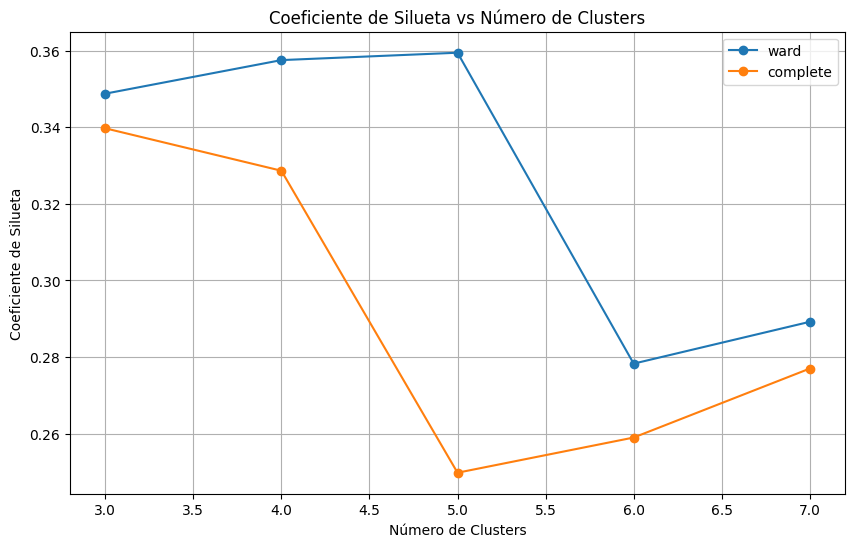

In [ ]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from sklearn.cluster import AgglomerativeClustering
from sklearn.metrics import silhouette_score, adjusted_rand_score
from sklearn.decomposition import PCA


# Configurar el rango de números de clusters a probar
min_clusters = 3
max_clusters = 7

# Valor de contaminación fijo
contamination = 0.05

# Lista de métodos de enlace a probar
linkage_methods = ["ward", "complete"]

# Listas para almacenar las métricas
num_clusters_list = []
linkage_list = []
silhouette_scores = []

# Configurar PCA
pca = PCA(n_components=2)

# Eliminar outliers del conjunto de datos original y reducir su dimensión con PCA
X_clean = remove_outliers(X_normalized, contamination)
X_pca_clean = remove_outliers(X_pca, contamination)

# Convertir el conjunto limpio a un DataFrame de pandas
X_clean_df = pd.DataFrame(X_clean)


# Iterar sobre los métodos de enlace
for linkage in linkage_methods:
    # Iterar sobre los números de clusters
    for num_clusters in range(min_clusters, max_clusters + 1):
        # Inicializar y ajustar el modelo AgglomerativeClustering
        agglomerative = AgglomerativeClustering(n_clusters=num_clusters, linkage=linkage)
        agglomerative.fit(X_clean_df)

        # Predicciones de clusters y etiquetas
        cluster_labels = agglomerative.labels_

        # Calcular la puntuación de silueta
        silhouette_avg = silhouette_score(X_clean_df, cluster_labels)

        # Almacenar métricas en listas
        num_clusters_list.append(num_clusters)
        linkage_list.append(linkage)
        silhouette_scores.append(silhouette_avg)

        # Visualización de clusters en el espacio PCA
        plt.figure(figsize=(10, 6))
        plt.scatter(X_pca_clean[:, 0], X_pca_clean[:, 1], c=cluster_labels, cmap='viridis', alpha=0.5)
        plt.title(f'Clusters (Agglomerative, Contaminación {contamination}, {linkage}, {num_clusters} Clusters)')
        plt.xlabel('Componente Principal 1')
        plt.ylabel('Componente Principal 2')
        plt.grid(True)
        plt.show()

# Crear un DataFrame con las métricas
metrics_df = pd.DataFrame({
    'Número de Clusters': num_clusters_list,
    'Linkage': linkage_list,
    'Coeficiente de Silueta': silhouette_scores,
})

# Mostrar el DataFrame con las métricas
print(metrics_df)

# Graficar el coeficiente de silueta
plt.figure(figsize=(10, 6))
for linkage in linkage_methods:
    subset = metrics_df[metrics_df['Linkage'] == linkage]
    plt.plot(subset['Número de Clusters'], subset['Coeficiente de Silueta'], marker='o', label=linkage)

plt.title('Coeficiente de Silueta vs Número de Clusters')
plt.xlabel('Número de Clusters')
plt.ylabel('Coeficiente de Silueta')
plt.legend()
plt.grid(True)
plt.show()



Como se ha demostrado que la eliminación de outliers, y en concreto, del 5% de los outliers, es beneficioso para nuestro problema, en este caso se ha decidido directamente probar el modelo con esta configuración y buscar la optimización sobre los parámetros de este modelo (Agglomerative Clustering). Se observa que el método de enlace "ward" es consistentemente superior respecto al "complete" en todos los casos. Esto se debe a que el método "ward" minimiza la varianza dentro de los clusters, lo que suele producir clusters más compactos y bien definidos. Por último, se observa que para este modelo, el número de clusters que parece óptimo, a juzgar por el coeficiente de silueta, es 5.

#####Análisis y Comparación de los modelos finales y evaluación con respecto a las etiquetas reales.

KMeans:
Coeficiente de Silueta: 0.3641490971536843
ARI - Family: 0.534643720453201
ARI - Genus: 0.618872725283496
ARI - Species: 0.8310305991753495
ARI - RecordID: 0.1396608572735922

GaussianMixture:
Coeficiente de Silueta: 0.3065805421167321
ARI - Family: 0.4854264845180467
ARI - Genus: 0.5405823065785635
ARI - Species: 0.7368251547515945
ARI - RecordID: 0.11854173615610684

AgglomerativeClustering:
Coeficiente de Silueta: 0.35948260793033454
ARI - Family: 0.5313956713146485
ARI - Genus: 0.6233102125109753
ARI - Species: 0.8337015629029018
ARI - RecordID: 0.1405864736785686



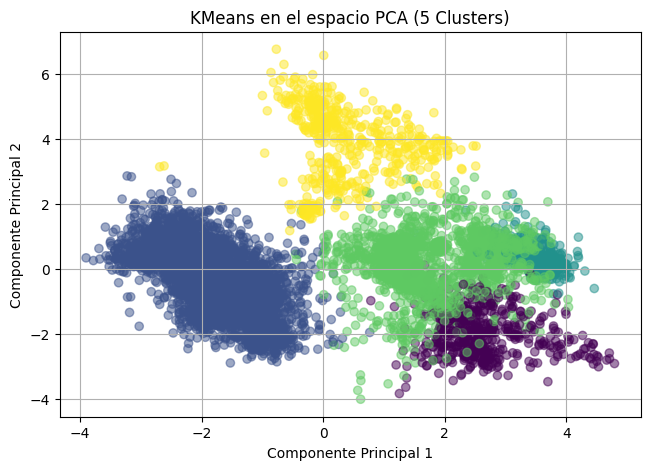

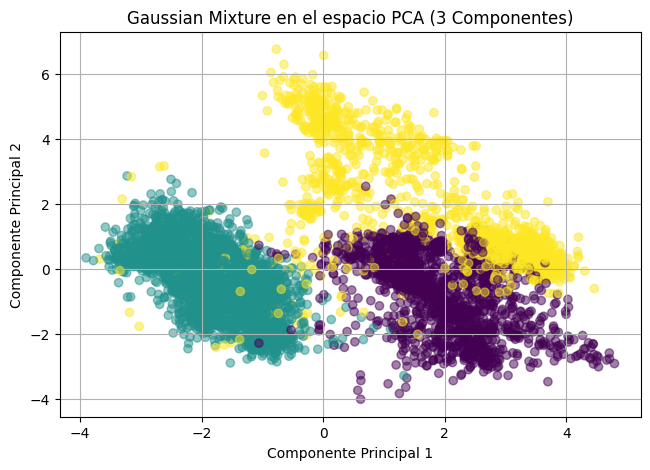

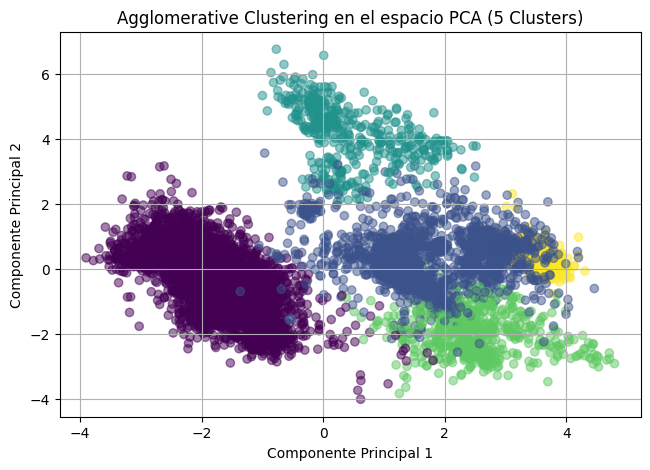

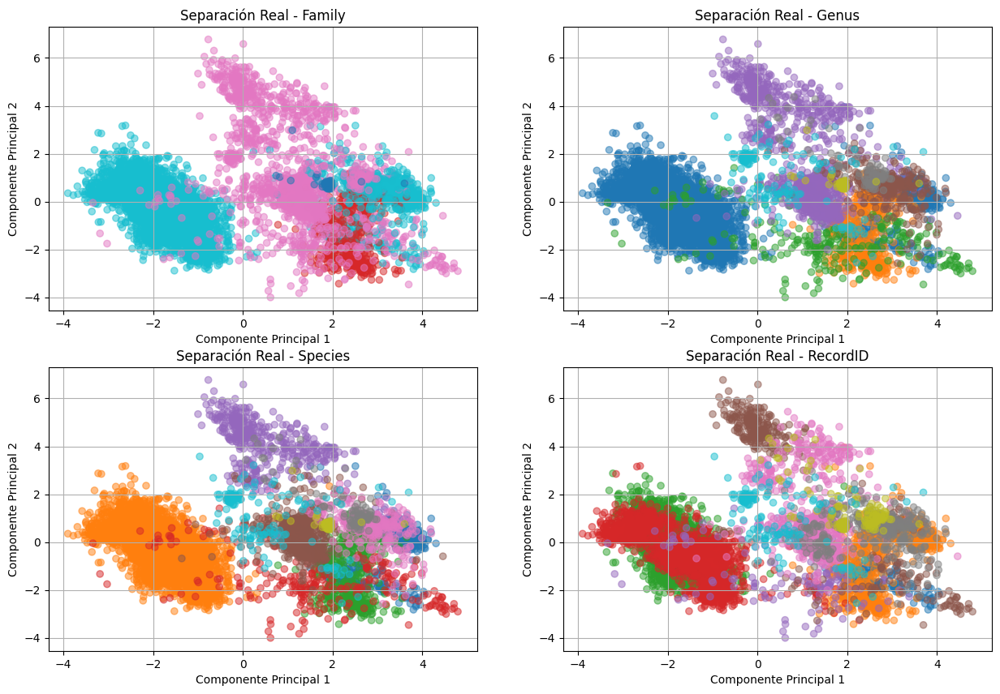

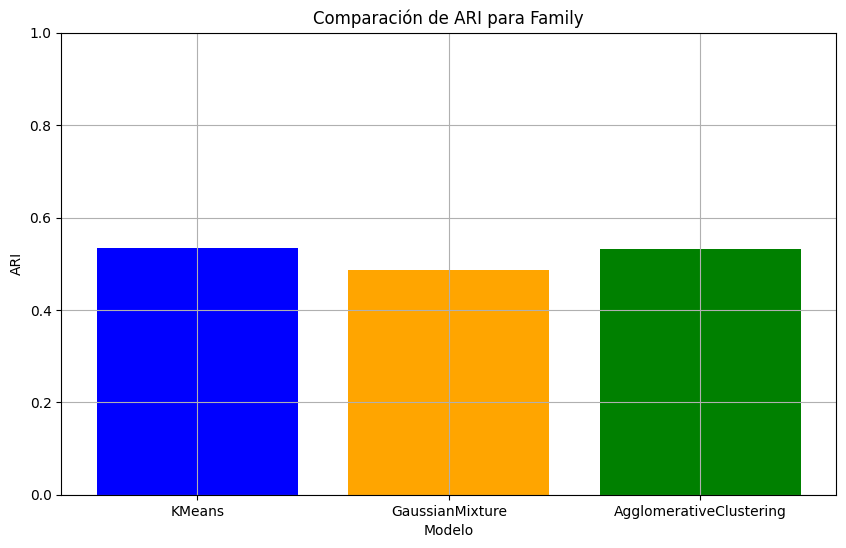

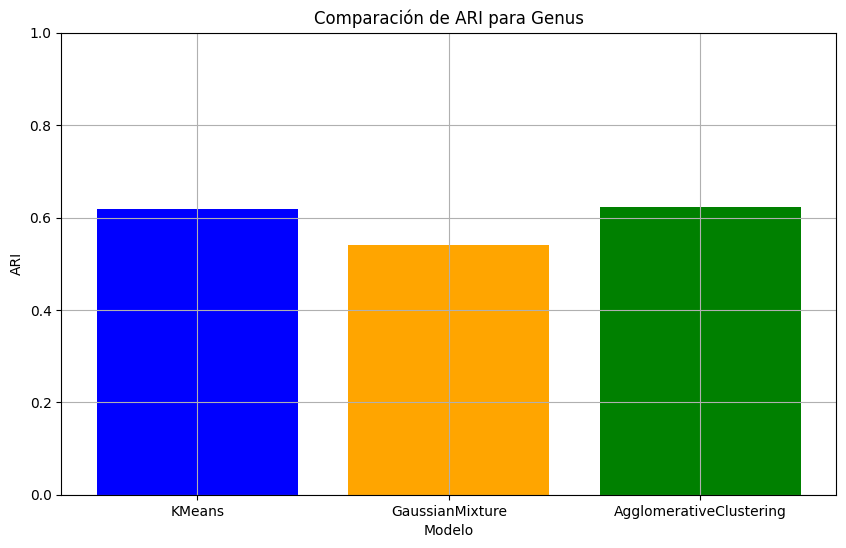

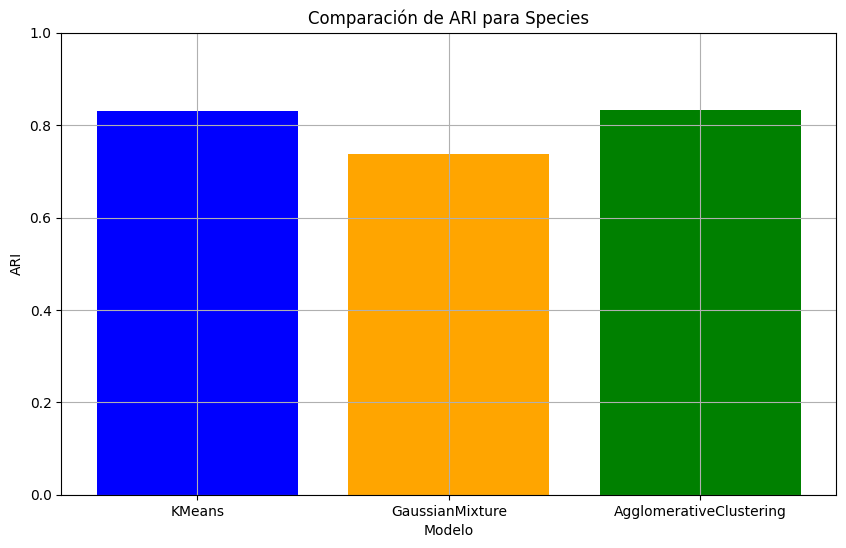

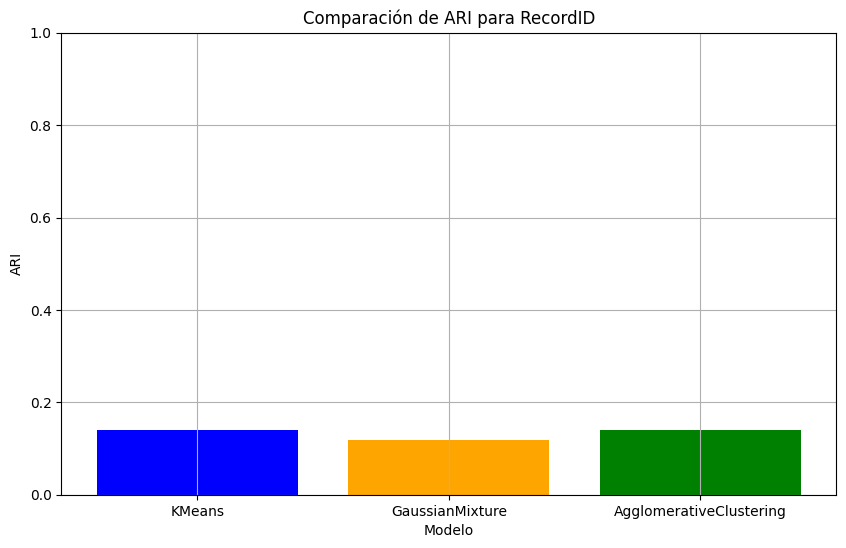

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from sklearn.metrics import silhouette_score, adjusted_rand_score
from sklearn.decomposition import PCA
from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans, AgglomerativeClustering
from sklearn.mixture import GaussianMixture


# Definir las etiquetas verdaderas
true_labels_family = df_frogs['Family']
true_labels_genus = df_frogs['Genus']
true_labels_species = df_frogs['Species']
true_labels_record_id = df_frogs['RecordID']

# Filtrar las etiquetas verdaderas utilizando los índices de las filas eliminadas
def filter_labels(labels, outlier_indices):
    mask = np.ones(len(labels), dtype=bool)
    mask[outlier_indices] = False
    return labels[mask]

outliers_df = detect_outliers(X_normalized, contamination=0.05)
outlier_indices = outliers_df.index

true_labels_family = filter_labels(true_labels_family.values, outlier_indices)
true_labels_genus = filter_labels(true_labels_genus.values, outlier_indices)
true_labels_species = filter_labels(true_labels_species.values, outlier_indices)
true_labels_record_id = filter_labels(true_labels_record_id.values, outlier_indices)

# KMeans Model
kmeans = KMeans(n_clusters=5, n_init='auto', algorithm='lloyd', random_state=42)
cluster_labels_kmeans = kmeans.fit_predict(X_clean)
silhouette_avg_kmeans = silhouette_score(X_clean, cluster_labels_kmeans)
ari_family_kmeans = adjusted_rand_score(true_labels_family, cluster_labels_kmeans)
ari_genus_kmeans = adjusted_rand_score(true_labels_genus, cluster_labels_kmeans)
ari_species_kmeans = adjusted_rand_score(true_labels_species, cluster_labels_kmeans)
ari_record_id_kmeans = adjusted_rand_score(true_labels_record_id, cluster_labels_kmeans)

# GaussianMixture Model
gmm = GaussianMixture(n_components=3, random_state=42)
cluster_labels_gmm = gmm.fit_predict(X_clean)
silhouette_avg_gmm = silhouette_score(X_clean, cluster_labels_gmm)
ari_family_gmm = adjusted_rand_score(true_labels_family, cluster_labels_gmm)
ari_genus_gmm = adjusted_rand_score(true_labels_genus, cluster_labels_gmm)
ari_species_gmm = adjusted_rand_score(true_labels_species, cluster_labels_gmm)
ari_record_id_gmm = adjusted_rand_score(true_labels_record_id, cluster_labels_gmm)

# AgglomerativeClustering Model
agglomerative = AgglomerativeClustering(n_clusters=5, linkage='ward')
cluster_labels_agg = agglomerative.fit_predict(X_clean)
silhouette_avg_agg = silhouette_score(X_clean, cluster_labels_agg)
ari_family_agg = adjusted_rand_score(true_labels_family, cluster_labels_agg)
ari_genus_agg = adjusted_rand_score(true_labels_genus, cluster_labels_agg)
ari_species_agg = adjusted_rand_score(true_labels_species, cluster_labels_agg)
ari_record_id_agg = adjusted_rand_score(true_labels_record_id, cluster_labels_agg)

# Imprimir métricas
print("KMeans:")
print("Coeficiente de Silueta:", silhouette_avg_kmeans)
print("ARI - Family:", ari_family_kmeans)
print("ARI - Genus:", ari_genus_kmeans)
print("ARI - Species:", ari_species_kmeans)
print("ARI - RecordID:", ari_record_id_kmeans)
print()

print("GaussianMixture:")
print("Coeficiente de Silueta:", silhouette_avg_gmm)
print("ARI - Family:", ari_family_gmm)
print("ARI - Genus:", ari_genus_gmm)
print("ARI - Species:", ari_species_gmm)
print("ARI - RecordID:", ari_record_id_gmm)
print()

print("AgglomerativeClustering:")
print("Coeficiente de Silueta:", silhouette_avg_agg)
print("ARI - Family:", ari_family_agg)
print("ARI - Genus:", ari_genus_agg)
print("ARI - Species:", ari_species_agg)
print("ARI - RecordID:", ari_record_id_agg)
print()

# PCA para visualización
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_clean)

# Función para visualizar clusters
def plot_clusters(title, labels):
    plt.figure(figsize=(7.5, 5))
    plt.scatter(X_pca[:, 0], X_pca[:, 1], c=labels, cmap='viridis', alpha=0.5)
    plt.title(title)
    plt.xlabel('Componente Principal 1')
    plt.ylabel('Componente Principal 2')
    plt.grid(True)
    plt.show()

# Graficar clusters
plot_clusters('KMeans en el espacio PCA (5 Clusters)', cluster_labels_kmeans)
plot_clusters('Gaussian Mixture en el espacio PCA (3 Componentes)', cluster_labels_gmm)
plot_clusters('Agglomerative Clustering en el espacio PCA (5 Clusters)', cluster_labels_agg)

# Graficar separaciones reales
unique_labels_family = np.unique(true_labels_family)
label_color_map_family = {label: color for label, color in zip(unique_labels_family, plt.cm.tab10(np.linspace(0, 1, len(unique_labels_family))))}
family_colors = pd.Series(true_labels_family).map(label_color_map_family)

unique_labels_genus = np.unique(true_labels_genus)
label_color_map_genus = {label: color for label, color in zip(unique_labels_genus, plt.cm.tab10(np.linspace(0, 1, len(unique_labels_genus))))}
genus_colors = pd.Series(true_labels_genus).map(label_color_map_genus)

unique_labels_species = np.unique(true_labels_species)
label_color_map_species = {label: color for label, color in zip(unique_labels_species, plt.cm.tab10(np.linspace(0, 1, len(unique_labels_species))))}
species_colors = pd.Series(true_labels_species).map(label_color_map_species)

unique_labels_record_id = np.unique(true_labels_record_id)
label_color_map_record_id = {label: color for label, color in zip(unique_labels_record_id, plt.cm.tab10(np.linspace(0, 1, len(unique_labels_record_id))))}
record_id_colors = pd.Series(true_labels_record_id).map(label_color_map_record_id)

plt.figure(figsize=(15, 10))
plt.subplot(2, 2, 1)
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=family_colors, alpha=0.5)
plt.title('Separación Real - Family')
plt.xlabel('Componente Principal 1')
plt.ylabel('Componente Principal 2')
plt.grid(True)

plt.subplot(2, 2, 2)
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=genus_colors, alpha=0.5)
plt.title('Separación Real - Genus')
plt.xlabel('Componente Principal 1')
plt.ylabel('Componente Principal 2')
plt.grid(True)

plt.subplot(2, 2, 3)
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=species_colors, alpha=0.5)
plt.title('Separación Real - Species')
plt.xlabel('Componente Principal 1')
plt.ylabel('Componente Principal 2')
plt.grid(True)

plt.subplot(2, 2, 4)
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=record_id_colors, alpha=0.5)
plt.title('Separación Real - RecordID')
plt.xlabel('Componente Principal 1')
plt.ylabel('Componente Principal 2')
plt.grid(True)
plt.show()

# Graficar comparaciones de ARI
def plot_ari_comparison(metric_name, ari_scores, models):
    plt.figure(figsize=(10, 6))
    plt.bar(models, ari_scores, color=['blue', 'orange', 'green'])
    plt.title(f'Comparación de ARI para {metric_name}')
    plt.xlabel('Modelo')
    plt.ylabel('ARI')
    plt.ylim(0, 1)
    plt.grid(True)
    plt.show()

models = ['KMeans', 'GaussianMixture', 'AgglomerativeClustering']
plot_ari_comparison('Family', [ari_family_kmeans, ari_family_gmm, ari_family_agg], models)
plot_ari_comparison('Genus', [ari_genus_kmeans, ari_genus_gmm, ari_genus_agg], models)
plot_ari_comparison('Species', [ari_species_kmeans, ari_species_gmm, ari_species_agg], models)
plot_ari_comparison('RecordID', [ari_record_id_kmeans, ari_record_id_gmm, ari_record_id_agg], models)


Después de realizar el clustering con KMeans, Gaussian Mixture y Agglomerative Clustering, es esencial analizar los resultados no solo visualmente, sino también cuantitativamente comparándolos con las etiquetas reales de los datos. A continuación, se presenta un análisis detallado basado en las visualizaciones de los clusters en el espacio PCA y las métricas ARI y Silhouette.

- Visualización de Clusters

  Las visualizaciones de los clusters en el espacio PCA de 2 dimensiones muestran que los tres modelos logran una separación aparente de los datos:

  - KMeans: Los clusters están bien definidos, pero existe cierta superposición en algunos puntos.
  - Gaussian Mixture: Aunque los clusters son más suaves y elípticos, se observa una mayor superposición, lo que indica que este modelo captura mejor la distribución gaussiana de los datos.
  - Agglomerative Clustering: Los clusters también son bastante claros, con una separación similar a la de KMeans.
  
  Sin embargo, al observar las etiquetas reales, se nota que los clusters que parecen obvios en el espacio PCA no coinciden perfectamente con las clases reales. Esto se debe a la naturaleza difusa de los datos, donde las clases no están completamente separadas en subespacios distinguibles.

- Métricas de Evaluación
  
  Para comparar nuestros modelos con la realidad, es adecuado usar la medida ARI (Adjusted Rand Index). ARI es una métrica que mide la similitud entre dos agrupaciones, corrigiendo por la posibilidad de agrupaciones aleatorias. Es particularmente útil en clustering porque penaliza tanto la agrupación incorrecta como la no agrupación de datos que deberían estar juntos.

- Interpretación de Resultados

  - Coeficiente de Silueta:

    KMeans y Agglomerative Clustering tienen valores de silueta similares y más altos que Gaussian Mixture, lo que indica que los clusters están más compactos y separados en estos dos métodos.
  
    Gaussian Mixture tiene el valor de silueta más bajo, lo que sugiere que los clusters tienen más superposición.

  - ARI:

    Species tiene los valores de ARI más altos en todos los modelos, lo que indica que los modelos pueden separar bien las especies.
    
    Genus y Family tienen valores de ARI más bajos que Species pero aún muestran una buena separación.
    
    RecordID tiene los valores de ARI más bajos, indicando que este nivel de etiquetas es el más difícil de separar correctamente.

- Comparación y Explicación de Resultados

  - KMeans:

    Proporciona la mejor separación para Species y Genus, lo que puede deberse a que el algoritmo optimiza la varianza interna de los clusters, creando grupos compactos y bien definidos.
    La simplicidad del modelo KMeans también lo hace más eficiente en datos con clusters bien separados.

  - Gaussian Mixture:

    Aunque tiene un menor coeficiente de silueta, su ARI es razonablemente bueno. La capacidad de Gaussian Mixture para modelar clusters elípticos y capturar la distribución probabilística de los datos puede explicar su rendimiento decente en la separación de clases.
    Este modelo maneja mejor la superposición de clusters, lo que es evidente en su menor coeficiente de silueta.

  - Agglomerative Clustering:

    Similar a KMeans en términos de coeficiente de silueta y ARI, lo que sugiere que también encuentra grupos bien definidos.
    La naturaleza jerárquica del modelo puede capturar mejor las relaciones entre los datos en diferentes niveles de granularidad, lo que ayuda en la separación de Genus y Family.

- Conclusiones

  Species se separa mejor debido a que las características distintivas entre especies son más pronunciadas y discernibles por los algoritmos.
  Genus y Family presentan mayor complejidad debido a similitudes intrínsecas entre especies dentro de un mismo género o familia, resultando en una separación menos precisa.
  RecordID es el más difícil de separar correctamente debido a que representa una clase más detallada y específica, con menos variabilidad en las características observadas.
  El análisis de los modelos de clustering muestra que, aunque todos logran cierta separación, KMeans y Agglomerative Clustering ofrecen mejores resultados en términos de compacidad y separación clara de clusters. Gaussian Mixture, aunque menos compacto, proporciona una buena representación probabilística de los datos. Las diferencias en los resultados pueden atribuirse a las diferentes suposiciones y estructuras que cada algoritmo impone en los datos.

## <font color='blue'>Ejercicio 3. DETECCIÓN de ANOMALÍAS con PyOD



### <font color='blue'> Ejemplo de uso de IsolationForest en un conjunto sintético.

<font color='blue'>A continuación, se muestra un ejemplo de uso de IsolationForest (https://pyod.readthedocs.io/en/latest/_modules/pyod/models/iforest.html) en un conjunto sintético. PyOD ofrece un wrapper del Isolation Forest de scikit-learn (https://scikit-learn.org/stable/modules/generated/sklearn.ensemble.IsolationForest.html) con más funcionalidades.

#### <font color='blue'>Paso 1: Construimos el Modelo

<font color='blue'>Generamos $6$ variables y $500$ instancias para entrenamiento y test. Aunque los datos tienen la variable target $Y$, los modelos no supervisados solo usarán las variables $X$. La variable $Y$ es solo para validación. El porcentaje de outliers se pone al $5\%$ con `contamination=0.05`. Se dibuja un scatter plot de las dos primeras variables. Los puntos amarillos son outliers, y los puntos violeta son los datos normales.

In [ ]:
!pip install pyod

import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from pyod.utils.data import generate_data
contamination = 0.05 # percentage of outliers
n_train = 500       # number of training points
n_test = 500        # number of testing points
n_features = 6      # number of features
X_train, X_test, y_train, y_test = generate_data(
    n_train=n_train,
    n_test=n_test,
    n_features= n_features,
    contamination=contamination,
    random_state=123)

X_train_pd = pd.DataFrame(X_train)
X_train_pd.head()

,0,1,2,3,4,5
0,2.396090,2.092611,2.073392,1.988262,1.953473,2.450997
1,1.631040,1.746182,1.898050,2.380148,1.967332,1.858916
2,1.824683,2.131412,2.028829,1.703454,2.502966,2.119108
3,2.106098,2.165173,2.340826,2.170109,1.749139,1.678661
4,1.829647,1.775596,1.829438,2.054768,1.577190,1.594549


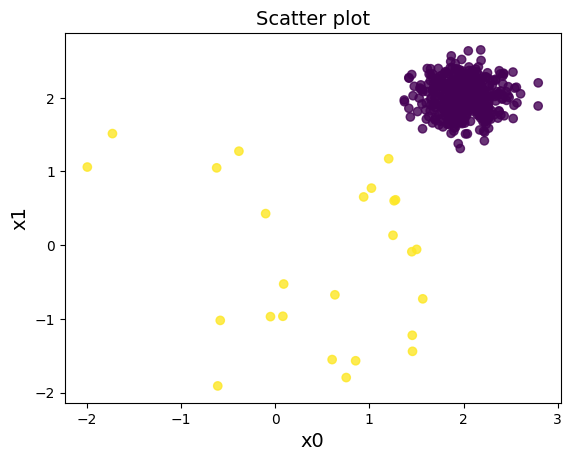

In [ ]:
plt.scatter(X_train_pd[0], X_train_pd[1],c=y_train, alpha=0.8)
plt.title('Scatter plot')
plt.xlabel('x0')
plt.ylabel('x1')
plt.show()

<font color='blue'>Declaramos y ajustamos el modelo. El tamaño de un árbol `max_samples`es de $40$ instancias. En Isolation Forest (IForest, https://pyod.readthedocs.io/en/latest/pyod.models.html#module-pyod.models.iforest), no es necesario asignar un tamaño de árbol grande, puesto que tamaños pequeños pueden producir mejores iTrees. El porcentaje de outliers será $5\%$ usando `contamination=0.05`. Si no se indica, este valor se fijará automáticamente en $10\%$.

<font color='blue'>La función `decision_function()` genera el _outlier score_ de cada ejemplo del conjunto de datos, y la función `predict()` assigna las etiquetas ($1$: outlier; $0$: no outlier) basándose en la tasa de contaminación proporcionada ($5\%$ en nuestro caso). El umbral que vemos más abajo (`threshold_`) se emplea para identificar los `n_samples*contamination` ejemplos más atípicos de acuerdo a su `decision_scores_`.

In [ ]:
from pyod.models.iforest import IForest
isft = IForest(contamination=0.05, max_samples=40, behaviour='new')
isft.fit(X_train)

# Training data
y_train_scores = isft.decision_function(X_train)
y_train_pred = isft.predict(X_train)

# Test data
y_test_scores = isft.decision_function(X_test)
y_test_pred = isft.predict(X_test) # outlier labels (0 or 1)

# Threshold for the defined comtanimation rate
print("The threshold for the defined contamination rate:" , isft.threshold_)

def count_stat(vector):
    # Because it is '0' and '1', we can run a count statistic.
    unique, counts = np.unique(vector, return_counts=True)
    return dict(zip(unique, counts))

print("The training data:", count_stat(y_train_pred))
print("The training data:", count_stat(y_test_pred))


The threshold for the defined contamination rate: -5.473919928444815e-15
The training data: {0: 475, 1: 25}
The training data: {0: 474, 1: 26}


<font color='blue'> Vemos que, efectivamente, este número de ejemplos más atípicos se corresponde con `X_train.shape[0]*0.05`.

In [ ]:
X_train.shape[0]*0.05

25.0

<font color='blue'> Vamos a intentar marcar con una cruz roja los $25$ ejemplos más atípicos en la figura.  

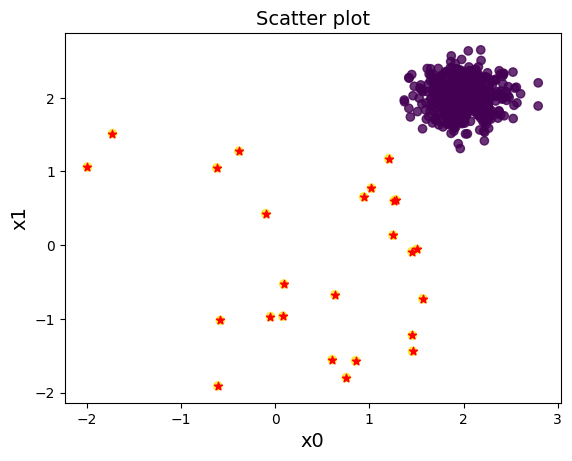

In [ ]:
plt.scatter(X_train_pd[0], X_train_pd[1],c=y_train, alpha=0.8)
indexes = np.squeeze(np.array(np.where(isft.threshold_ < isft.decision_scores_)))
plt.scatter(X_train[indexes,0], X_train[indexes,1],marker='*',color='r')
plt.title('Scatter plot')
plt.xlabel('x0')
plt.ylabel('x1')
plt.show()

##### <font color='blue'>Paso 1.1: Parámetros del Modelo

In [ ]:
isft.get_params()

{'behaviour': 'new',
 'bootstrap': False,
 'contamination': 0.05,
 'max_features': 1.0,
 'max_samples': 40,
 'n_estimators': 100,
 'n_jobs': 1,
 'random_state': None,
 'verbose': 0}

* <font color='blue'>`max_samples` es el número de muestras a escoger en $X$ para entrenar cada estimador base.
* <font color='blue'>`n_estimators` es el número de árboles en el ensemble. El valor por defecto es de 100 árboles.
* <font color='blue'>`max_features` es el número de características a escoger en $X$ para entrenar cada estimador base. El valor por defecto es $1.0$.
* <font color='blue'>`n_jobs` es el número de tareas a ejecutar en paralelo para `fit`y `predict`. El valor por defecto es $1.0$. Si se pone a $-1$, el número de tareas se iguala al número de cores.

##### <font color='blue'>Paso 1.2: Importancia de las Variables

<font color='blue'>Debido a que IForest trabaja dentro del marco de los árboles de decisión, podemos calcular y entender la importancia relativa de las características para determinar outliers. La importancia de las características se mide por el [índice de impureza Gini](https://en.wikipedia.org/wiki/Decision_tree_learning#Gini_impurity), cuya suma es $1.0$. A mayor valor, mayor importancia tiene la característica. En nuestro caso, la primera (índice $0$) y quinta (índice $4$) características serían las más relevantes.

In [ ]:
isft_vi = isft.feature_importances_
isft_vi

array([0.19469495, 0.1400648 , 0.18138793, 0.15058214, 0.18028749,
       0.15298268])

In [ ]:
np.sum(isft_vi)

1.0

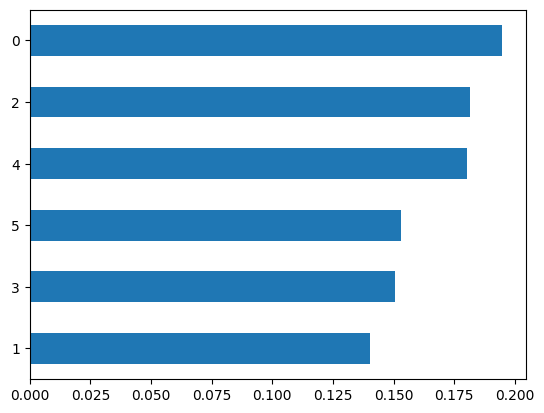

In [ ]:
from matplotlib import pyplot as plt
for_plot = pd.DataFrame({'x_axis':X_train_pd.columns, 'y_axis':isft_vi}).sort_values(by='y_axis',ascending=True)
for_plot['y_axis'].plot.barh();

####<font color='blue'> Paso 2: Determinar un Umbral Razonable

<font color='blue'>El umbral se puede determinar por el histograma de los _outlier scores_. La siguiente figura sugiere un umbral alrededor de $0.0$. Esto significa que los scores de la mayoría de los datos normales son menores que $0.0$. Los scores de outlier de los datos anormales están en un rango más alto.

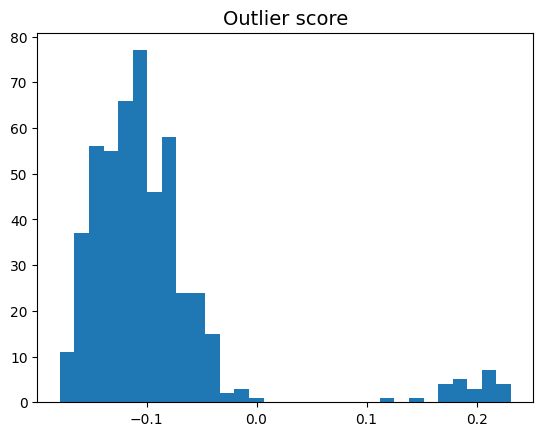

In [ ]:
import matplotlib.pyplot as plt
plt.hist(y_train_scores, bins='auto') # arguments are passed to np.histogram
plt.title("Outlier score")
plt.show()

#### <font color='blue'>Paso 3: análisis estadístico descriptivo

<font color='blue'>Realicemos un análisis descriptivo de los grupos normal y outlier tanto en entrenamiento como en test. En esta ocasión utilizamos directamente el threshold calculado por Isolation Forest, pero debemos ser conscientes de que podemos emplear el valor que consideremos más oportuno (en base al histograma anterior o a cualquier otra información de que dispongamos). Dicho umbral hará que cambien las tablas que se muestran a continuación. Por ejemplo, si hacemos `threshold = isft.threshold_ - 0.05` veremos que se incrementa el porcentaje de ejemplos considerados outliers (pasando del $5\%$ al $11.2\%$).

In [ ]:
threshold = isft.threshold_ # Or other value from the above histogram

def descriptive_stat_threshold(df,pred_score, threshold):
    # Let's see how many '0's and '1's.
    df = pd.DataFrame(df)
    df['Anomaly_Score'] = pred_score
    df['Group'] = np.where(df['Anomaly_Score']< threshold, 'Normal', 'Outlier')

    # Now let's show the summary statistics:
    cnt = df.groupby('Group')['Anomaly_Score'].count().reset_index().rename(columns={'Anomaly_Score':'Count'})
    cnt['Count %'] = (cnt['Count'] / cnt['Count'].sum()) * 100 # The count and count %
    stat = df.groupby('Group').mean().round(3).reset_index() # The avg.
    stat = cnt.merge(stat, left_on='Group',right_on='Group') # Put the count and the avg. together
    return (stat)

descriptive_stat_threshold(X_train,y_train_scores, threshold) #y_train_scores = isft.decision_scores_

,Group,Count,Count %,0,1,2,3,4,5,Anomaly_Score
0,Normal,475,95.0,2.003,2.011,2.006,1.991,2.008,1.985,-0.109
1,Outlier,25,5.0,0.454,-0.209,-0.475,-0.231,-0.035,-0.056,0.195


In [ ]:
descriptive_stat_threshold(X_test,y_test_scores, threshold)

,Group,Count,Count %,0,1,2,3,4,5,Anomaly_Score
0,Normal,474,94.8,2.018,2.013,2.009,1.989,2.005,2.001,-0.106
1,Outlier,26,5.2,0.056,-0.437,-0.125,0.014,0.044,0.194,0.186


In [ ]:
X_train[y_train==1,0].mean()

0.4535480626515198

<font color='blue'>Las tablas de arriba incluyen los elementos esenciales para la evaluación del modelo e interpretación de resultados.

* <font color='blue'>Tamaño del grupo de outlier (`Count %`) de las tablas. Muestra un $5\%$ en cada caso ($5.2\%$ en test). Es importante recordar que el tamaño del grupo de outliers viene determinado por el threshold, que a su vez se calcula en base a la contaminación proporcionada.
* <font color='blue'>La media del score de anomalía. En las tablas, la media del score del grupo de outlier es más grande que la del grupo normal, lo que confirma que el grupo  outlier debería tener y tiene mayores scores de anomalía.
* <font color='blue'>Estadísticas relativas a las variable de entrada agrupadas en normales (grupo $0$) y atípicas (grupo $1$). Por ejemplo, el valor asociado con la columna $0$ y fila $0$ (normal) se corresponde con `X_train[y_train==0,0].mean()`, es decir, $2.003$. La segunda fila (grupo $1$) de la misma columna sería `X_train[y_train==1,0].mean()`, es decir, $0.454$. Se puede observar que la media de las características en el grupo de outliers son más pequeñas que en el grupo de ejemplos normales. Si esto tiene sentido o no depende del problema en cuestión.


<font color='blue'>Debido a que tenemos el ground truth en nuestros datos, podemos generar una matriz de confusión para entender el rendimiento del modelo.

In [ ]:
def confusion_matrix_threshold(
    actual,score, threshold):
    Actual_pred = pd.DataFrame({'Actual': actual, 'Pred': score})
    Actual_pred['Pred'] = np.where(Actual_pred['Pred']<=threshold,0,1)
    cm = pd.crosstab(Actual_pred['Actual'],Actual_pred['Pred'])
    return (cm)

confusion_matrix_threshold(y_train,y_train_scores,threshold)

Pred,0,1
Actual,,
0.0,475,0
1.0,0,25


### <font color='blue'>Ejercicio.

<font color='blue'>Tras el ejemplo anterior, ahora presentamos el ejercicio a resolver por el alumnado en relación a la detección de anomalías con PyOD (https://pyod.readthedocs.io/en/latest/). En concreto, los estudiantes trabajarán con el conjunto de datos _Statlog_ (satélite Landsat) del repositorio de aprendizaje automático de la UCI (https://odds.cs.stonybrook.edu/satellite-dataset/). Se trata de un conjunto de datos de clasificación multiclase, en donde se combinan las tres clases más pequeñas para formar la clase de valores atípicos. En PRADO el alumnado dispone del fichero `satellite.mat` con los datos necesarios para realizar el ejercicio. A continuación se aporta una descripción general del dataset:
* <font color='blue'> $X$ = datos puntuales multidimensionales,
* <font color='blue'> $y$ = etiquetas ($1$ = valores atípicos, $0$ = valores atípicos).
* <font color='blue'> $6435$ instancias, $36$ características y $2036$ ($32\%$) anomalías. Este último número se puede recuperar haciendo `np.sum(Y==1)`.

<font color='blue'> Referencias:
* <font color='blue'>  Liu, Fei Tony, Kai Ming Ting, and Zhi-Hua Zhou. “Isolation forest.” 2008 Eighth IEEE International Conference on Data Mining. IEEE, 2008.
* <font color='blue'>  K. M. Ting, J. T. S. Chuan, and F. T. Liu. “Mass: A New Ranking Measure for Anomaly Detection.“, IEEE Transactions on Knowledge and Data Engineering, 2009.




## <font color='blue'> Objetivos
    
<font color='blue'> El objetivo del presente ejercicio es analizar los patrones subyacentes a los datos, sin tomar en cuenta su _ground truth_, y determinar si las anomalías que se detectan con algoritmos avanzados coinciden con la realidad. Se debe usar un algoritmo cualquiera de la librería PyOD (https://github.com/yzhao062/pyod), como podría ser Isolation Forest. Se valorará positivamente que el estudiante escoga un algoritmo diferente, en cuyo caso, se proporcionará una breve explicación de su funcionamiento.

<font color='blue'> Para llevar a cabo este objetivo principal se llevarán a cabo los siguientes objetivos secundarios:
1. <font color='blue'> Realización de un análisis exploratorio para una primera observación de las distribuciones de los datos.
2. Construcción y ajuste del modelo.
3. Experimentación y determinación de los umbrales más razonables para la identificación de anomalías.
4. Comprobación de errores usando la información Ground Truth del conjunto de datos.

### <font color='blue'> Resultados Esperados
<font color='blue'> Se espera que los resultados que se obtengan de la detección de anomalías sean razonablemente parecidos a la realidad.
    
<font color='blue'>Como el fichero es un `.mat` (matlab), lo primero que haremos será tranformarlo en `.csv` para trabajar con él. Nos quedamos solo con la parte no supervisada (es decir, con las entradas, sin las salidas deseadas / etiquetas).

In [ ]:
import scipy.io
import pandas as pd

from google.colab import drive
drive.mount("/content/drive/")

dataFolder = 'drive/MyDrive/Colab Notebooks/clustering/'

# Cargar el archivo .mat
mat = scipy.io.loadmat(dataFolder + '/satellite.mat')
print(mat.keys())

X = mat['X']
Y = mat['y']

# Convertir a un DataFrame de pandas ignorando las etiquetas
# IMPORTANTE: estamos ante un problema no supervisado. No podemos emplear las etiquetas para agrupar o analizar los datos.
df = pd.DataFrame(X)



Drive already mounted at /content/drive/; to attempt to forcibly remount, call drive.mount("/content/drive/", force_remount=True).
dict_keys(['__header__', '__version__', '__globals__', 'X', 'y'])


In [ ]:
df

,0,1,2,3,4,5,6,7,8,9,...,26,27,28,29,30,31,32,33,34,35
0,92,115,120,94,84,102,106,79,84,102,...,134,104,88,121,128,100,84,107,113,87
1,84,102,106,79,84,102,102,83,80,102,...,128,100,84,107,113,87,84,99,104,79
2,84,102,102,83,80,102,102,79,84,94,...,113,87,84,99,104,79,84,99,104,79
3,80,102,102,79,84,94,102,79,80,94,...,104,79,84,99,104,79,84,103,104,79
4,84,94,102,79,80,94,98,76,80,102,...,104,79,84,103,104,79,79,107,109,87
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
6430,60,83,96,85,64,87,100,88,64,83,...,104,92,66,87,108,89,63,83,104,85
6431,64,79,100,85,56,71,96,85,56,68,...,100,85,66,83,100,85,63,83,100,81
6432,56,68,91,81,56,64,91,81,53,64,...,100,81,59,87,96,81,63,83,92,74
6433,56,68,87,74,60,71,91,81,60,64,...,96,74,59,83,92,74,59,83,92,70


In [ ]:
np.sum(Y==1)

2036

####Realización de un análisis exploratorio para una primera observación de las distribuciones de los datos.


Exploraremos nuestros datos mediante tres pasos clave: primero, visualizaremos las primeras filas para tener una idea general de los datos; segundo, generaremos estadísticas descriptivas básicas para entender la distribución y las propiedades estadísticas de cada característica; y tercero, crearemos gráficos para visualizar la distribución de cada característica de manera más detallada.

   0    1    2   3   4    5    6   7   8    9   ...   26   27  28   29   30  \
0  92  115  120  94  84  102  106  79  84  102  ...  134  104  88  121  128   
1  84  102  106  79  84  102  102  83  80  102  ...  128  100  84  107  113   
2  84  102  102  83  80  102  102  79  84   94  ...  113   87  84   99  104   
3  80  102  102  79  84   94  102  79  80   94  ...  104   79  84   99  104   
4  84   94  102  79  80   94   98  76  80  102  ...  104   79  84  103  104   

    31  32   33   34  35  
0  100  84  107  113  87  
1   87  84   99  104  79  
2   79  84   99  104  79  
3   79  84  103  104  79  
4   79  79  107  109  87  

[5 rows x 36 columns]
                0            1            2            3            4   \
count  6435.000000  6435.000000  6435.000000  6435.000000  6435.000000   
mean     69.400000    83.594872    99.290598    82.592696    69.150272   
std      13.605871    22.882234    16.645944    18.897674    13.561197   
min      39.000000    27.000000    53.000000

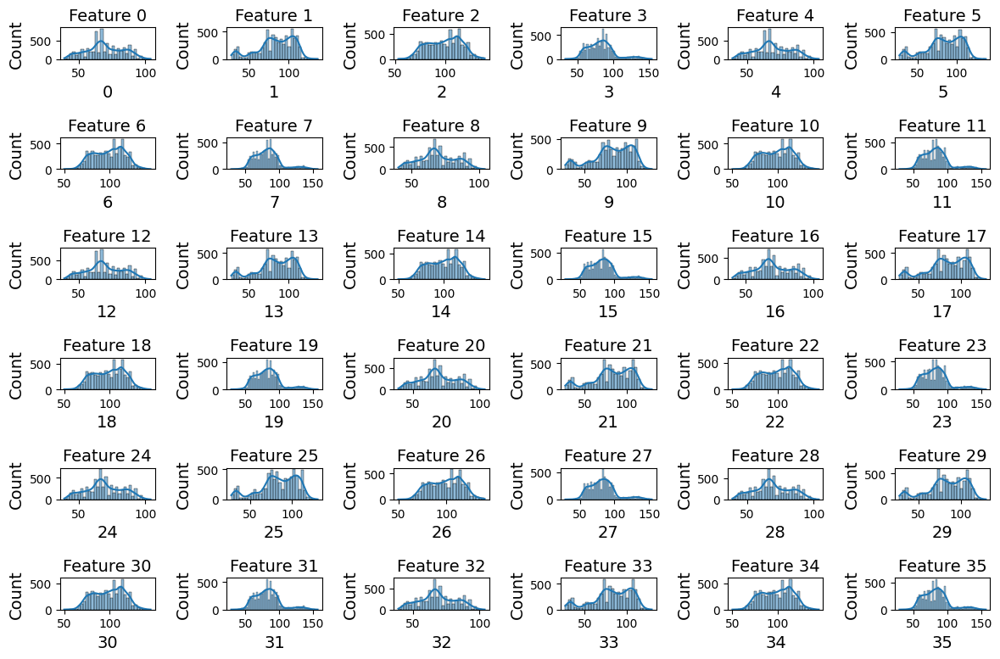

In [ ]:
# Mostrar las primeras filas del DataFrame
print(df.head())

# Obtener estadísticas descriptivas básicas
print(df.describe())

# Visualizar la distribución de cada característica
import matplotlib.pyplot as plt
import seaborn as sns

plt.figure(figsize=(12, 8))
for i in range(len(df.columns)):
    plt.subplot(6, 6, i+1)
    sns.histplot(df.iloc[:, i], kde=True)
    plt.title(f'Feature {i}')
plt.tight_layout()
plt.show()


####Reducción PCA en dos componentes principales.

Con el objetivo de hacer una visualización inicial de los datos y distinguir posibles outliers, descompondremos los datos en 2 componentes principales.

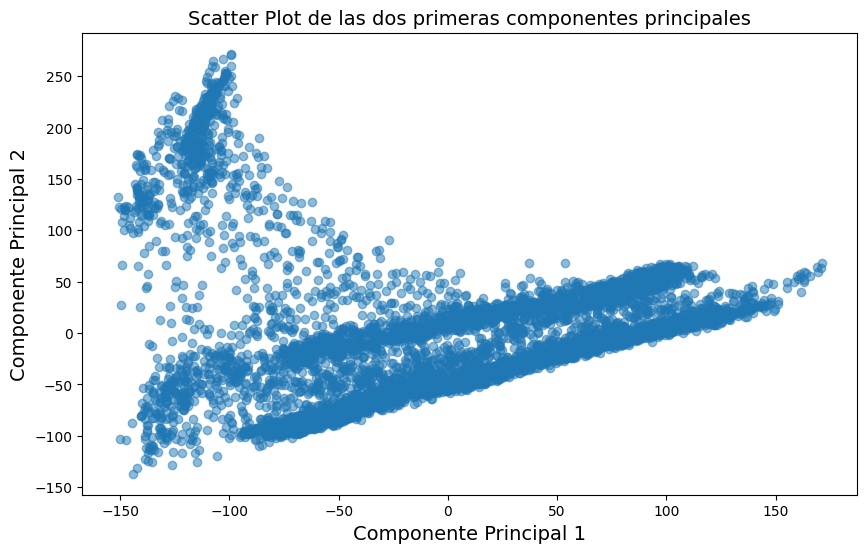

In [ ]:
from sklearn.decomposition import PCA

# Reducir la dimensionalidad de los datos utilizando PCA
pca = PCA(n_components=2)
df_pca = pca.fit_transform(df)

# Crear scatter plot de las dos componentes principales
plt.figure(figsize=(10, 6))
plt.scatter(df_pca[:, 0], df_pca[:, 1], alpha=0.5)
plt.title('Scatter Plot de las dos primeras componentes principales')
plt.xlabel('Componente Principal 1')
plt.ylabel('Componente Principal 2')
plt.show()


####Construcción y ajuste del modelo.

####Subspace Outlier Detection (SOD)

Subspace Outlier Detection (SOD) es un algoritmo de detección de anomalías diseñado para identificar outliers en datos de alta dimensión, centrándose en subespacios de características relevantes en lugar de analizar todas las dimensiones simultáneamente.

En nuestro caso, utilizamos SOD para detectar anomalías en nuestro conjunto de datos debido a su capacidad para manejar la alta dimensionalidad de manera eficiente. Después de preprocesar los datos, entrenamos el modelo utilizando instancias normales, aquellas que no se consideran anomalías. Una vez entrenado, el modelo SOD puede predecir anomalías en nuevos datos.

La idea detrás de SOD es identificar subespacios locales de dimensiones donde las diferencias entre puntos normales y outliers son más pronunciadas. El algoritmo primero selecciona un subconjunto de las dimensiones más relevantes para cada punto de datos y luego calcula la densidad local en ese subespacio. Los puntos con densidades significativamente más bajas en sus respectivos subespacios se consideran outliers.

En resumen, Subspace Outlier Detection (SOD) es una opción prometedora para la detección de anomalías en conjuntos de datos de alta dimensionalidad, ya que permite identificar outliers en subespacios locales relevantes, ofreciendo una solución eficiente y efectiva frente a la complejidad de analizar todas las dimensiones simultáneamente.

####Experimentación y determinación de los umbrales más razonables para la identificación de anomalías.

En esta sección, utilizaremos el algoritmo Subspace Outlier Detection (SOD) para detectar anomalías en nuestro conjunto de datos. Normalizaremos los datos, entrenaremos el modelo SOD, y evaluaremos su rendimiento a través de diferentes umbrales. Finalmente, visualizaremos las métricas de rendimiento y los resultados de la detección de anomalías.

Umbral Precisión FPR FNR
0.000 0.316 1.000 0.000
0.010 0.316 1.000 0.000
0.020 0.316 1.000 0.000
0.030 0.316 1.000 0.000
0.040 0.316 1.000 0.000
0.050 0.316 1.000 0.001
0.060 0.316 0.998 0.003
0.070 0.316 0.993 0.007
0.080 0.317 0.981 0.017
0.090 0.318 0.957 0.034
0.100 0.320 0.909 0.077
0.110 0.327 0.828 0.132
0.120 0.334 0.733 0.205
0.130 0.349 0.633 0.267
0.140 0.362 0.535 0.345
0.150 0.375 0.449 0.417
0.160 0.393 0.371 0.481
0.170 0.413 0.304 0.538
0.180 0.432 0.241 0.604
0.190 0.458 0.189 0.654
0.200 0.473 0.156 0.697
0.210 0.503 0.125 0.727
0.220 0.515 0.105 0.760
0.230 0.530 0.087 0.789
0.240 0.540 0.074 0.813
0.250 0.563 0.060 0.833
0.260 0.577 0.051 0.851
0.270 0.575 0.044 0.872
0.280 0.576 0.038 0.888
0.290 0.582 0.032 0.903
0.300 0.591 0.027 0.916
0.310 0.606 0.022 0.927
0.320 0.595 0.019 0.940
0.330 0.618 0.015 0.946
0.340 0.634 0.013 0.950
0.350 0.667 0.010 0.956
0.360 0.692 0.008 0.960
0.370 0.673 0.008 0.967
0.380 0.667 0.007 0.971
0.390 0.724 0.005 0.973
0.400 0.726 0.0

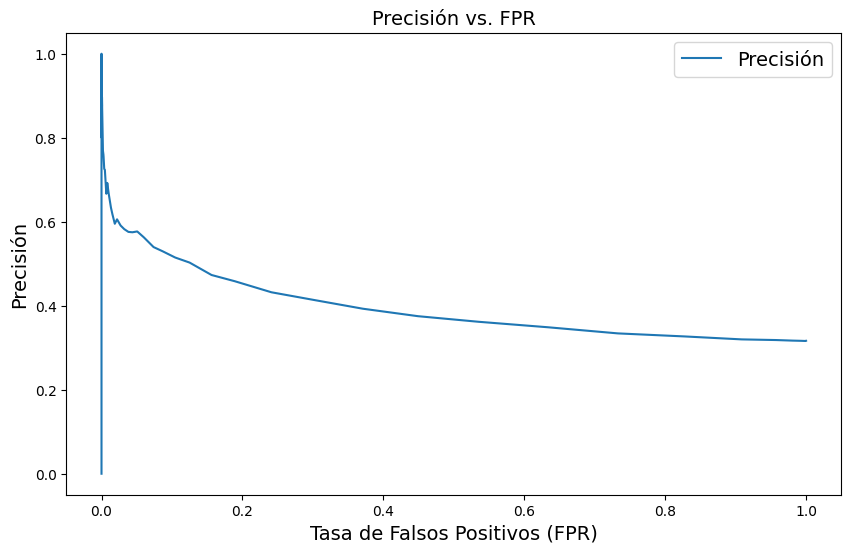

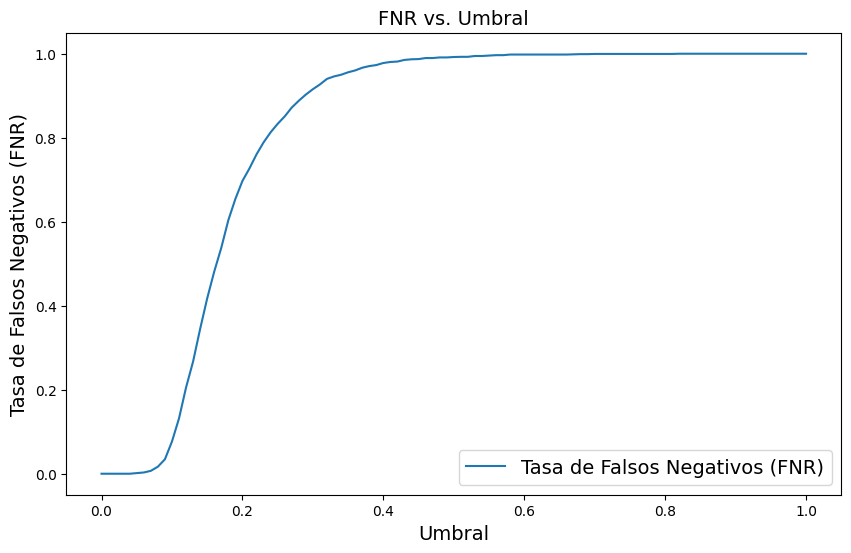

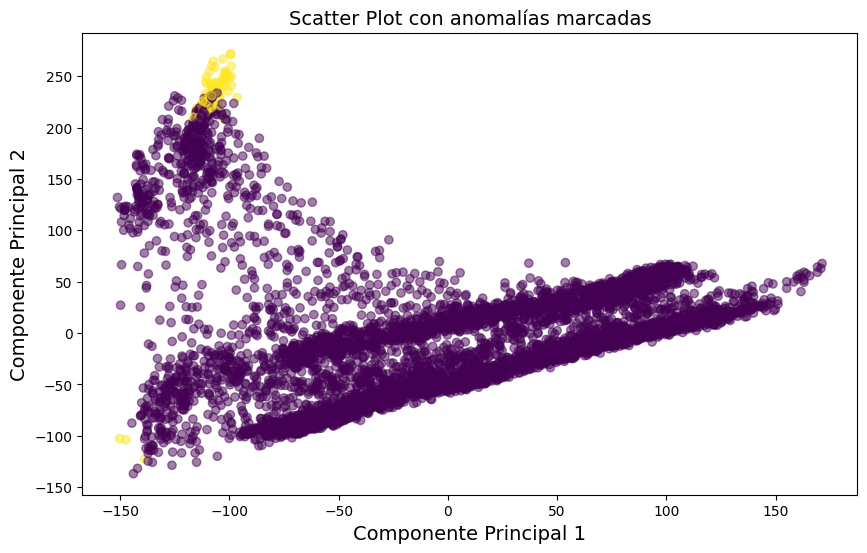

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from pyod.models.sod import SOD
from sklearn.preprocessing import StandardScaler

# Normalizar los datos
scaler = StandardScaler()
df_normalized = scaler.fit_transform(df)

# Crear y ajustar el modelo SOD
clf = SOD()
clf.fit(df_normalized)

# Calcular los puntajes de anomalía
anomaly_scores = clf.decision_function(df_normalized)

# Definir un rango de umbrales para evaluar
thresholds = np.arange(0.0, 1.01, 0.01)

# Inicializar listas vacías para almacenar métricas
precisions = []
fprs = []
fnrs = []

# Iterar a través de diferentes umbrales para evaluar el rendimiento del modelo
for threshold in thresholds:
    # Determinar anomalías según el umbral actual
    anomalies_threshold = (anomaly_scores > threshold).astype(int)

    # Calcular verdaderos positivos, falsos positivos, falsos negativos, verdaderos negativos
    tp = np.sum((anomalies_threshold == 1) & (Y.flatten() == 1))
    fp = np.sum((anomalies_threshold == 1) & (Y.flatten() == 0))
    fn = np.sum((anomalies_threshold == 0) & (Y.flatten() == 1))
    tn = np.sum((anomalies_threshold == 0) & (Y.flatten() == 0))

    # Calcular las métricas de rendimiento
    precision = tp / (tp + fp) if (tp + fp) > 0 else 0
    fpr = fp / (fp + tn) if (fp + tn) > 0 else 0
    fnr = fn / (fn + tp) if (fn + tp) > 0 else 0

    # Almacenar las métricas para análisis posterior
    precisions.append(precision)
    fprs.append(fpr)
    fnrs.append(fnr)

# Analizar e imprimir los resultados
print("Umbral", "Precisión", "FPR", "FNR")
for i, threshold in enumerate(thresholds):
    print(f"{threshold:.3f}", f"{precisions[i]:.3f}", f"{fprs[i]:.3f}", f"{fnrs[i]:.3f}")

# Graficar precision vs FPR
plt.figure(figsize=(10, 6))
plt.plot(fprs, precisions, label='Precisión')
plt.xlabel('Tasa de Falsos Positivos (FPR)')
plt.ylabel('Precisión')
plt.title('Precisión vs. FPR')
plt.legend()
plt.show()

# Graficar FNR vs umbral
plt.figure(figsize=(10, 6))
plt.plot(thresholds, fnrs, label='Tasa de Falsos Negativos (FNR)')
plt.xlabel('Umbral')
plt.ylabel('Tasa de Falsos Negativos (FNR)')
plt.title('FNR vs. Umbral')
plt.legend()
plt.show()

plt.figure(figsize=(10, 6))
plt.scatter(df_pca[:, 0], df_pca[:, 1], alpha=0.5, c=anomaly_labels)
plt.title('Scatter Plot con anomalías marcadas')
plt.xlabel('Componente Principal 1')
plt.ylabel('Componente Principal 2')
plt.show()


Análisis de Resultados

- Precisión (Precision): La precisión mide la proporción de verdaderos positivos sobre el total de positivos predichos. Comienza en 0.316 con un umbral de 0.0 y aumenta progresivamente a medida que incrementamos el umbral. Alcanzamos una precisión máxima de 1.000 a partir de un umbral de 0.620 hasta 0.800. Este comportamiento sugiere que, con umbrales más altos, el modelo está identificando menos puntos como anomalías, pero aquellos que se identifican son casi todos verdaderos positivos.

- Tasa de Falsos Positivos (FPR): La tasa de falsos positivos mide la proporción de no-anomalías que se clasifican incorrectamente como anomalías. Esta métrica comienza en 1.000 y disminuye rápidamente a medida que aumenta el umbral. A partir de un umbral de 0.480, la FPR es prácticamente cero, indicando que el modelo es muy conservador y rara vez clasifica incorrectamente puntos normales como anomalías en estos umbrales.

- Tasa de Falsos Negativos (FNR): La tasa de falsos negativos mide la proporción de anomalías que no se detectan. Al inicio, con umbrales bajos, la FNR es muy baja, lo que significa que se detectan casi todas las anomalías. Sin embargo, a medida que el umbral aumenta, la FNR sube rápidamente, indicando que más anomalías no se están detectando. A partir de un umbral de 0.620, la FNR se mantiene constante en 0.998, sugiriendo que el modelo prácticamente no detecta ninguna anomalía en estos altos umbrales.

- Conclusión
El análisis de los resultados muestra que existe un equilibrio delicado entre precisión, FPR y FNR. A umbrales bajos, el modelo tiene una alta tasa de detección de anomalías (baja FNR) pero también una alta tasa de falsos positivos (alta FPR), resultando en una precisión moderada. A umbrales más altos, la precisión aumenta considerablemente mientras que la FPR disminuye, pero esto a costa de aumentar la FNR.

  Para una detección efectiva de anomalías, es crucial seleccionar un umbral que ofrezca un balance adecuado entre estas métricas según las necesidades específicas de la aplicación. Si el objetivo es minimizar los falsos negativos, un umbral más bajo sería adecuado. En cambio, si se busca maximizar la precisión y reducir los falsos positivos, un umbral más alto sería preferible.

  En este caso, un umbral en el rango de 0.380 a 0.480 parece ofrecer un buen equilibrio, con precisiones elevadas y tasas de falsos positivos muy bajas, mientras que aún mantiene la FNR dentro de límites aceptables para muchas aplicaciones prácticas. La elección final del umbral dependerá de la tolerancia a falsos positivos y falsos negativos que se determine apropiada para la tarea específica de detección de anomalías en los cantos de anuros.